<a href="https://colab.research.google.com/github/arpanbiswas52/SANE/blob/main/Analysis/SANE_Sm_BFO(Notebook).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Strategic (S) Autonomous (A) Noisy (N) Experiments (E)**
Aug, 2024

Tutorial for Stategic BO where the idea is to also exploit the local optimal solution rather than only focus of BO to identify the global optimal solution

In real time, experts also want to learn the material structure-property relationship at the local region of interest and want to spend some time exploring those spaces. However, the classical BO is a global optimization tool where it only focus on exploiting to converge to optimal region globally and avoid local optima. Here, we aim to define BO with strategic exploration to indentify a potential optimal region and exploit sufficiently to extract physical knowledge and the move to identify the next optimal region. This approach is well suited when we have mutiple local and global region of interest and the domain expert want to learn all the region, but with limited experiments.

In this notebook, SANE is integrated with <i> partial human-intervened dynamic constraint </i> and implemented on a <b> combinatorial library ferroelectric Sm-doped BiFeO3 (Sm-BFO) dataset </b>

-- Notebook prepared by **Arpan Biswas**

## Install & Import

Install GPax package:

In [ ]:
!pip install -q gpax

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.4/103.4 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.7/371.7 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 348.1/348.1 kB 17.7 MB/s eta 0:00:00


In [ ]:
!pip install sidpy
!pip install pyNSID
!pip install mycolorpy

  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.4/102.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 38.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 53.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 516.3/516.3 kB 26.1 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Preparing metadata (setup.py) ... done
  Created wheel for mycolorpy: filename=mycolorpy-1.5.1-py3-none-any.whl size=3850 sha256=db80c405221e721cab0b477ed7e4ab0bfbe4a8813d572a622bfcb88c017368bd
  Stored in directory: /root/.cache/pip/wheels/d6/1d/04/f8bfb8b04e3daba330b3f377c041b89304271ff98fb6704946
Successfully built mycolorpy


Import needed packages:

In [ ]:
import gpax
import numpy as np
import matplotlib.pyplot as plt
import scipy
import os
import h5py
import sidpy
import pyNSID
from mycolorpy import colorlist as mcp

gpax.utils.enable_x64()  # enable double precision

## Load SmBFO data

In [ ]:
!gdown https://drive.google.com/uc?id=1rKE6d4T-JHlNOT0K4HExOM83PTHPdy-2
!gdown https://drive.google.com/uc?id=1C1UUH_ZEfDxrGtZgqumfyprNu7HGTjab

Downloading...
From (original): https://drive.google.com/uc?id=1rKE6d4T-JHlNOT0K4HExOM83PTHPdy-2
From (redirected): https://drive.google.com/uc?id=1rKE6d4T-JHlNOT0K4HExOM83PTHPdy-2&confirm=t&uuid=92b39e84-f974-4044-b295-53850b635605
To: /content/90nm.zip
100% 220M/220M [00:03<00:00, 60.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1C1UUH_ZEfDxrGtZgqumfyprNu7HGTjab
To: /content/SmBFO_NanoSurf.npz
100% 5.57k/5.57k [00:00<00:00, 19.5MB/s]


In [ ]:
!unzip /content/90nm.zip

Archive:  /content/90nm.zip
  inflating: 90nm/BEPS_composition0_loop0_0.hf5  
  inflating: 90nm/BEPS_composition0_loop1_0.hf5  
  inflating: 90nm/BEPS_composition0_loop2_0.hf5  
  inflating: 90nm/BEPS_composition1_loop0_0.hf5  
  inflating: 90nm/BEPS_composition1_loop1_0.hf5  
  inflating: 90nm/BEPS_composition1_loop2_0.hf5  
  inflating: 90nm/BEPS_composition10_loop0_0.hf5  
  inflating: 90nm/BEPS_composition10_loop1_0.hf5  
  inflating: 90nm/BEPS_composition10_loop2_0.hf5  
  inflating: 90nm/BEPS_composition11_loop0_0.hf5  
  inflating: 90nm/BEPS_composition11_loop1_0.hf5  
  inflating: 90nm/BEPS_composition11_loop2_0.hf5  
  inflating: 90nm/BEPS_composition12_loop0_0.hf5  
  inflating: 90nm/BEPS_composition12_loop1_0.hf5  
  inflating: 90nm/BEPS_composition12_loop2_0.hf5  
  inflating: 90nm/BEPS_composition13_loop0_0.hf5  
  inflating: 90nm/BEPS_composition13_loop1_0.hf5  
  inflating: 90nm/BEPS_composition13_loop2_0.hf5  
  inflating: 90nm/BEPS_composition14_loop0_0.hf5  
  inflati

In [ ]:
hf = h5py.File(r'/content/90nm/BEPS_composition70_loop0_0.hf5', 'r+')
sidpy.hdf.hdf_utils.print_tree(hf)

/
├ BE Channels
  -----------
  ├ Channels
    --------
    ├ Channels
    ├ channels images
    ├ x axis
    ├ y axis
├ BE Complex Spectra
  ------------------
  ├ Complex Spectra
    ---------------
    ├ Complex Spectra
    ├ c
    ├ location index x
    ├ location index y
├ BE Parameters
  -------------
  ├ frequency
  ├ pulse parameters
  ├ scan size
├ BE Quick Fitting
  ----------------
  ├ Quick Fitting
    -------------
    ├ BE responses
    ├ Quick Fitting
    ├ x axis
    ├ y axis
├ BEPS
  ----
  ├ coordinates
  ├ vdc_waveform


In [ ]:
# Load all 94*3 loops
all_loops = []

for comp in range (94):
  com_loops = []
  for loopnum in range (3):
    hf = h5py.File(r'/content/90nm/BEPS_composition{}_loop{}_0.hf5'.format(comp, loopnum), 'r+')
    beps_qf = hf["BE Quick Fitting/Quick Fitting/Quick Fitting"]
    beps_wv = np.asarray(hf["BEPS/vdc_waveform"])

    com_loops.append(beps_qf)
  all_loops.append(com_loops)

all_loops = np.asarray(all_loops)
all_loops.shape

(94, 3, 1, 4, 640)

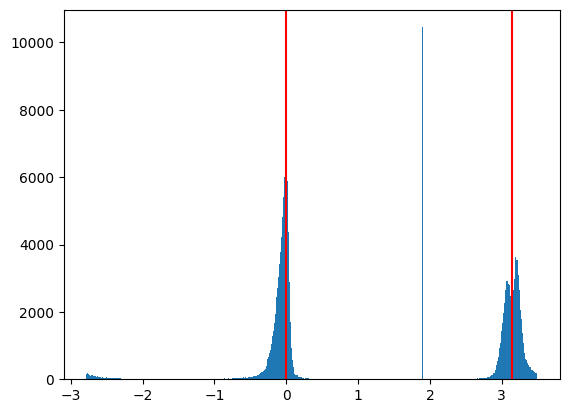

In [ ]:
# correct phase
pha = all_loops[:,:,0,3,:]
mi = np.min(pha)
ma = np.max(pha)

correct_pha = np.where(pha > 1.6, pha + (mi-ma), pha)

correct_pha = correct_pha + np.pi - 1.25

# plot corrected phase
plt.figure()
plt.hist(correct_pha.reshape(-1),bins = 500);
plt.axvline(np.pi, c = 'r')
plt.axvline(0, c = 'r')

In [ ]:
 # Load corrected phase
 all_loops[:,:,0, 3,:] = correct_pha
 all_loops.shape

(94, 3, 1, 4, 640)

In [ ]:
# Separate on field and off field loops
loops_on = np.zeros((94, 3, 4, len(beps_wv)))
loops_off = np.zeros((94, 3, 4, len(beps_wv)))

for k in range (len(beps_wv)):
  loops_on[:,:, :, k] = all_loops[:,:,0, :, 2*k]
  loops_off[:,:, :, k] = all_loops[:,:, 0, :, 1+2*k]

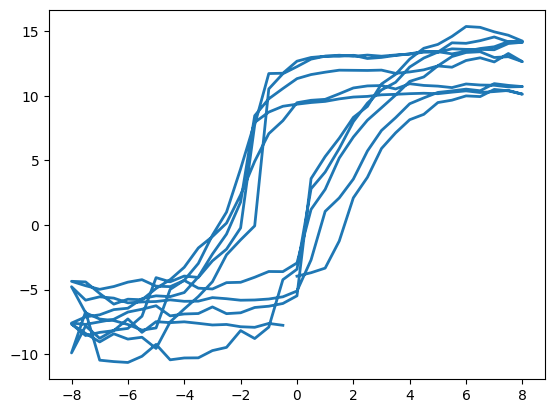

In [ ]:
# Plot Polarization
pola_off = loops_off[:,:,0,]*np.cos(loops_off[:,:,3,])
plt.plot(beps_wv, (pola_off.mean(axis = 1)[65])*1E5, linewidth = 2)
plt.show()


In [ ]:
# Data for loop area, nucleation and coercive voltage from spectral
smbfo = np.load("SmBFO_NanoSurf.npz")
print(smbfo.files)

x_composition = smbfo['composition']
y_nucleation = smbfo['nucleation_voltages']
y_coercive = smbfo['coercive_voltages']
y_looparea = smbfo['loop_area']

['composition', 'nucleation_voltages', 'coercive_voltages', 'loop_area']


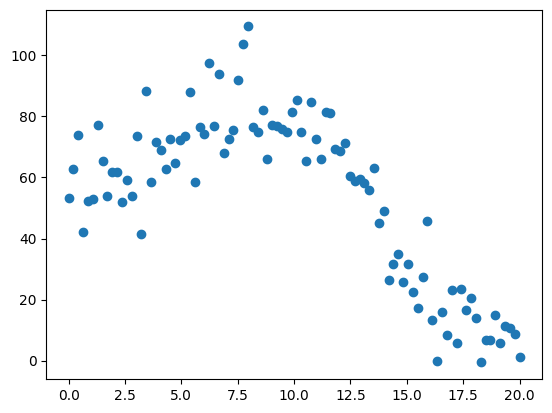

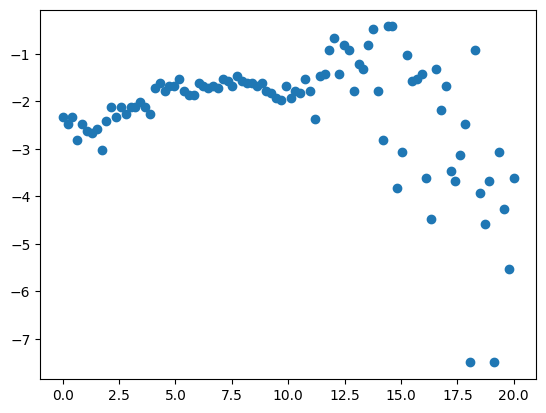

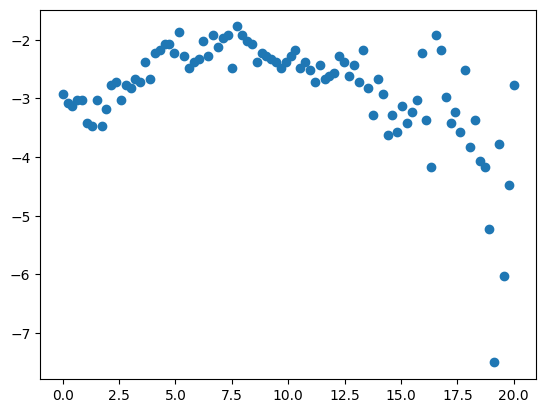

In [ ]:
plt.scatter(x_composition, y_looparea, label='Loop Area')
plt.show()
plt.scatter(x_composition, y_nucleation[0], label='Nucleation Voltage')
plt.show()
plt.scatter(x_composition, y_coercive[0], label='Coercive Voltage')
plt.show()

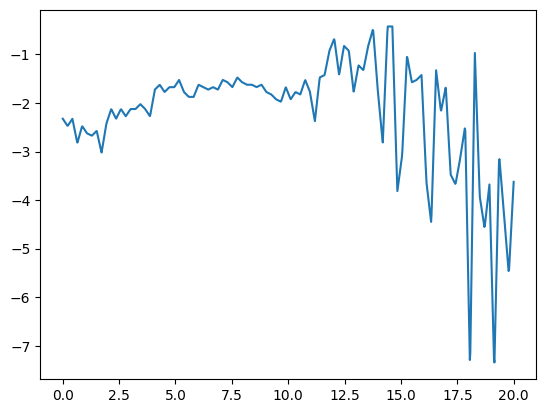

In [ ]:
import cv2

y = y_nucleation[0]
y = cv2.resize (y, (1, 1000))
x = cv2.resize (x_composition, (1, 1000))
plt.plot(x, y)

#  Functions for GP and BO

In [ ]:
import jax.numpy as jnp
# Help function for initilizing training
def init_training_data_exp(X, Y, num_seed_points=2, rng_seed=42, list_of_indices=None):
    np.random.seed(rng_seed)
    indices = jnp.arange(len(X))
    idx = list_of_indices
    if idx is not None:
        idx = np.array(idx)
    else:
        #idx = np.random.randint(0, len(X), num_seed_points)
        sampler = scipy.stats.qmc.LatinHypercube(d=1, scramble=True, seed=rng_seed)
        idx = 0 + (len(X) - 0) * sampler.random(n=num_seed_points)
        idx = np.round(idx)
        idx = idx.astype(int)
        idx = idx[:, 0]
    idx = np.unique(idx)
    X_train, y_train = X[idx], Y[idx]
    indices_train = indices[idx]
    X_test = jnp.delete(X, idx)
    y_test = jnp.delete(Y, idx, 0)
    indices_test = jnp.delete(indices, idx)
    return X_train, y_train, X_test, y_test, indices_train, indices_test

# Help function for updating train/test data
def update_data(next_point_idx, X_train, X_test, y_train, y_test, indices_train, indices_test):
    X_train = jnp.append(X_train, X_test[next_point_idx][None], 0)
    X_test = jnp.delete(X_test, next_point_idx, 0)
    y_train = jnp.append(y_train, y_test[next_point_idx][None], 0)
    y_test = jnp.delete(y_test, next_point_idx, 0)
    indices_train = jnp.append(indices_train, indices_test[next_point_idx])
    indices_test = jnp.delete(indices_test, next_point_idx)
    return X_train, X_test, y_train, y_test, indices_train, indices_test

In [ ]:
# Function for performing a GP step, here we use structure GP (sGP)
def run_GP (xtrain, ytrain, xtest, fn = None, fn_priors = None):
  rng_key, rng_key_predict = gpax.utils.get_keys()
  # Obtain/update GP posterior
  gp_model = gpax.ExactGP(1, kernel='Matern', mean_fn=fn, mean_fn_prior=fn_priors)
  gp_model.fit(rng_key, xtrain, ytrain, num_warmup=500, num_samples=500, num_chains=1)
  # Compute acquisition function
  #obj = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test)
  standard_acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=False, noiseless=False)
  standard_acq = np.array(standard_acq)
  # Check for stability
  standard_acq[np.isnan(standard_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=standard_acq[np.isnan(standard_acq)==True].shape)*1e-3

  # Get GP prediction
  posterior_mean, f_samples = gp_model.predict(rng_key_predict, xtest)

  return gp_model, standard_acq, posterior_mean, f_samples

### Initialize training data

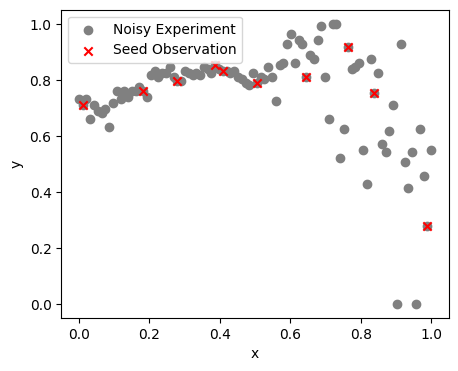

In [ ]:
# Select random initial points
init_points = 10 # number of initial points

def norm_(data):
  return (data - np.min(data)) / (np.max(data) - np.min(data))

# Select Experiment Data
X = norm_(np.asarray(x_composition))
y = norm_(np.asarray(y_nucleation[0]))

# Full dataset
#X = jnp.asarray(X)
#y = jnp.asarray(y)
#X = norm_(X)
#y = norm_(y)

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, y, num_seed_points=init_points, rng_seed=10)

# Plot initial train dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, y, label = "Noisy Experiment", color = "Gray")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

### Start BO exploration


Exploration step 1


sample: 100%|██████████| 1000/1000 [00:06<00:00, 165.05it/s, 7 steps of size 6.13e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.29      2.37      1.60      0.35      4.50    272.02      1.01
    k_scale      0.92      0.92      0.67      0.06      1.82    366.18      1.02
      noise      0.09      0.06      0.07      0.01      0.16    347.84      1.00



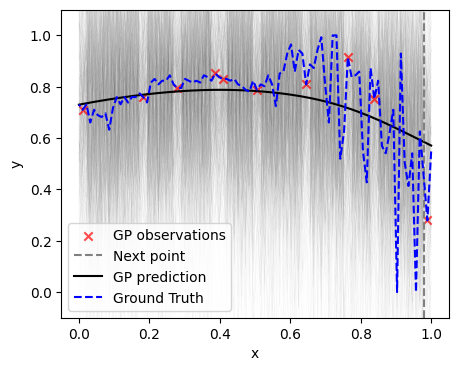


Exploration step 2


sample: 100%|██████████| 1000/1000 [00:05<00:00, 169.42it/s, 7 steps of size 6.65e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.49      3.93      1.51      0.19      4.75    150.22      1.00
    k_scale      1.00      1.10      0.66      0.06      2.08    321.01      1.00
      noise      0.07      0.06      0.06      0.01      0.15    289.01      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


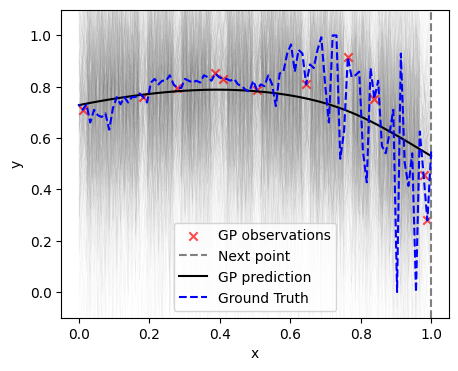


Exploration step 3


sample: 100%|██████████| 1000/1000 [00:06<00:00, 163.79it/s, 7 steps of size 6.40e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.98      1.69      1.44      0.26      3.95    272.21      1.00
    k_scale      0.98      1.05      0.67      0.10      1.95    341.28      1.00
      noise      0.06      0.04      0.05      0.01      0.11    256.86      1.00



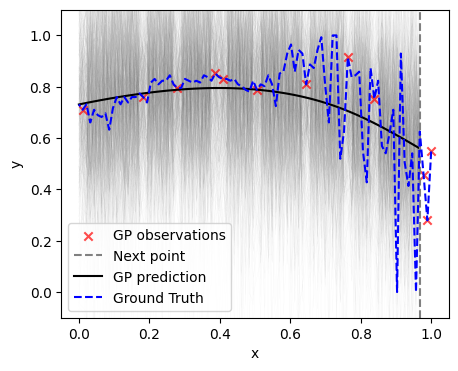


Exploration step 4


sample: 100%|██████████| 1000/1000 [00:06<00:00, 163.45it/s, 7 steps of size 6.90e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.91      1.61      1.43      0.32      3.40    306.71      1.00
    k_scale      0.99      1.06      0.66      0.10      2.07    244.85      1.00
      noise      0.05      0.04      0.04      0.01      0.10    286.74      1.00



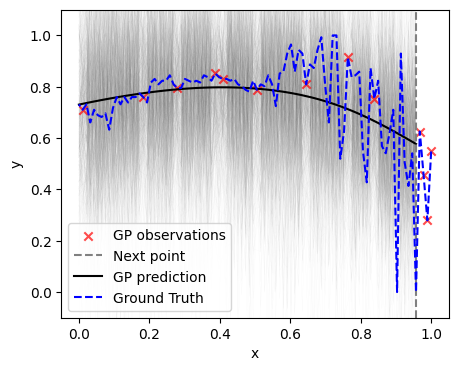


Exploration step 5


sample: 100%|██████████| 1000/1000 [00:06<00:00, 164.20it/s, 7 steps of size 6.44e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.12      3.23      1.43      0.38      3.70    147.26      1.00
    k_scale      1.03      1.02      0.71      0.06      2.15    329.36      1.01
      noise      0.09      0.05      0.08      0.03      0.16    270.92      1.00



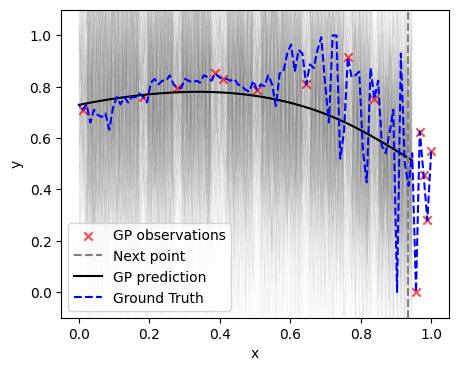


Exploration step 6


sample: 100%|██████████| 1000/1000 [00:05<00:00, 168.15it/s, 7 steps of size 7.46e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.63      1.28      1.28      0.30      2.85    288.74      1.00
    k_scale      1.02      1.04      0.74      0.07      2.00    287.60      1.02
      noise      0.08      0.04      0.07      0.02      0.14    252.52      1.00



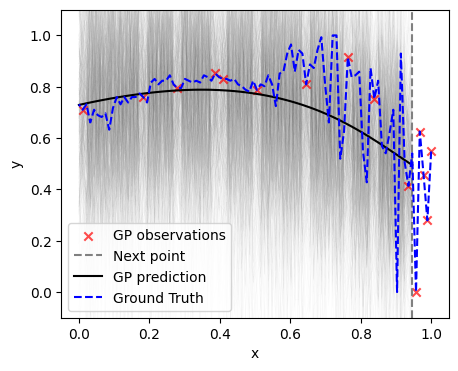


Exploration step 7


sample: 100%|██████████| 1000/1000 [00:06<00:00, 162.12it/s, 7 steps of size 6.49e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.70      1.59      1.25      0.28      3.14    258.06      1.00
    k_scale      0.99      0.95      0.70      0.12      1.98    309.58      1.00
      noise      0.07      0.03      0.06      0.02      0.11    375.81      1.00



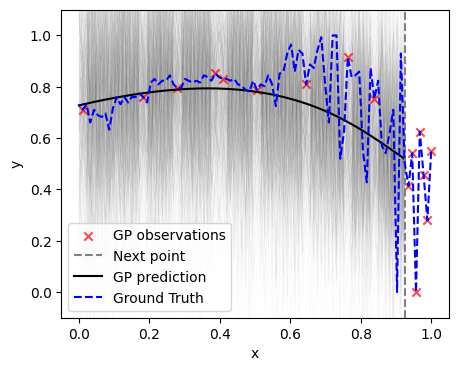


Exploration step 8


sample: 100%|██████████| 1000/1000 [00:06<00:00, 153.05it/s, 7 steps of size 6.54e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.81      2.95      1.27      0.36      2.78    148.92      1.00
    k_scale      1.00      1.11      0.69      0.09      1.97    353.68      1.00
      noise      0.06      0.03      0.05      0.02      0.10    328.85      1.00



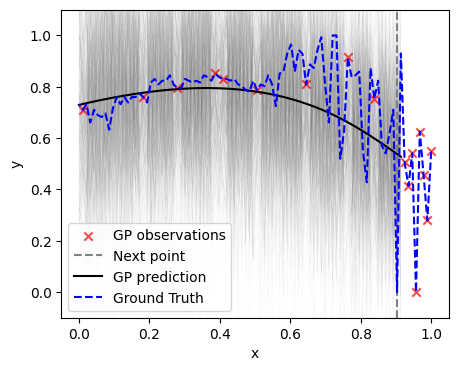


Exploration step 9


sample: 100%|██████████| 1000/1000 [00:06<00:00, 157.27it/s, 3 steps of size 7.27e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.68      1.37      1.32      0.31      2.95    351.08      1.00
    k_scale      1.01      0.93      0.73      0.06      2.17    328.30      1.01
      noise      0.08      0.04      0.08      0.03      0.13    337.90      1.00



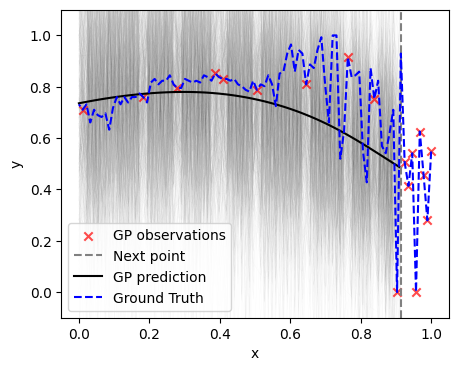


Exploration step 10


sample: 100%|██████████| 1000/1000 [00:06<00:00, 153.93it/s, 7 steps of size 7.16e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.78      1.60      1.39      0.37      3.17    425.43      1.00
    k_scale      1.00      0.99      0.68      0.14      2.16    326.17      1.00
      noise      0.09      0.04      0.09      0.04      0.15    257.86      1.00



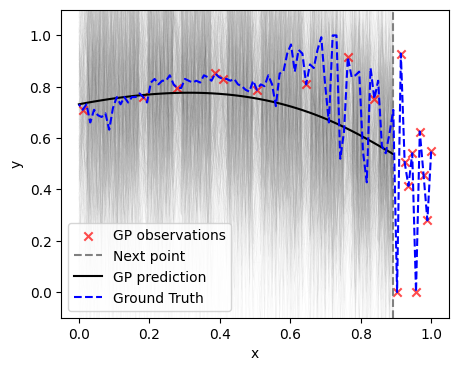


Exploration step 11


sample: 100%|██████████| 1000/1000 [00:08<00:00, 120.49it/s, 7 steps of size 6.86e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.04      3.12      1.39      0.37      3.52    145.98      1.01
    k_scale      1.03      1.02      0.72      0.13      2.18    318.56      1.00
      noise      0.09      0.04      0.08      0.04      0.14    269.06      1.00



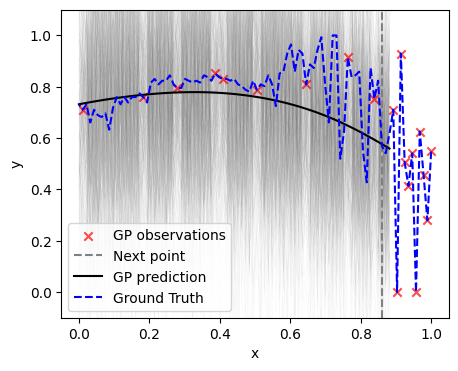


Exploration step 12


sample: 100%|██████████| 1000/1000 [00:06<00:00, 148.45it/s, 3 steps of size 6.86e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.77      1.47      1.40      0.31      3.04    351.05      1.00
    k_scale      1.01      0.98      0.69      0.11      2.09    290.60      1.01
      noise      0.08      0.03      0.07      0.04      0.13    264.65      1.00



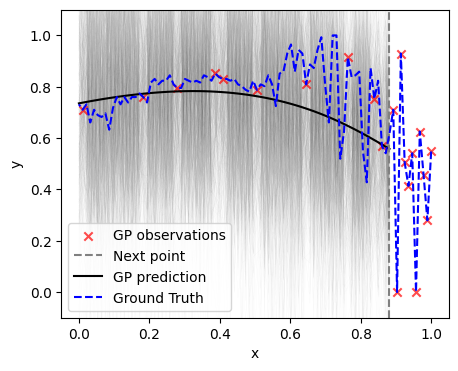


Exploration step 13


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.13it/s, 7 steps of size 6.96e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.86      1.70      1.41      0.46      3.54    264.37      1.00
    k_scale      1.02      0.96      0.70      0.12      2.25    176.66      1.02
      noise      0.08      0.03      0.07      0.04      0.12    256.83      1.00



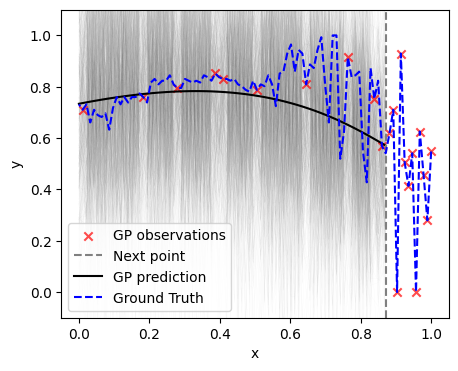


Exploration step 14


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.56it/s, 3 steps of size 7.18e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.69      1.41      1.40      0.37      2.92    360.29      1.00
    k_scale      1.02      0.97      0.71      0.07      2.16    264.50      1.00
      noise      0.07      0.03      0.07      0.03      0.11    276.48      1.00



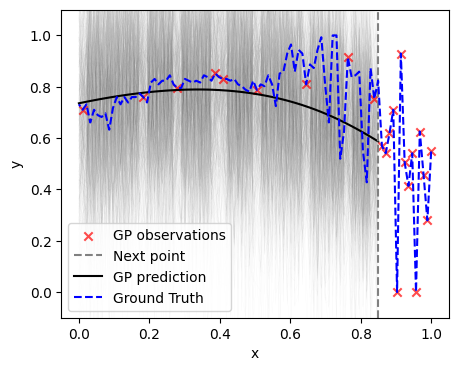


Exploration step 15


sample: 100%|██████████| 1000/1000 [07:09<00:00,  2.33it/s, 1023 steps of size 1.25e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.25      4.91      4.93      1.11     11.66     57.79      1.00
    k_scale      0.25      0.16      0.20      0.04      0.45     39.43      1.06
      noise      0.07      0.03      0.07      0.04      0.11     62.03      1.07



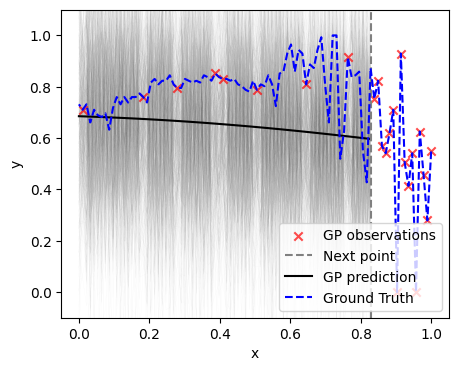


Exploration step 16


sample: 100%|██████████| 1000/1000 [06:58<00:00,  2.39it/s, 1023 steps of size 1.23e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.22      4.74      4.87      0.96     11.86     55.32      1.01
    k_scale      0.25      0.16      0.20      0.04      0.45     41.49      1.06
      noise      0.07      0.02      0.07      0.03      0.10     55.82      1.07



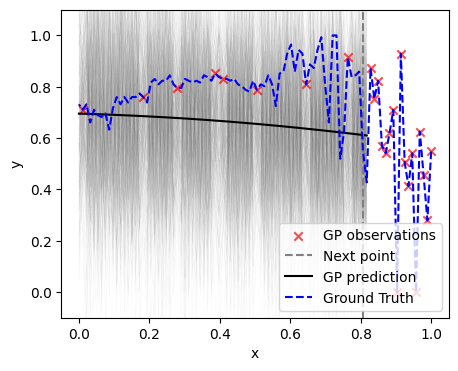


Exploration step 17


sample: 100%|██████████| 1000/1000 [07:08<00:00,  2.33it/s, 1023 steps of size 1.19e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.69      5.44      5.14      1.00     12.93     47.64      1.01
    k_scale      0.24      0.16      0.19      0.04      0.44     42.05      1.06
      noise      0.07      0.02      0.07      0.03      0.10     48.88      1.09



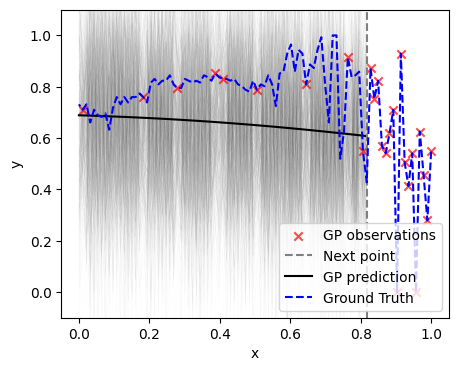


Exploration step 18


sample: 100%|██████████| 1000/1000 [07:20<00:00,  2.27it/s, 1023 steps of size 1.12e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.84      5.31      5.47      1.13     14.00     41.49      1.01
    k_scale      0.24      0.16      0.20      0.04      0.47     27.92      1.07
      noise      0.07      0.02      0.07      0.04      0.11     50.02      1.09



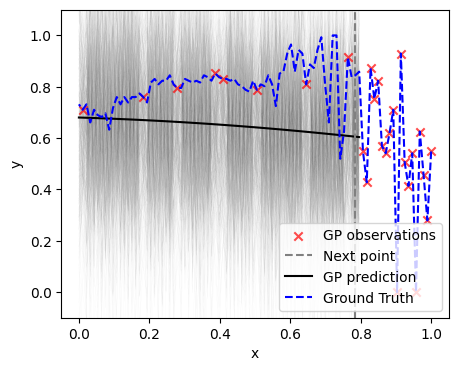


Exploration step 19


sample: 100%|██████████| 1000/1000 [07:17<00:00,  2.28it/s, 1023 steps of size 1.19e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.85      5.28      5.43      1.17     13.88     42.07      1.01
    k_scale      0.24      0.15      0.19      0.03      0.45     29.34      1.07
      noise      0.07      0.02      0.06      0.03      0.10     52.17      1.09



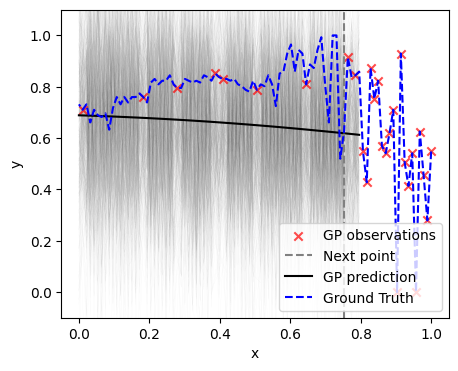


Exploration step 20


sample: 100%|██████████| 1000/1000 [07:33<00:00,  2.20it/s, 1023 steps of size 1.19e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.29      5.77      5.65      1.44     14.35     49.09      1.01
    k_scale      0.23      0.14      0.18      0.04      0.41     38.76      1.07
      noise      0.06      0.02      0.06      0.03      0.09     56.76      1.07



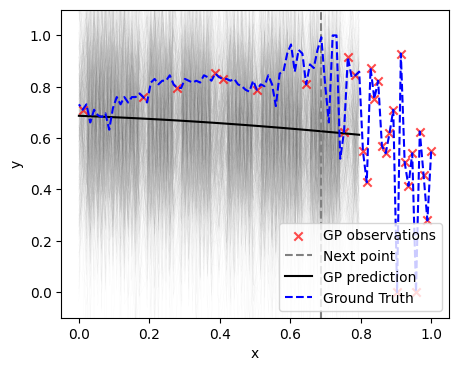


Exploration step 21


sample: 100%|██████████| 1000/1000 [07:27<00:00,  2.24it/s, 1023 steps of size 1.10e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.10      5.28      5.62      0.88     13.36     48.92      1.01
    k_scale      0.23      0.15      0.19      0.04      0.43     32.36      1.07
      noise      0.06      0.02      0.06      0.03      0.09     47.67      1.10



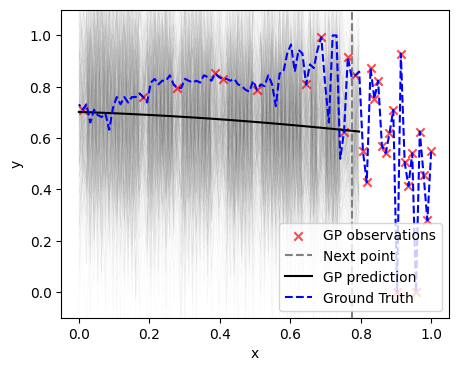


Exploration step 22


sample: 100%|██████████| 1000/1000 [07:34<00:00,  2.20it/s, 1023 steps of size 1.12e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.14      5.37      5.66      1.26     14.53     33.72      1.01
    k_scale      0.23      0.15      0.19      0.05      0.46     25.45      1.08
      noise      0.06      0.02      0.06      0.03      0.09     46.66      1.10



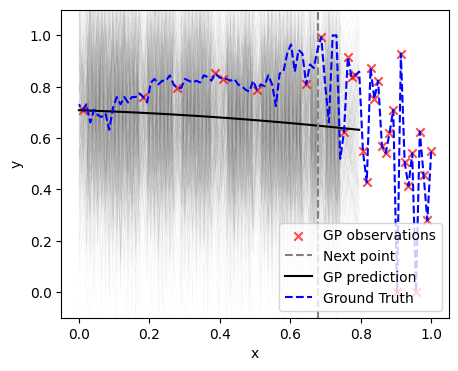


Exploration step 23


sample: 100%|██████████| 1000/1000 [07:03<00:00,  2.36it/s, 1023 steps of size 1.19e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.05      5.18      5.40      1.26     14.28     47.03      1.02
    k_scale      0.22      0.14      0.19      0.04      0.42     36.69      1.08
      noise      0.06      0.02      0.06      0.03      0.08     55.03      1.07



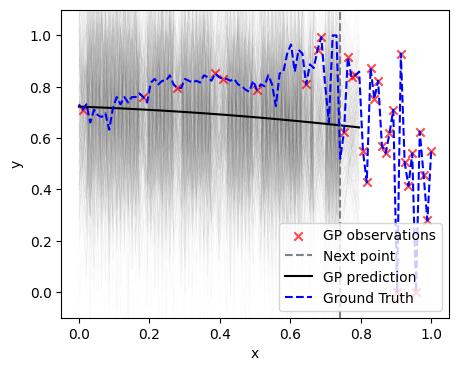


Exploration step 24


sample: 100%|██████████| 1000/1000 [00:07<00:00, 126.65it/s, 7 steps of size 6.35e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.40      1.02      1.16      0.39      2.34    302.37      1.00
    k_scale      1.00      1.08      0.69      0.06      2.01    337.99      1.01
      noise      0.06      0.02      0.05      0.03      0.08    284.55      1.00



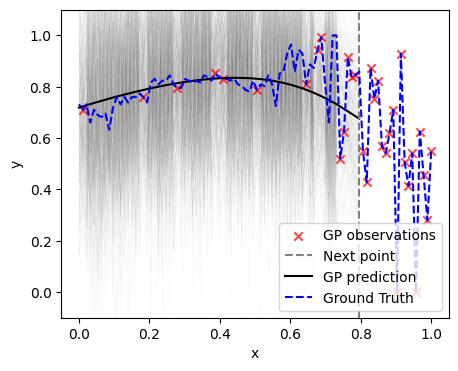


Exploration step 25


sample: 100%|██████████| 1000/1000 [00:08<00:00, 123.15it/s, 5 steps of size 6.04e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.40      1.48      1.05      0.36      2.25    186.50      1.00
    k_scale      0.94      0.82      0.71      0.14      1.81    330.32      1.00
      noise      0.05      0.01      0.05      0.03      0.08    359.62      1.00



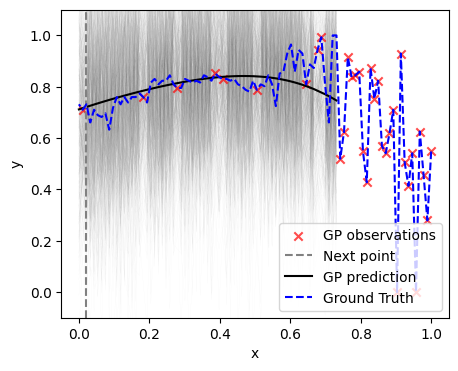


Exploration step 26


sample: 100%|██████████| 1000/1000 [00:07<00:00, 127.78it/s, 7 steps of size 6.39e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.23      0.75      1.05      0.37      2.01    473.14      1.00
    k_scale      0.95      0.84      0.71      0.13      1.81    339.40      1.00
      noise      0.05      0.01      0.05      0.03      0.07    310.24      1.00



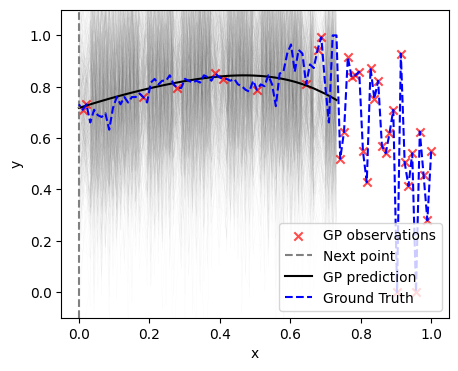


Exploration step 27


sample: 100%|██████████| 1000/1000 [00:07<00:00, 132.62it/s, 7 steps of size 6.61e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.35      1.03      1.14      0.41      2.08    305.24      1.00
    k_scale      1.04      1.06      0.73      0.12      2.13    239.73      1.00
      noise      0.05      0.01      0.05      0.03      0.07    312.00      1.00



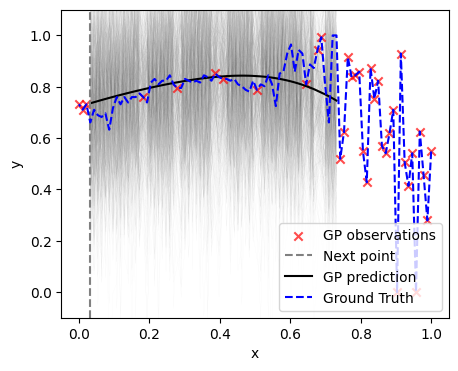


Exploration step 28


sample: 100%|██████████| 1000/1000 [00:07<00:00, 129.16it/s, 7 steps of size 7.01e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.26      0.86      1.12      0.40      1.92    258.12      1.00
    k_scale      1.00      0.99      0.72      0.14      2.11    314.44      1.00
      noise      0.05      0.01      0.05      0.03      0.07    300.55      1.00



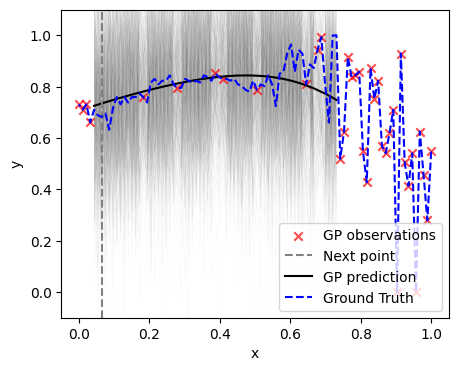


Exploration step 29


sample: 100%|██████████| 1000/1000 [00:07<00:00, 132.38it/s, 7 steps of size 7.23e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.25      0.81      1.12      0.52      2.01    277.64      1.00
    k_scale      0.93      0.89      0.68      0.12      1.95    401.22      1.00
      noise      0.05      0.01      0.05      0.03      0.07    288.65      1.00



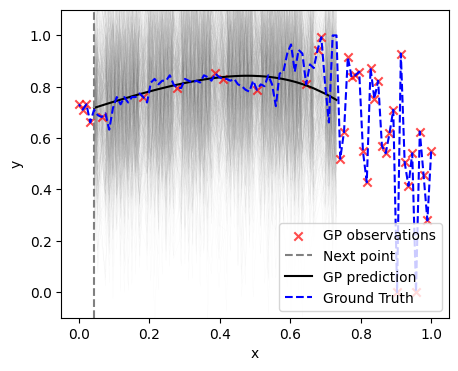


Exploration step 30


sample: 100%|██████████| 1000/1000 [00:07<00:00, 127.53it/s, 7 steps of size 6.67e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.24      0.82      1.09      0.41      1.85    239.55      1.00
    k_scale      1.04      1.09      0.73      0.10      2.12    224.88      1.00
      noise      0.05      0.01      0.04      0.03      0.06    303.25      1.01



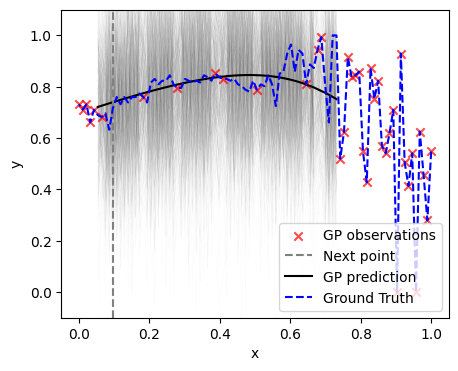

In [ ]:
rng_key, rng_key_predict = gpax.utils.get_keys()
exploration_steps = 30

for i in range(exploration_steps):
    print("\nExploration step {}".format(i+1))
    # Execute GP
    gpbo, obj, posterior_mean, f_samples = run_GP(X_train, y_train, X_test)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax.axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    for y1 in f_samples:
      ax.plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax.plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax.plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax.plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax.legend();
    l.set_alpha(0)
    plt.ylim(-0.1, 1.1)
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)

# Case Study 2

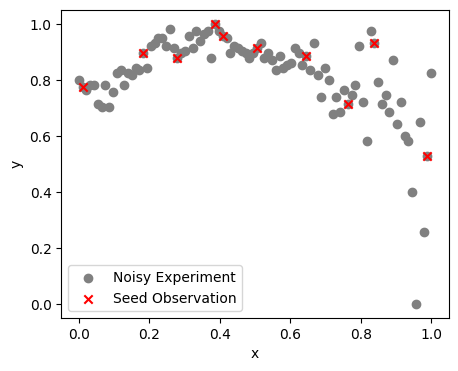

In [ ]:
# Select Experiment Data
X = norm_(np.asarray(x_composition))
y = norm_(np.asarray(y_coercive[0]))

# Select random initial points
init_points = 10 # number of initial points

# Full dataset
X = jnp.asarray(X)
y = jnp.asarray(y)
X = norm_(X)
y = norm_(y)

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, y, num_seed_points=init_points, rng_seed=10)

# Plot initial trian dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, y, label = "Noisy Experiment", color = "Gray")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

### Start BO exploration


Exploration step 1


sample: 100%|██████████| 1000/1000 [00:05<00:00, 176.70it/s, 7 steps of size 6.55e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.31      1.83      1.78      0.26      4.51    426.55      1.00
    k_scale      1.03      1.01      0.68      0.16      2.15    303.06      1.00
      noise      0.07      0.06      0.05      0.01      0.14    290.38      1.00



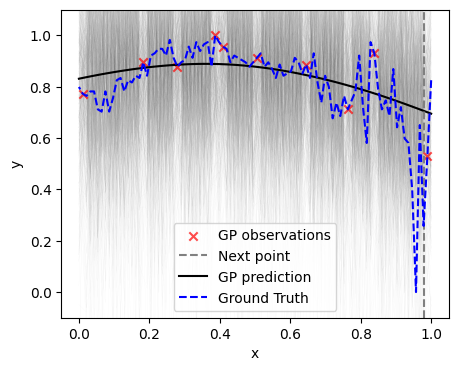


Exploration step 2


sample: 100%|██████████| 1000/1000 [00:05<00:00, 180.92it/s, 3 steps of size 7.80e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.84      1.79      1.40      0.32      3.12    313.51      1.00
    k_scale      1.04      1.01      0.72      0.08      2.16    298.13      1.00
      noise      0.09      0.07      0.07      0.02      0.18    266.74      1.00



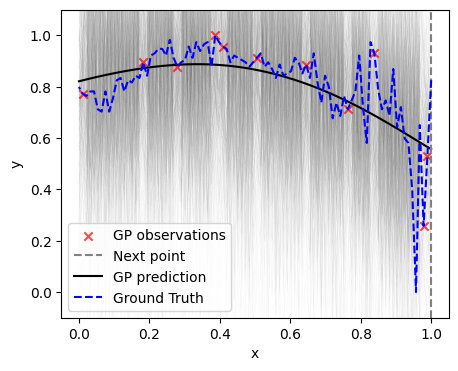


Exploration step 3


sample: 100%|██████████| 1000/1000 [00:05<00:00, 176.21it/s, 7 steps of size 6.28e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.24      1.84      1.70      0.36      4.17    302.73      1.00
    k_scale      1.04      1.05      0.72      0.07      2.20    301.77      1.00
      noise      0.09      0.05      0.07      0.03      0.16    233.30      1.00



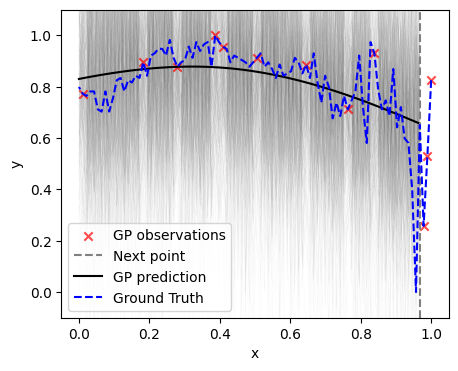


Exploration step 4


sample: 100%|██████████| 1000/1000 [00:05<00:00, 174.79it/s, 7 steps of size 6.98e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.22      1.77      1.72      0.39      4.06    319.71      1.00
    k_scale      0.98      0.94      0.66      0.12      2.06    314.37      1.00
      noise      0.08      0.05      0.06      0.02      0.14    285.29      1.00



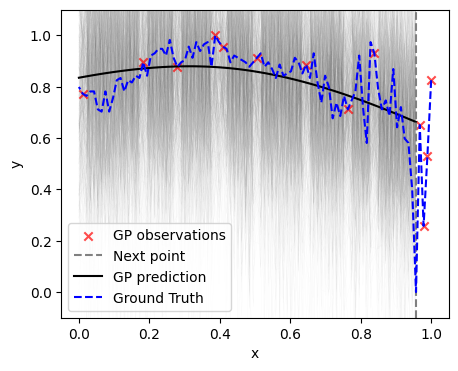


Exploration step 5


sample: 100%|██████████| 1000/1000 [00:05<00:00, 175.13it/s, 3 steps of size 7.44e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.92      1.75      1.46      0.27      3.49    283.35      1.00
    k_scale      1.03      0.98      0.75      0.12      2.09    325.36      1.01
      noise      0.12      0.06      0.10      0.04      0.20    280.30      1.00



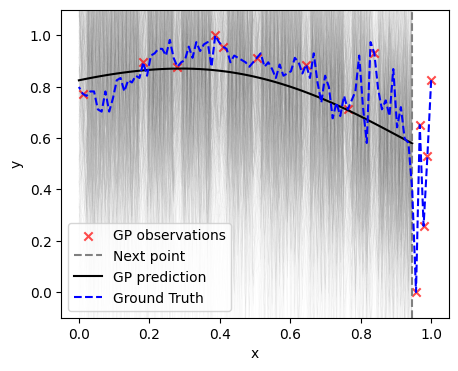


Exploration step 6


sample: 100%|██████████| 1000/1000 [00:05<00:00, 182.33it/s, 3 steps of size 7.57e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.77      1.54      1.42      0.33      3.07    325.58      1.00
    k_scale      1.11      1.08      0.78      0.11      2.45    319.62      1.01
      noise      0.11      0.05      0.09      0.04      0.19    244.15      1.00



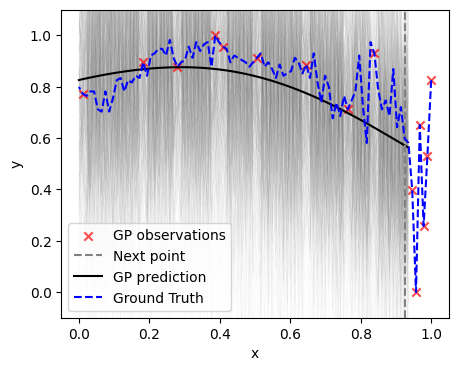


Exploration step 7


sample: 100%|██████████| 1000/1000 [00:05<00:00, 171.90it/s, 7 steps of size 6.75e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.77      1.46      1.40      0.28      3.13    283.44      1.00
    k_scale      1.12      1.13      0.75      0.16      2.36    353.12      1.00
      noise      0.09      0.04      0.08      0.03      0.15    304.09      1.00



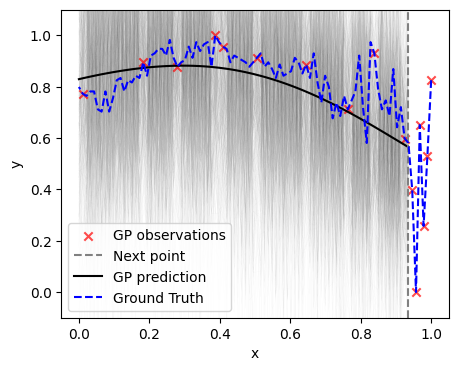


Exploration step 8


sample: 100%|██████████| 1000/1000 [00:06<00:00, 165.21it/s, 3 steps of size 7.04e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.02      2.88      1.42      0.31      3.11    158.63      1.00
    k_scale      1.11      1.02      0.81      0.15      2.35    328.72      1.00
      noise      0.08      0.04      0.07      0.03      0.14    308.17      1.00



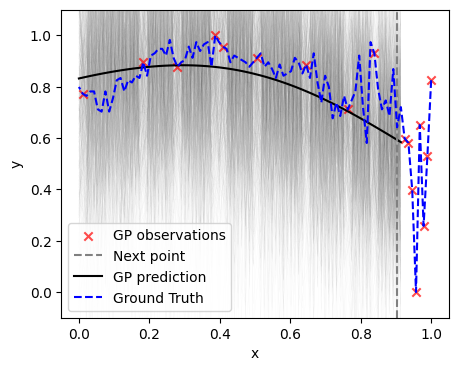


Exploration step 9


sample: 100%|██████████| 1000/1000 [00:06<00:00, 165.86it/s, 3 steps of size 7.74e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.68      1.21      1.40      0.41      3.00    393.26      1.00
    k_scale      1.06      0.95      0.78      0.11      2.21    306.04      1.00
      noise      0.08      0.03      0.07      0.03      0.12    290.21      1.00



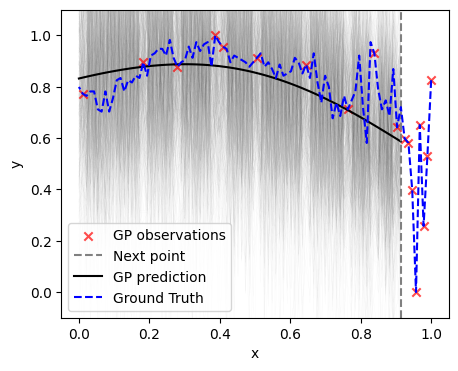


Exploration step 10


sample: 100%|██████████| 1000/1000 [00:06<00:00, 159.49it/s, 7 steps of size 6.67e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.82      1.39      1.47      0.30      3.17    238.60      1.00
    k_scale      1.07      1.09      0.75      0.08      2.18    292.37      1.01
      noise      0.07      0.03      0.07      0.03      0.12    304.55      1.00



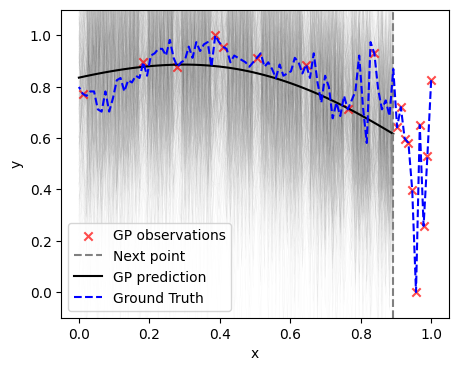


Exploration step 11


sample: 100%|██████████| 1000/1000 [00:06<00:00, 162.84it/s, 7 steps of size 6.60e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.73      1.34      1.37      0.37      3.13    307.09      1.00
    k_scale      1.04      1.15      0.76      0.10      1.88    271.57      1.01
      noise      0.07      0.03      0.06      0.03      0.12    268.87      1.00



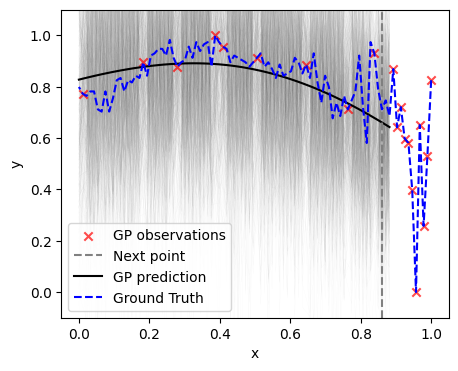


Exploration step 12


sample: 100%|██████████| 1000/1000 [00:06<00:00, 156.74it/s, 7 steps of size 6.89e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.94      2.50      1.43      0.44      3.30    144.71      1.01
    k_scale      1.14      1.13      0.80      0.09      2.26    316.79      1.00
      noise      0.07      0.03      0.06      0.03      0.11    280.83      1.01



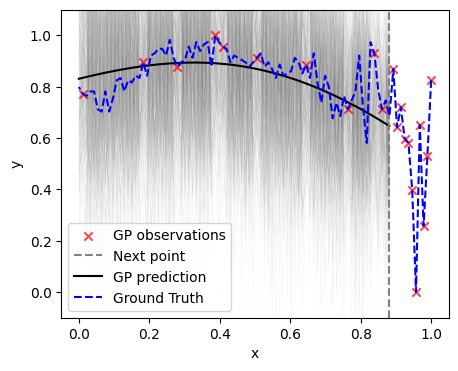


Exploration step 13


sample: 100%|██████████| 1000/1000 [00:06<00:00, 161.44it/s, 3 steps of size 8.55e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.59      1.07      1.37      0.34      2.68    365.02      1.00
    k_scale      1.07      0.99      0.75      0.14      2.27    236.01      1.00
      noise      0.06      0.02      0.06      0.03      0.10    313.48      1.00



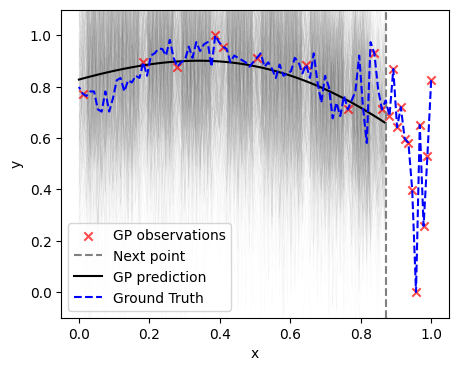


Exploration step 14


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.56it/s, 3 steps of size 7.16e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.85      2.17      1.37      0.36      3.07    166.33      1.00
    k_scale      1.13      1.04      0.81      0.10      2.26    336.22      1.00
      noise      0.06      0.02      0.05      0.03      0.09    277.94      1.00



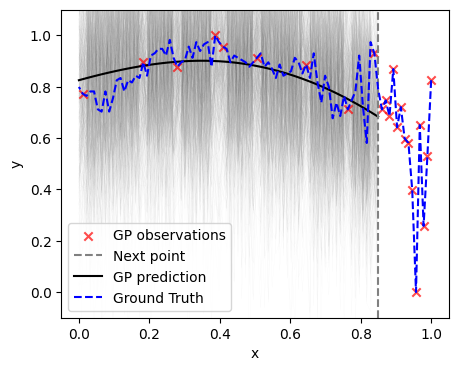


Exploration step 15


sample: 100%|██████████| 1000/1000 [07:14<00:00,  2.30it/s, 1023 steps of size 1.21e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.52      5.10      4.86      1.03     12.54     48.70      1.01
    k_scale      0.27      0.17      0.22      0.05      0.49     39.86      1.05
      noise      0.05      0.02      0.05      0.02      0.08     55.61      1.07



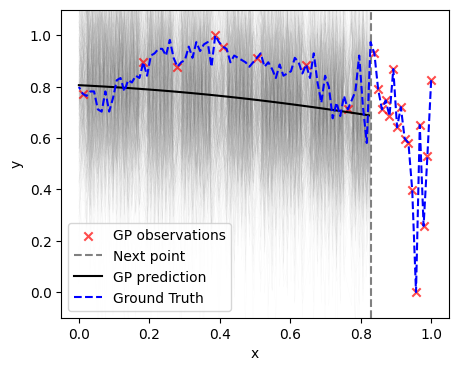


Exploration step 16


sample: 100%|██████████| 1000/1000 [07:25<00:00,  2.24it/s, 1023 steps of size 1.18e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.29      4.80      4.72      1.13     12.16     44.42      1.01
    k_scale      0.27      0.17      0.23      0.05      0.51     35.85      1.06
      noise      0.05      0.02      0.04      0.02      0.08     45.91      1.08



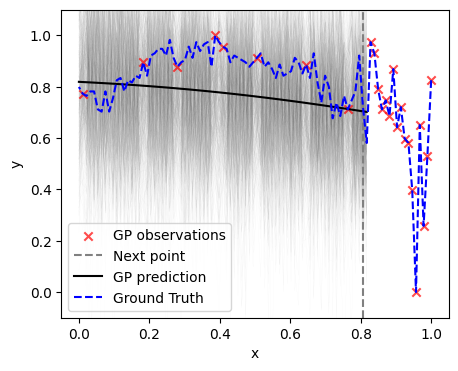


Exploration step 17


sample: 100%|██████████| 1000/1000 [07:23<00:00,  2.26it/s, 1023 steps of size 1.19e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.50      4.92      4.92      1.10     12.48     43.54      1.01
    k_scale      0.27      0.17      0.22      0.05      0.49     36.15      1.06
      noise      0.04      0.02      0.04      0.02      0.07     45.92      1.08



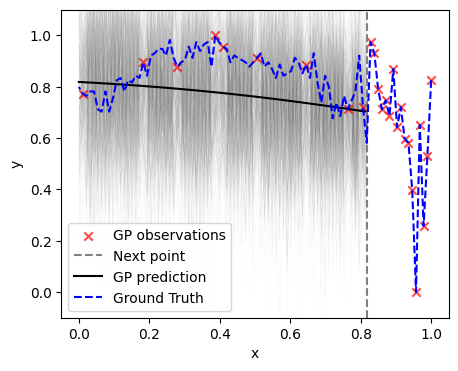


Exploration step 18


sample: 100%|██████████| 1000/1000 [07:32<00:00,  2.21it/s, 1023 steps of size 1.11e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.68      5.23      5.04      1.02     12.64     47.16      1.01
    k_scale      0.26      0.16      0.21      0.07      0.50     43.27      1.06
      noise      0.04      0.02      0.04      0.02      0.07     41.04      1.09



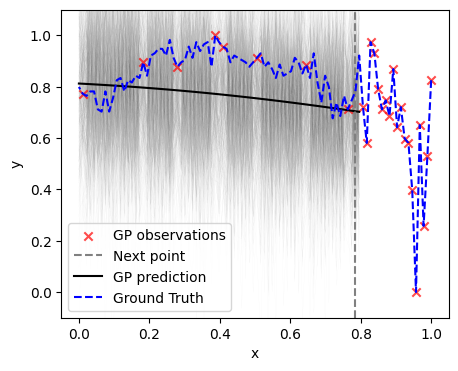


Exploration step 19


sample: 100%|██████████| 1000/1000 [07:25<00:00,  2.24it/s, 1023 steps of size 1.11e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.84      5.29      5.16      1.06     12.86     42.72      1.02
    k_scale      0.26      0.16      0.21      0.05      0.47     36.59      1.07
      noise      0.04      0.01      0.04      0.02      0.07     41.07      1.09



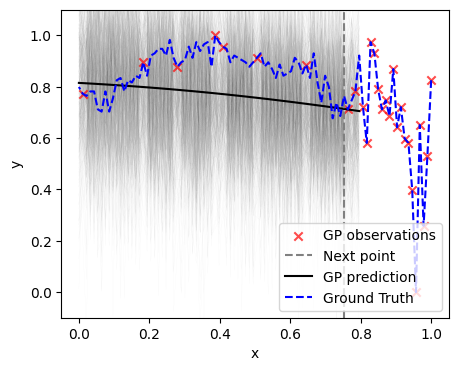


Exploration step 20


sample: 100%|██████████| 1000/1000 [07:23<00:00,  2.26it/s, 1023 steps of size 1.15e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.04      5.41      5.30      1.19     13.38     44.59      1.02
    k_scale      0.26      0.16      0.21      0.06      0.48     40.37      1.06
      noise      0.04      0.01      0.04      0.02      0.06     48.81      1.07



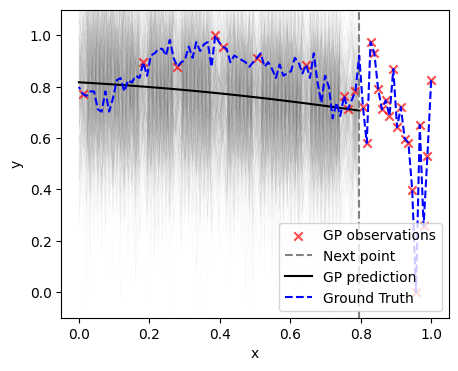


Exploration step 21


sample: 100%|██████████| 1000/1000 [07:38<00:00,  2.18it/s, 1023 steps of size 1.23e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.06      5.26      5.38      1.22     13.00     40.17      1.01
    k_scale      0.25      0.16      0.21      0.05      0.47     38.47      1.05
      noise      0.04      0.01      0.04      0.02      0.06     54.62      1.07



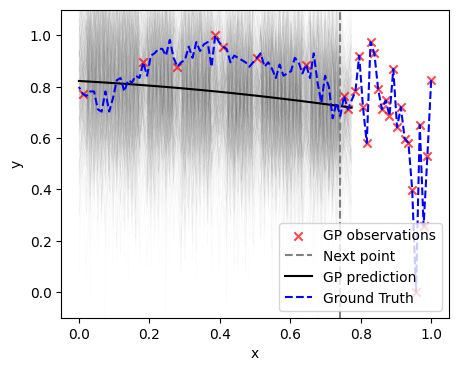


Exploration step 22


sample: 100%|██████████| 1000/1000 [07:48<00:00,  2.13it/s, 1023 steps of size 1.23e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.17      5.32      5.39      1.25     13.61     39.96      1.02
    k_scale      0.25      0.15      0.21      0.04      0.45     34.57      1.07
      noise      0.04      0.01      0.04      0.02      0.06     49.27      1.06



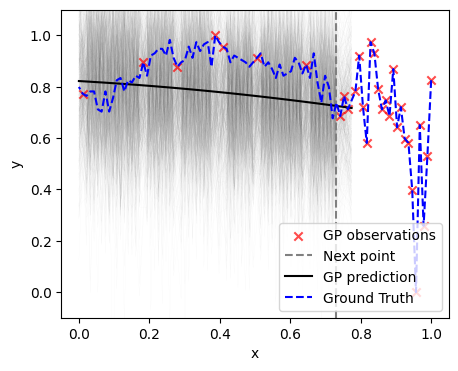


Exploration step 23


sample: 100%|██████████| 1000/1000 [07:02<00:00,  2.37it/s, 1023 steps of size 1.26e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.27      5.37      5.48      1.28     13.52     37.35      1.01
    k_scale      0.25      0.15      0.20      0.04      0.45     34.87      1.05
      noise      0.04      0.01      0.03      0.02      0.05     56.31      1.06



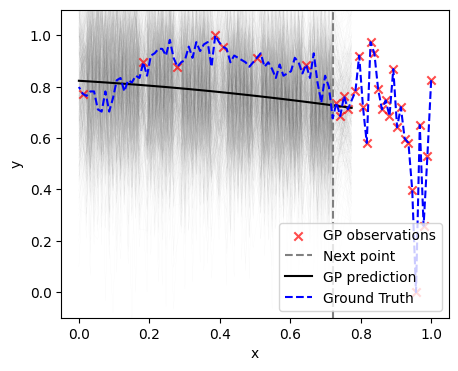


Exploration step 24


sample: 100%|██████████| 1000/1000 [00:07<00:00, 135.78it/s, 7 steps of size 6.50e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.60      1.05      1.38      0.40      2.59    372.83      1.00
    k_scale      1.12      1.22      0.76      0.09      2.16    300.61      1.00
      noise      0.04      0.01      0.04      0.02      0.06    248.86      1.00



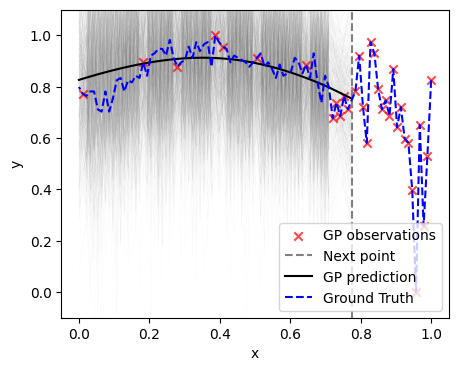


Exploration step 25


sample: 100%|██████████| 1000/1000 [00:07<00:00, 131.48it/s, 7 steps of size 6.47e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.60      1.02      1.38      0.37      2.54    384.72      1.01
    k_scale      1.03      1.03      0.75      0.14      1.94    368.86      1.00
      noise      0.04      0.01      0.04      0.02      0.05    274.58      1.00



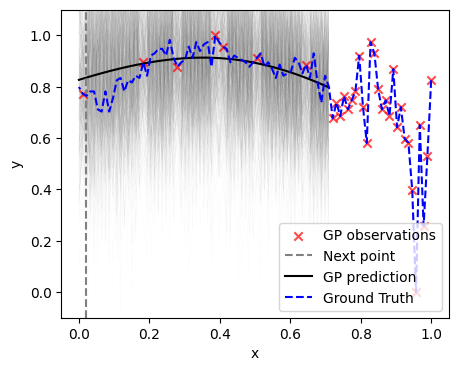


Exploration step 26


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.88it/s, 7 steps of size 6.39e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.50      0.93      1.31      0.37      2.38    383.91      1.00
    k_scale      1.05      1.07      0.76      0.14      2.14    307.13      1.00
      noise      0.04      0.01      0.04      0.02      0.06    264.03      1.00



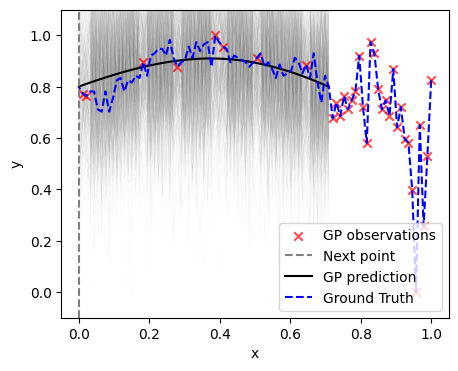


Exploration step 27


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.64it/s, 7 steps of size 6.66e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.47      0.95      1.31      0.43      2.22    219.42      1.02
    k_scale      0.98      1.07      0.70      0.15      1.93    325.33      1.02
      noise      0.04      0.01      0.03      0.02      0.05    245.06      1.01



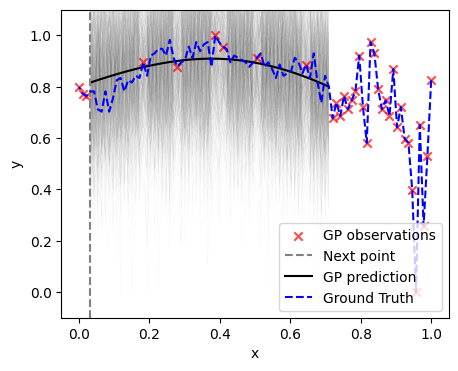


Exploration step 28


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.07it/s, 7 steps of size 6.68e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.50      1.01      1.32      0.39      2.27    253.83      1.00
    k_scale      1.09      1.11      0.78      0.10      2.17    334.53      1.00
      noise      0.03      0.01      0.03      0.02      0.05    290.38      1.00



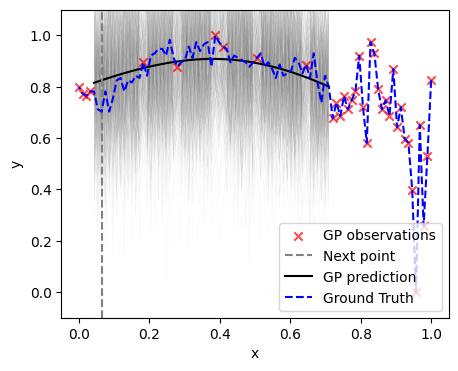


Exploration step 29


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.80it/s, 7 steps of size 6.62e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.43      0.93      1.23      0.37      2.16    402.58      1.00
    k_scale      1.05      1.11      0.74      0.15      2.05    369.68      1.00
      noise      0.03      0.01      0.03      0.02      0.05    295.26      1.00



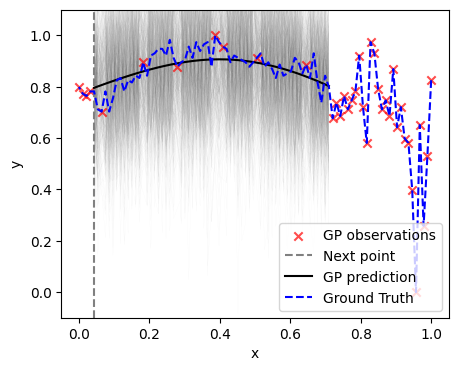


Exploration step 30


sample: 100%|██████████| 1000/1000 [00:07<00:00, 139.53it/s, 7 steps of size 6.44e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.41      0.87      1.24      0.43      2.17    341.34      1.01
    k_scale      1.06      1.00      0.76      0.12      2.06    295.14      1.00
      noise      0.03      0.01      0.03      0.02      0.05    283.16      1.00



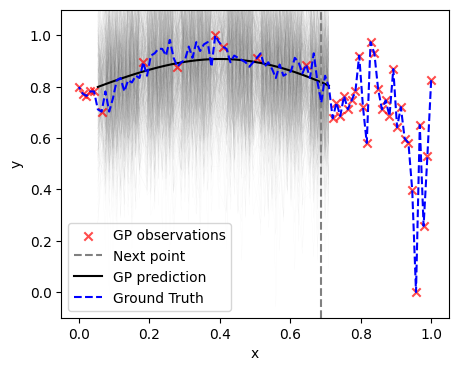

In [ ]:
rng_key, rng_key_predict = gpax.utils.get_keys()
exploration_steps = 30

for i in range(exploration_steps):
    print("\nExploration step {}".format(i+1))
    # Execute GP
    gpbo, obj, posterior_mean, f_samples = run_GP(X_train, y_train, X_test)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax.axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    for y1 in f_samples:
      ax.plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax.plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax.plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax.plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax.legend();
    l.set_alpha(0)
    plt.ylim(-0.1, 1.1)
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)

#Strategic BO

-- Functions

In [ ]:
import time
# Function for perform voting to assess spectral quality
def votes_initialdata(X, y, X_train, y_train, data, idx):
    beps_wv= data[0]
    pola_off = data[1]
    idx_good = []
    idx_bad = []
    for i in range(0, len(idx)):
        #plt.figure(figsize = (5, 4))
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
        ax1.scatter(X, y, label = "Noisy Experiment", color = "Gray")
        ax1.scatter(X_train[i], y_train[i], label = "Observation"+str(idx[i]), color = 'red', marker = 'x')
        ax1.set_xlabel("Composition")
        ax1.set_ylabel("y")
        ax1.legend()
        ax1.set_title("Initial target values")
        ax2.plot(beps_wv, (pola_off.mean(axis = 1)[idx[i]])*1E5, linewidth = 2)
        ax2.set_title("Initial spectral")
        ax2.set_xlabel("Wavelength")
        ax2.set_ylabel("Polarization")
        plt.show()

        # User votes the quality of the spectral- Domain knowledge injection in BO initialization
        print("Is the current spectral good? y- Yes or press ENTER- No")
        time.sleep(0.5)
        ip = input("Answer: ")
        if (ip == 'Y' or ip == 'y'):
            idx_good = np.hstack((idx_good, idx[i]))
            #idx_good.append(idx[i])
        else:
            idx_bad = np.hstack((idx_bad, idx[i]))
            #idx_bad.append(idx[i])
    idx_good = idx_good.astype(int)
    idx_bad = idx_bad.astype(int)

    return idx_good, idx_bad

# Function for perform GP-- to contrain between good and bad region
def run_constrainGP (xtrain, ytrain, xtest, fn = None, fn_priors = None):
  rng_key, rng_key_predict = gpax.utils.get_keys()
  # Obtain/update GP posterior
  gp_model = gpax.ExactGP(1, kernel='Matern', mean_fn=fn, mean_fn_prior=fn_priors)
  gp_model.fit(rng_key, xtrain, ytrain, num_warmup=500, num_samples=500, num_chains=1)
  # Get GP prediction
  posterior_mean, f_samples = gp_model.predict(rng_key_predict, xtest)

  return gp_model, posterior_mean, f_samples

# Function for perform constrained cost based acq function
def cost_acqfun(models, train_x, Data, cost_params, params, isnorm=False):
    """
    cost based acquisition function- EI based
    Args:
        model: krigging model
        train_x: training data
        Data: Unexplored data to evaluate for next sample selection in list with actual values and normalized values
        cost_params: Params required for cost aware acquisition function
        params: Params required for standard EI acq function
        ieval: All the current locations explored
        isnorm: If the data need to be normalized. Default is False

    Returns:
        array of acquisition function values
    """

    data_real = Data[0] # True data
    data_norm = Data[1] #Normalize data

    best_x = cost_params[0]
    exp_x = cost_params[1]
    a = cost_params[2]
    b = cost_params[3]
    switch = cost_params[4]

    if isnorm == False:
        data = data_real
        # print(data)
    else:
        data = data_norm
        # print(data)

    gp_model = models
    # Compute standard acq function
    standard_acq = gpax.acquisition.EI(params, gp_model, data, maximize=False, noiseless=False)
    standard_acq = np.array(standard_acq)

    # Check for stability
    standard_acq[np.isnan(standard_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=standard_acq[np.isnan(standard_acq)==True].shape)*1e-3
    # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
    #standard_acq[ieval] = 0

    # Compute cost on non-normalized data
    prev_x = train_x[-1]
    x_center = best_x
    l_exp = len(exp_x)-1
    cost = np.zeros((standard_acq.shape[0], 2))
    c = np.zeros((standard_acq.shape[0]))

    for i in range(data_real.shape[0]):
        cost[i, 0] = a*(np.absolute(data_real[i]-x_center)) # encourage local exploration

        for j in range(l_exp): # discourage already invested locations of potential region of interest
          cost[i, 1] = cost[i, 1] + b*(np.absolute(data_real[i]-train_x[exp_x[j]]))
        if l_exp > 0:
          cost[i, 1] = cost[i, 1]/l_exp
          #cost[:, 1] = 0
        c[i] = -cost[i, 0] + cost[i, 1]
        #if c[i] < 0:
        #  c[i] = 0.1

    c = (c-np.min(c))/(np.max(c)-np.min(c))

    if (np.max(standard_acq)+1e-5)/(np.sum(standard_acq)+1e-5) >= 0.99:
        print("Full local exploration initiated")
        #standard_acq = 0*standard_acq
        cost_acq = c

    else:
        if switch == 1: #Explorative
          cost_acq = standard_acq*(np.sum(cost, axis=1))
        else: #Exploitative
          cost_acq = standard_acq/np.sum(cost, axis=1)

    return cost_acq

# Function to check region of interest/given the region is a good region
def check_ROI(train_x, train_y, best_x, best_y, exp_x):
    #best_y2 = np.max(train_y[exp_x[-1]+1:])
    #best_x2 = train_x[np.argmax(train_y[exp_x[-1]+1:])]
    #Find Euclidean distance between best x and the later explored x
    l = len(train_x[exp_x[-1]+1:])
    l_exp = len(exp_x)-1
    dist_x = np.zeros(l)
    dist_y = np.zeros(l)
    dist_z = np.zeros(l)
    for i in range(l):
        dist_x[i] = np.absolute(best_x - train_x[exp_x[-1]+i+1])
        dist_y[i] = train_y[exp_x[-1]+i+1]/best_y
        for j in range(l_exp): # discourage already invested locations of potential region of interest
          dist_z[i] = dist_z[i] + np.absolute(train_x[exp_x[-1]+i+1] - train_x[exp_x[j]])
        dist_z[i] = dist_z[i]/l_exp

    dim_x = 1

    F = (dist_x * dist_y * dist_z)/dim_x
    F_max = np.max(F)
    F_imax= np.argmax(F)


    prob_ROI = (dist_x[F_imax]/dim_x + dist_y[F_imax]/dim_x)
    if prob_ROI > 1:
        prob_ROI = 1
    #print(F_max, prob_ROI)
    #D = np.max(dist_x/dim_x) #Measure closeness

    #O = np.max(dist_y) #Measure optimality
    # We want to maximize D and O
    #print(D, O)
    #prob_ROI = min(D, O)
    #print(prob_ROI)
    #Probabilistic choice of identify the next best solution as a potential ROI
    if np.random.choice(np.arange(2), size=1, p =[1-prob_ROI, prob_ROI]) == 1: #New ROI
        exp_x = np.hstack((exp_x, int(exp_x[-1]+F_imax+1)))
        print(exp_x)
        print("New potential region of interest found with prob=", prob_ROI)
    else:
        exp_x = exp_x #No new ROI

    return exp_x

In [ ]:
# Function for performing a GP step, here we use structure GP (sGP)
def run_statGP (xtrain, ytrain, Data, fn = None, fn_priors = None, constraint = None, pen = 1, cost_params = None, isnorm=False):
  data_real = Data[0] # True data
  data_norm = Data[1] #Normalize data
  rng_key, rng_key_predict = gpax.utils.get_keys()
  # Obtain/update GP posterior
  gp_model = gpax.ExactGP(1, kernel='Matern', mean_fn=fn, mean_fn_prior=fn_priors)
  gp_model.fit(rng_key, xtrain, ytrain, num_warmup=500, num_samples=500, num_chains=1)
  # Compute acquisition function
  #obj = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test)
  cost_acq = cost_acqfun(gp_model, xtrain, Data, cost_params, rng_key_predict)

  if constraint is not None:
    cpen = np.ceil(np.max(cost_acq))
    for i in range(0, len(constraint)):
      if constraint[i] <= 0:
        cost_acq[i] = cost_acq[i] + (pen*cpen*constraint[i])

  # Get GP prediction
  if isnorm == False:
    posterior_mean, f_samples = gp_model.predict(rng_key_predict, data_real)
  else:
    posterior_mean, f_samples = gp_model.predict(rng_key_predict, data_norm)

  return gp_model, cost_acq, posterior_mean, f_samples

# Case Study 1- Off voltage nucleation

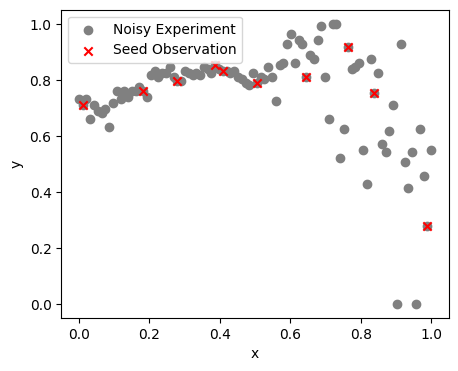

In [ ]:
# Select random initial points
init_points = 10 # number of initial points

def norm_(data):
  return (data - np.min(data)) / (np.max(data) - np.min(data))

# Select Experiment Data
X = norm_(np.asarray(x_composition))
y = norm_(np.asarray(y_nucleation[0]))

# Full dataset
#X = jnp.asarray(X)
#y = jnp.asarray(y)
#X = norm_(X)
#y = norm_(y)

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, y, num_seed_points=init_points, rng_seed=10)

# Plot initial train dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, y, label = "Noisy Experiment", color = "Gray")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

# User votes the quality of the initial sampled spectral

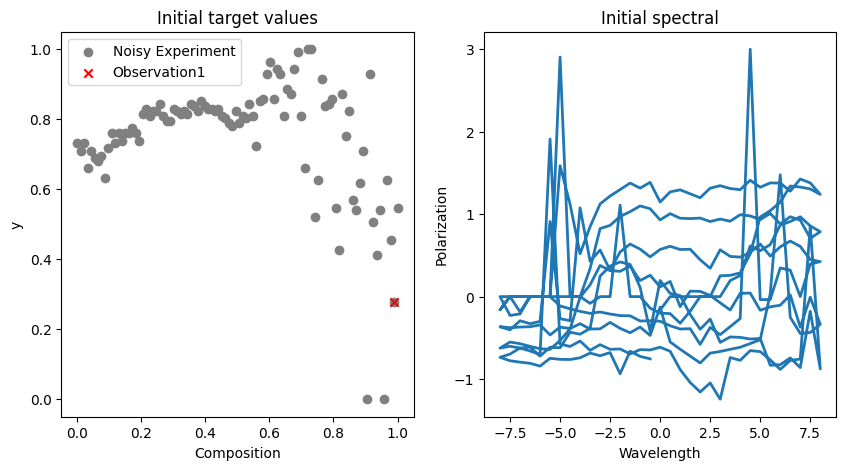

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


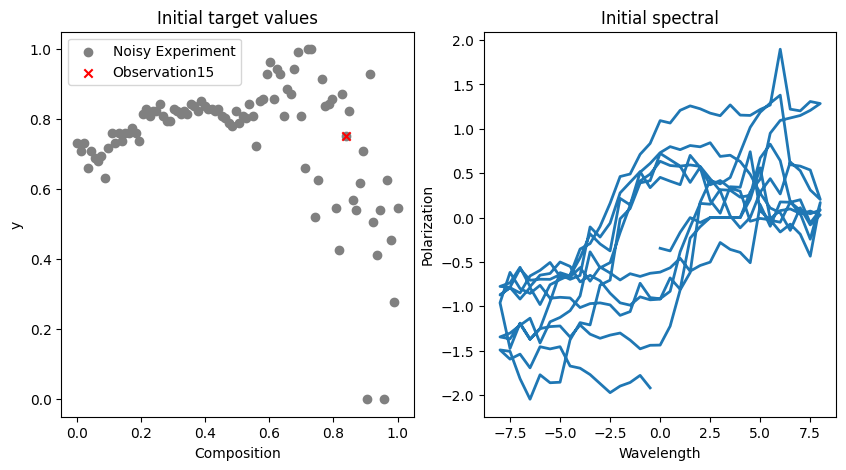

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


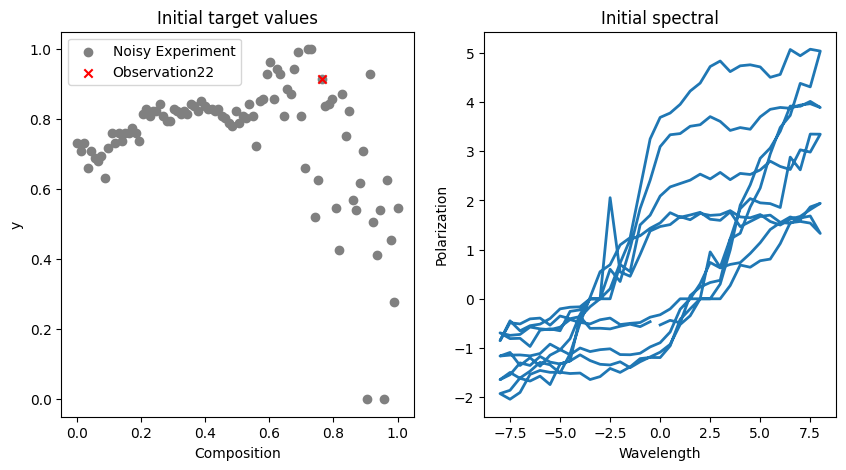

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


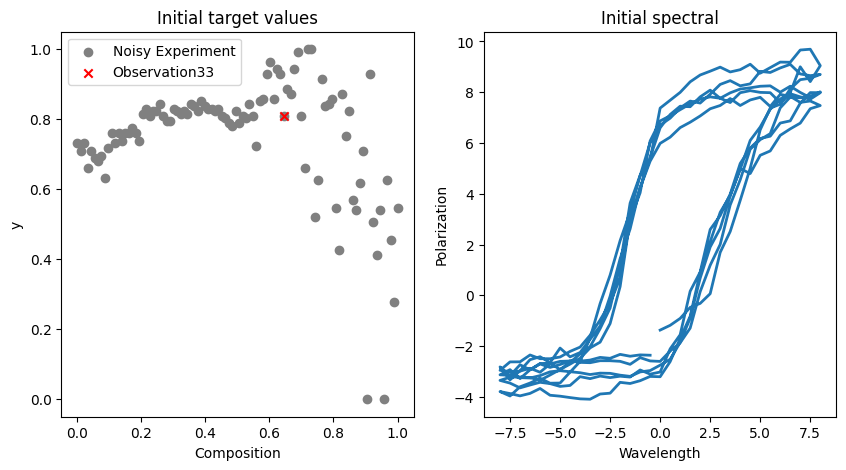

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


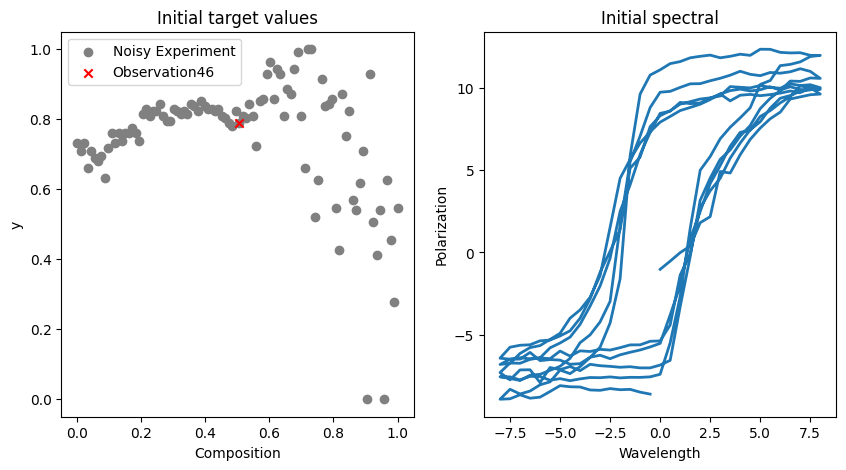

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


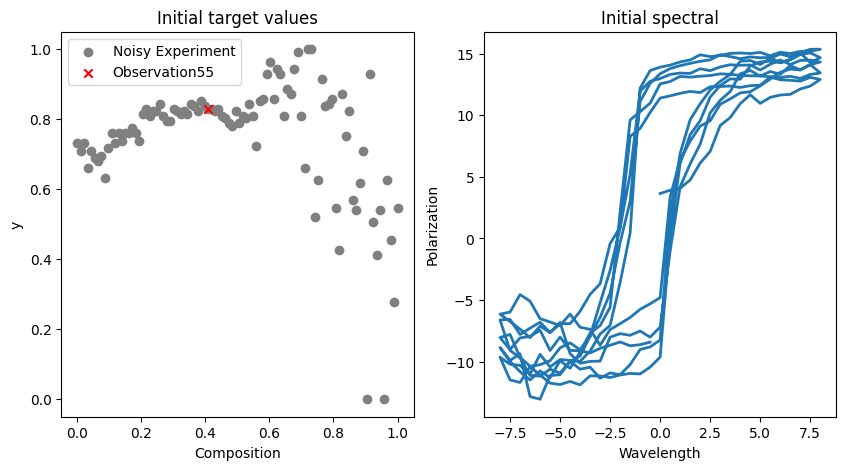

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


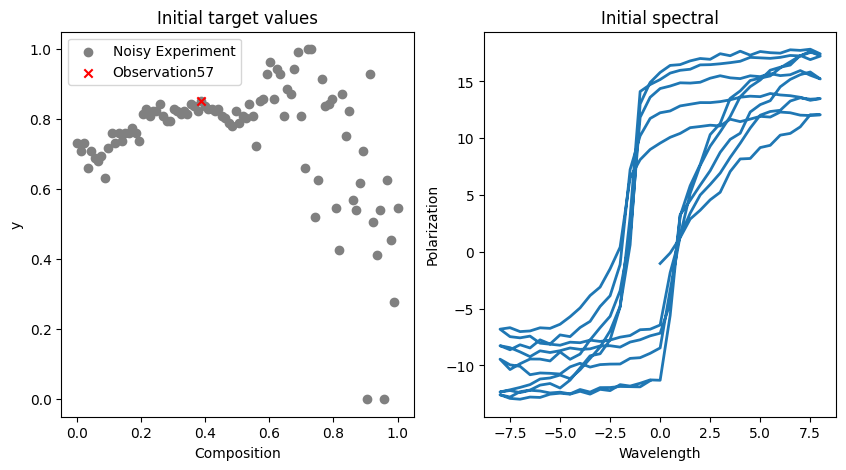

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


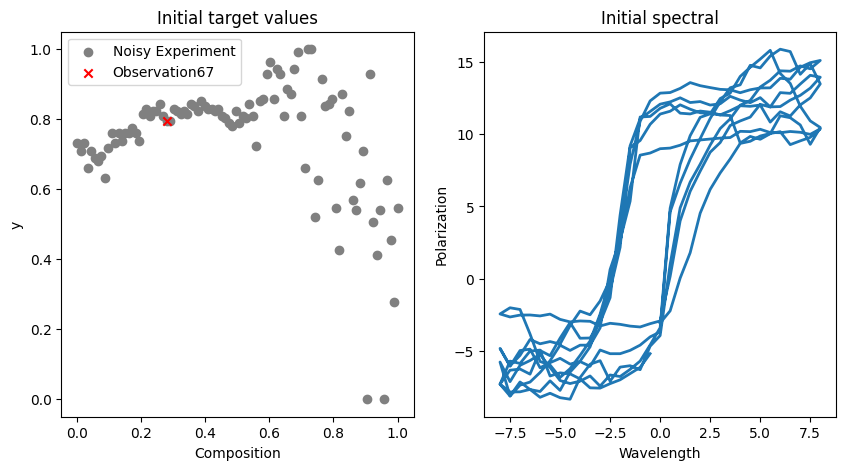

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


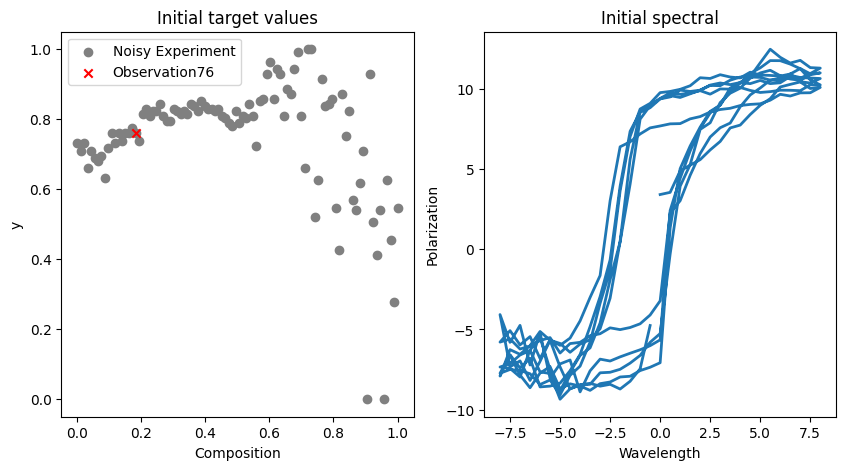

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


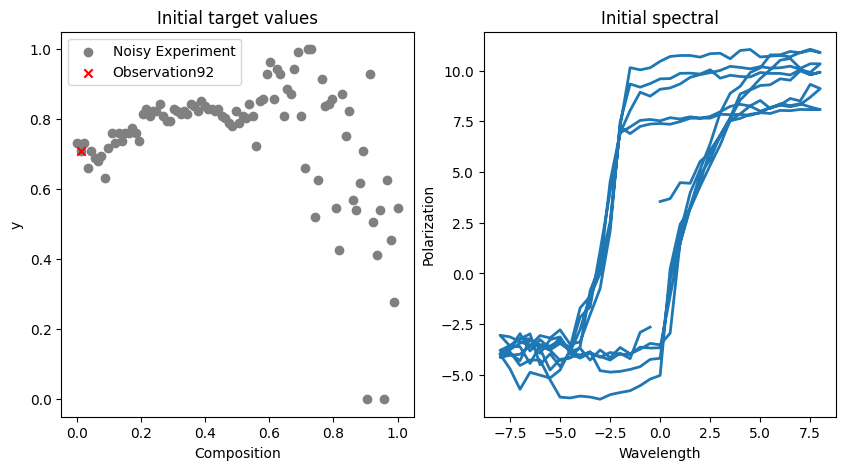

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


(array([33, 46, 55, 57, 67, 76, 92]), array([ 1, 15, 22]))

In [ ]:
pola_off = loops_off[:,:,0,]*np.cos(loops_off[:,:,3,])
pol_data = [beps_wv, pola_off]
idx_good, idx_bad = votes_initialdata(X, y, X_train, y_train, pol_data, indices_train)
idx_good, idx_bad

# Transform votes to distance metric to unknown good and bad regions

In [ ]:
y_vote = np.zeros(len(y_train))
for i in range(0, len(y_vote)):
    y_good = 0
    y_bad = 0
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[i] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)
    #print(y_good)

    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[i] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)
    #print(y_bad)

    y_vote[i] = y_bad - y_good # Turning into maximization problem


print(idx_good, idx_bad, y_vote)

[33 46 55 57 67 76 92] [ 1 15 22] [-0.51817716 -0.41781874 -0.31746032 -0.08090118  0.15873016  0.29697901
  0.32155658  0.41372248  0.46902202  0.51817716]


In [ ]:
c_loc = 1
c_glo = 1

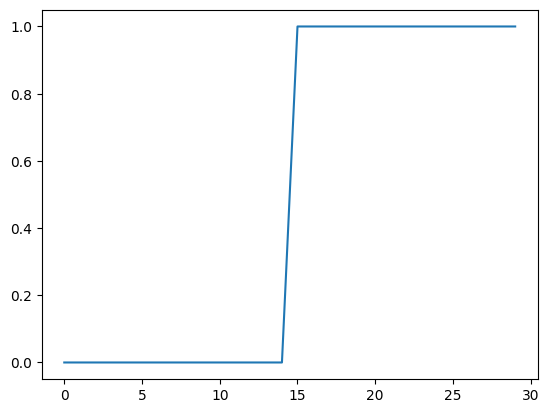

In [ ]:
k = np.zeros(30)
k[15:] = k[15:] + 1
plt.plot(k)

# Start Strategic BO

- Penalty = 1000

Step:1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 166.26it/s, 7 steps of size 5.55e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.70      0.98      0.25      1.91    402.04      1.00
    k_scale      0.99      1.06      0.67      0.08      2.08    307.22      1.00
      noise      0.07      0.07      0.04      0.00      0.14    294.75      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 171.50it/s, 7 steps of size 6.13e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.29      2.37      1.60      0.35      4.50    272.02      1.01
    k_scale      0.92      0.92      0.67      0.06      1.82    366.18      1.02
      noise      0.09      0.06      0.07      0.01      0.16    347.84      1.00



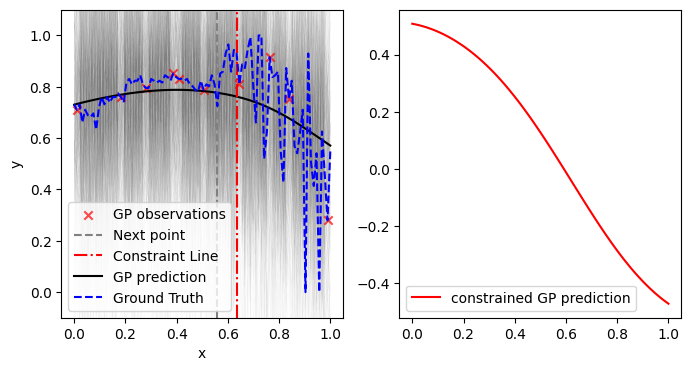

Step:2
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 167.93it/s, 7 steps of size 6.00e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.73      0.99      0.31      1.87    406.05      1.00
    k_scale      1.04      0.93      0.74      0.07      2.19    338.39      1.00
      noise      0.06      0.05      0.04      0.01      0.11    368.46      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.55it/s, 7 steps of size 6.52e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.49      3.10      1.68      0.28      4.53    166.49      1.00
    k_scale      1.03      1.06      0.70      0.11      2.06    342.81      1.00
      noise      0.08      0.06      0.06      0.02      0.16    250.58      1.00



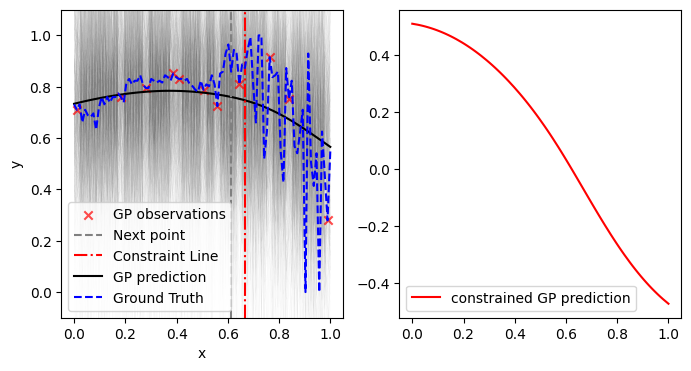

Step:3
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 167.41it/s, 7 steps of size 5.86e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.10      0.62      0.96      0.29      1.92    400.11      1.00
    k_scale      0.97      0.95      0.69      0.03      1.91    307.34      1.00
      noise      0.05      0.04      0.04      0.01      0.09    311.55      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.42it/s, 7 steps of size 7.18e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.33      3.06      1.56      0.25      3.95    207.02      1.00
    k_scale      0.97      0.95      0.68      0.14      1.98    336.67      1.00
      noise      0.06      0.04      0.05      0.01      0.13    292.91      1.00



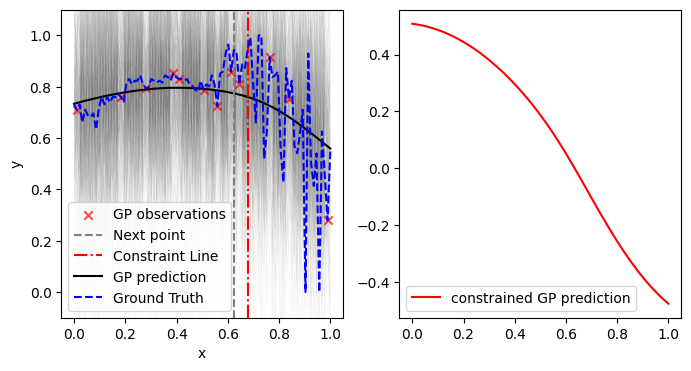

Step:4
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 166.11it/s, 7 steps of size 5.83e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.12      0.57      1.01      0.38      1.96    284.58      1.00
    k_scale      1.07      1.03      0.78      0.10      2.19    258.01      1.00
      noise      0.04      0.03      0.03      0.01      0.07    323.10      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 171.98it/s, 3 steps of size 6.21e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.16      2.15      1.44      0.30      4.52    270.61      1.00
    k_scale      0.98      0.88      0.70      0.11      2.00    278.60      1.00
      noise      0.05      0.04      0.04      0.01      0.11    242.05      1.00



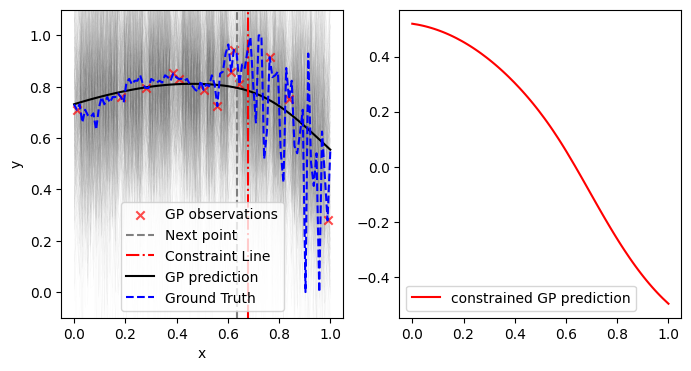

Step:5
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 168.83it/s, 7 steps of size 6.50e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.11      0.62      1.01      0.31      1.75    205.03      1.00
    k_scale      1.06      0.99      0.75      0.10      2.18    308.27      1.00
      noise      0.03      0.02      0.03      0.01      0.07    208.31      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 168.99it/s, 7 steps of size 6.20e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.58      1.31      1.25      0.25      2.97    415.57      1.01
    k_scale      0.99      0.91      0.71      0.13      1.95    299.73      1.00
      noise      0.04      0.03      0.04      0.01      0.08    293.83      1.01



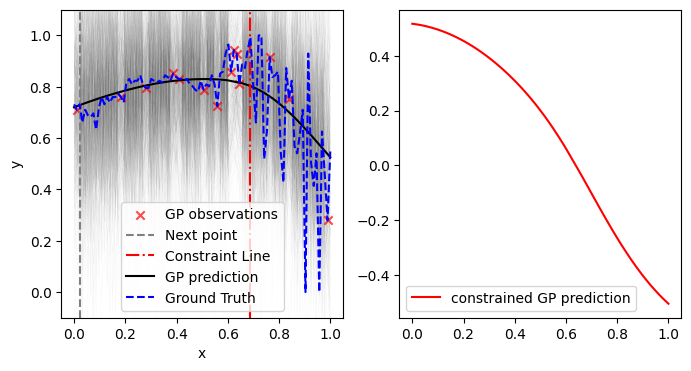

Step:6
Checking for ROI with potntial local optima
[0 1]
New potential region of interest found with prob= 0.43777176978206817
Running GP for constraint evaluation


<ipython-input-15-def33f35c924>:141: RuntimeWarning: invalid value encountered in scalar divide
  dist_z[i] = dist_z[i]/l_exp
sample: 100%|██████████| 1000/1000 [00:06<00:00, 162.44it/s, 3 steps of size 5.23e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.11      0.57      0.99      0.38      1.82    342.19      1.00
    k_scale      1.08      0.96      0.77      0.11      2.25    319.09      1.00
      noise      0.03      0.02      0.02      0.01      0.05    185.18      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 162.63it/s, 7 steps of size 5.92e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.98      4.64      1.15      0.28      2.79    133.46      1.01
    k_scale      0.98      0.97      0.69      0.12      1.94    314.44      1.00
      noise      0.04      0.02      0.03      0.01      0.07    257.44      1.00



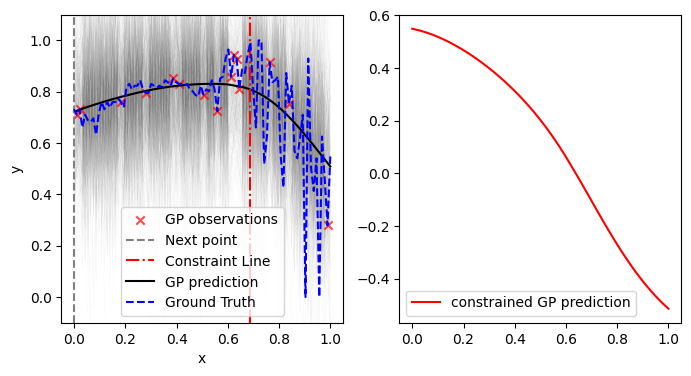

Step:7
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.51it/s, 7 steps of size 5.91e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.16      0.56      1.06      0.44      1.98    290.48      1.00
    k_scale      1.05      0.99      0.79      0.13      1.91    352.85      1.00
      noise      0.03      0.02      0.02      0.01      0.05    297.40      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 163.78it/s, 7 steps of size 6.76e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.50      1.57      1.07      0.32      2.69    189.95      1.00
    k_scale      0.89      0.83      0.62      0.18      1.92    335.36      1.00
      noise      0.03      0.02      0.03      0.01      0.06    261.71      1.00



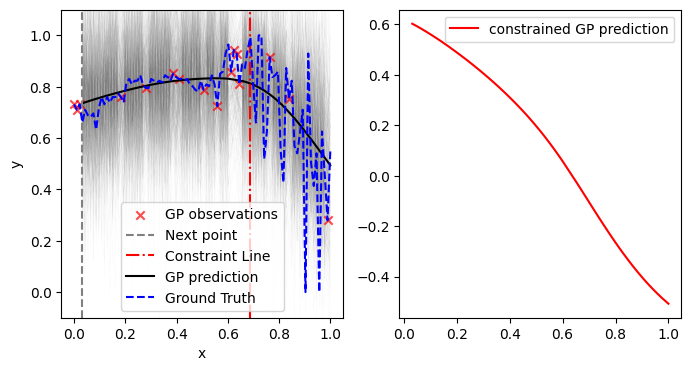

Step:8
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 150.38it/s, 7 steps of size 5.84e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.18      0.61      1.05      0.40      2.08    302.03      1.00
    k_scale      1.08      0.96      0.83      0.10      2.10    283.76      1.00
      noise      0.03      0.02      0.03      0.01      0.05    261.36      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 149.48it/s, 7 steps of size 6.24e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.29      1.30      0.99      0.27      2.12    409.48      1.00
    k_scale      1.00      0.85      0.75      0.15      2.29    288.82      1.00
      noise      0.02      0.02      0.02      0.00      0.04    308.00      1.00



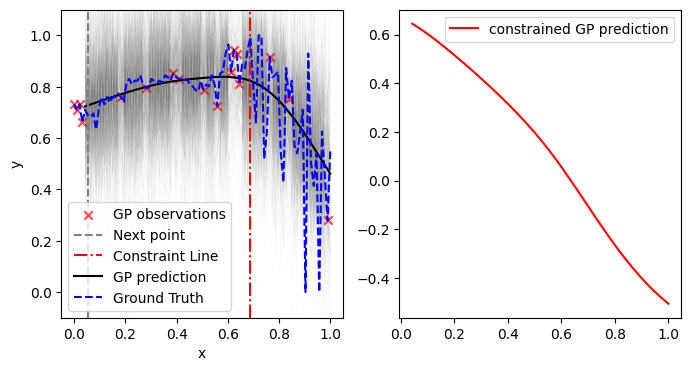

Step:9
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 150.39it/s, 7 steps of size 6.41e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.25      0.62      1.16      0.40      2.08    302.12      1.00
    k_scale      1.17      1.00      0.89      0.12      2.28    316.97      1.00
      noise      0.03      0.02      0.03      0.01      0.05    238.68      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 154.78it/s, 7 steps of size 6.97e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.27      1.55      0.93      0.36      1.93    226.41      1.00
    k_scale      1.04      1.07      0.68      0.14      2.12    299.02      1.00
      noise      0.02      0.01      0.02      0.00      0.04    233.40      1.00



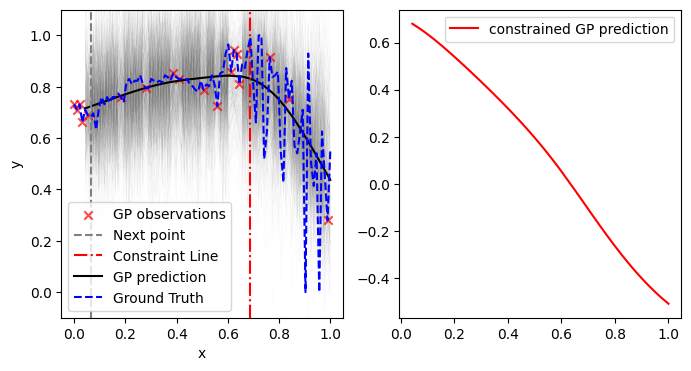

Step:10
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 147.86it/s, 3 steps of size 6.02e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.27      0.72      1.10      0.34      2.27    234.00      1.01
    k_scale      1.26      1.31      0.89      0.16      2.36    275.62      1.01
      noise      0.03      0.02      0.03      0.01      0.06    270.56      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.67it/s, 7 steps of size 6.32e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.08      0.98      0.85      0.29      1.71    237.10      1.00
    k_scale      1.08      1.05      0.70      0.14      2.30    274.14      1.00
      noise      0.02      0.01      0.01      0.00      0.03    231.51      1.00



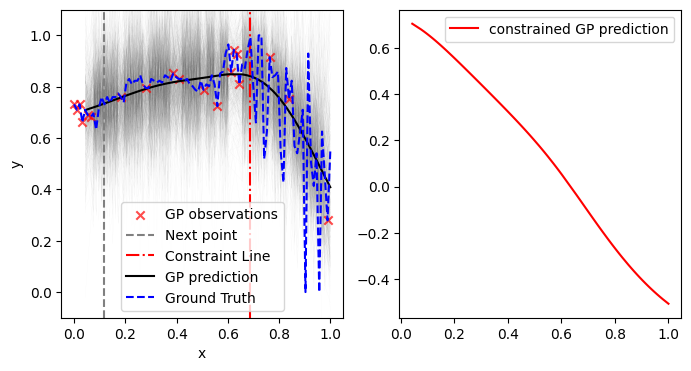

Step:11
Checking for ROI with potntial local optima
[ 0  1 16]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.77it/s, 3 steps of size 6.12e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.19      0.67      1.06      0.33      1.93    303.34      1.00
    k_scale      1.24      1.54      0.86      0.12      2.43    357.63      1.00
      noise      0.03      0.01      0.03      0.01      0.05    250.82      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.00it/s, 7 steps of size 5.07e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.99      0.76      0.85      0.32      1.51    378.70      1.00
    k_scale      1.01      0.85      0.76      0.14      1.97    269.69      1.00
      noise      0.01      0.01      0.01      0.00      0.03    289.84      1.00



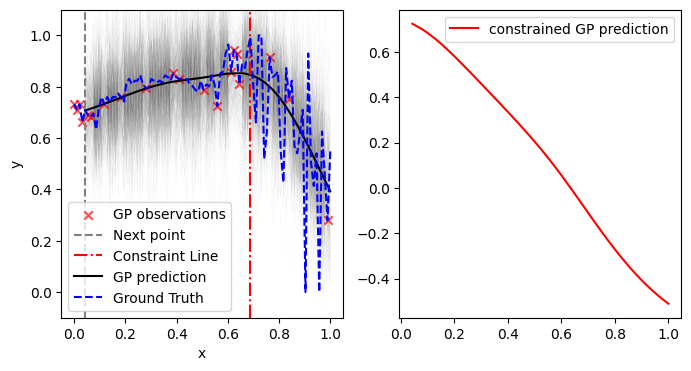

Step:12
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 148.67it/s, 7 steps of size 6.48e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.21      0.68      1.09      0.32      2.02    278.31      1.00
    k_scale      1.22      1.14      0.91      0.18      2.38    224.77      1.00
      noise      0.03      0.01      0.03      0.01      0.05    242.15      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 147.31it/s, 7 steps of size 6.70e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.85      0.38      0.78      0.32      1.31    307.95      1.00
    k_scale      1.00      0.92      0.75      0.09      1.87    298.75      1.00
      noise      0.01      0.01      0.01      0.00      0.02    286.56      1.00



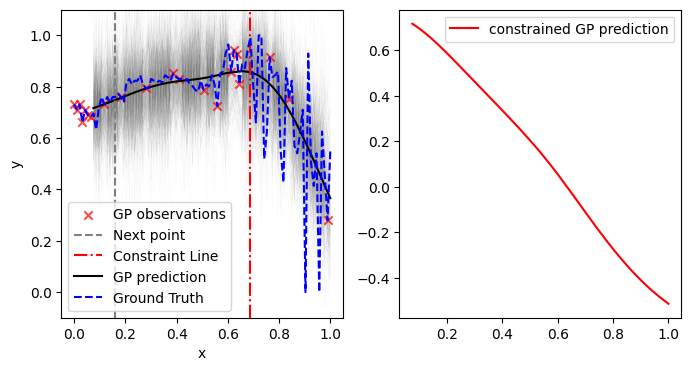

Step:13
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 143.30it/s, 3 steps of size 6.09e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.20      0.70      1.06      0.39      2.12    278.58      1.02
    k_scale      1.24      1.10      0.91      0.10      2.58    248.73      1.01
      noise      0.03      0.01      0.03      0.01      0.05    260.91      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 139.08it/s, 7 steps of size 6.37e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.85      0.44      0.74      0.33      1.31    345.09      1.00
    k_scale      0.98      0.87      0.71      0.11      1.90    322.98      1.00
      noise      0.01      0.01      0.01      0.00      0.02    304.44      1.00



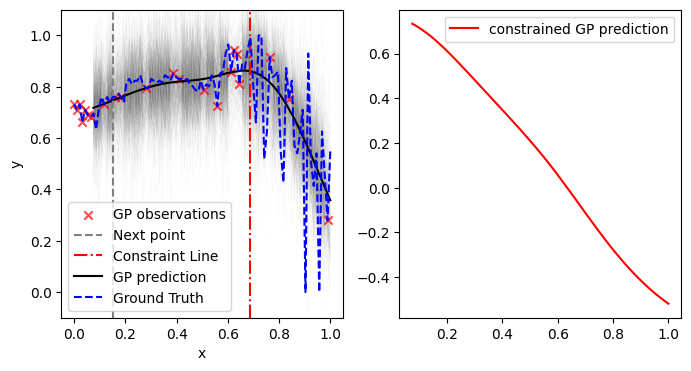

Step:14
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 146.97it/s, 7 steps of size 6.12e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.07      0.61      0.92      0.34      1.81    208.34      1.00
    k_scale      1.15      1.07      0.83      0.13      2.36    231.85      1.00
      noise      0.03      0.01      0.03      0.01      0.05    270.35      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 138.21it/s, 7 steps of size 4.36e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.79      0.39      0.71      0.30      1.24    281.12      1.00
    k_scale      0.99      0.86      0.71      0.16      1.98    265.99      1.00
      noise      0.01      0.01      0.01      0.00      0.01    334.37      1.00



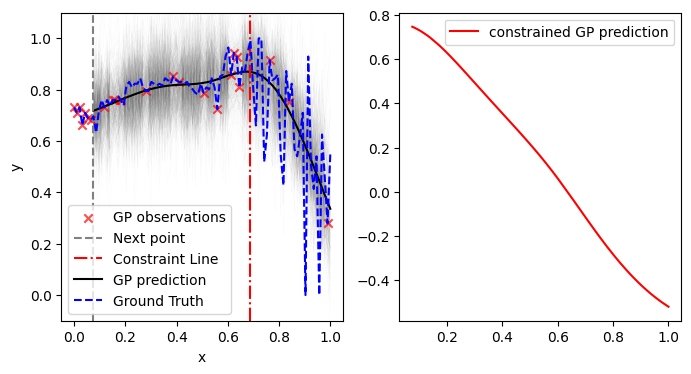

Step:15
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:26<00:00,  2.59it/s, 1023 steps of size 1.88e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.23      4.03      4.01      0.94     10.36     75.01      1.00
    k_scale      0.25      0.18      0.20      0.07      0.44     52.25      1.00
      noise      0.02      0.01      0.02      0.01      0.04     94.78      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:18<00:00,  2.28it/s, 1023 steps of size 9.67e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      8.61      5.26      6.85      1.96     15.93     30.20      1.02
    k_scale      0.17      0.10      0.15      0.03      0.28     37.43      1.05
      noise      0.01      0.01      0.01      0.00      0.02     34.61      1.10



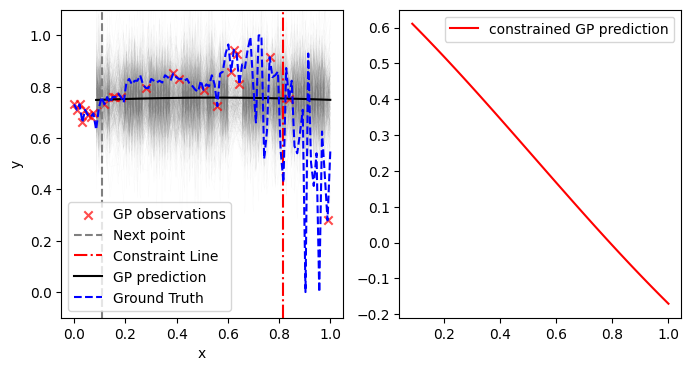

Step:16
Checking for ROI with potntial local optima
[ 0  1 16 21]
New potential region of interest found with prob= 0.40562805455203205
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:46<00:00,  2.46it/s, 1023 steps of size 1.83e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.31      4.04      4.00      1.01     10.64     72.00      1.00
    k_scale      0.24      0.18      0.19      0.07      0.44     58.18      1.01
      noise      0.02      0.01      0.02      0.01      0.04     90.34      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:23<00:00,  2.25it/s, 1023 steps of size 1.11e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      9.02      5.86      7.16      2.17     17.51     31.88      1.02
    k_scale      0.17      0.10      0.15      0.04      0.30     40.71      1.06
      noise      0.01      0.00      0.01      0.00      0.02     44.24      1.07



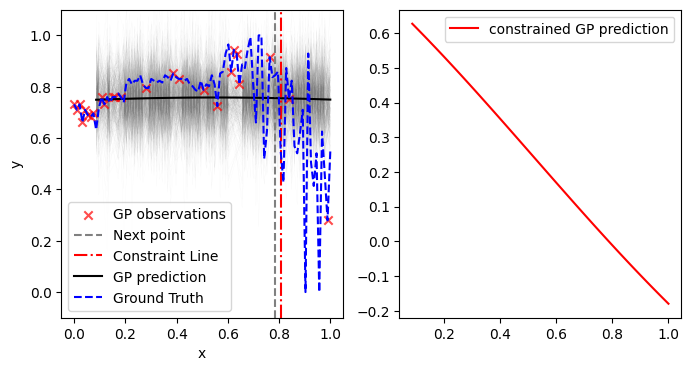

Step:17
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:29<00:00,  2.57it/s, 1023 steps of size 1.89e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.39      4.30      4.01      1.02     10.99     79.08      1.00
    k_scale      0.24      0.16      0.19      0.06      0.42     76.76      1.03
      noise      0.02      0.01      0.02      0.01      0.04     86.91      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:27<00:00,  2.23it/s, 1023 steps of size 1.04e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      8.96      5.17      7.38      1.99     16.53     28.62      1.01
    k_scale      0.16      0.09      0.14      0.05      0.29     39.72      1.03
      noise      0.01      0.00      0.01      0.00      0.01     39.11      1.07



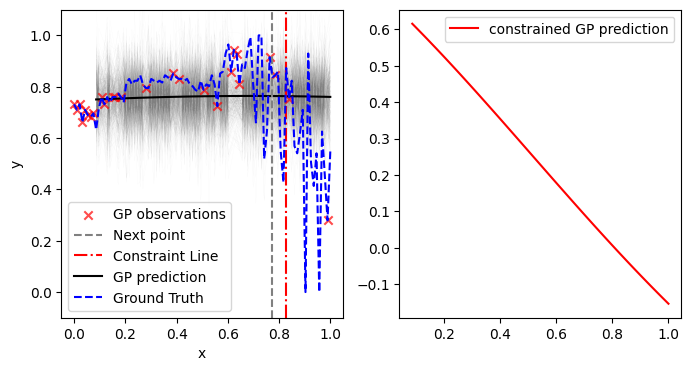

Step:18
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:49<00:00,  2.44it/s, 1023 steps of size 1.85e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.14      3.85      3.94      0.88     10.41     88.59      1.01
    k_scale      0.23      0.15      0.19      0.07      0.40     80.58      1.03
      noise      0.02      0.01      0.02      0.01      0.04     86.68      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:28<00:00,  2.23it/s, 1023 steps of size 1.06e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      8.81      4.79      7.43      2.39     16.03     27.54      1.00
    k_scale      0.16      0.09      0.14      0.04      0.26     38.92      1.02
      noise      0.01      0.00      0.01      0.00      0.01     41.74      1.06



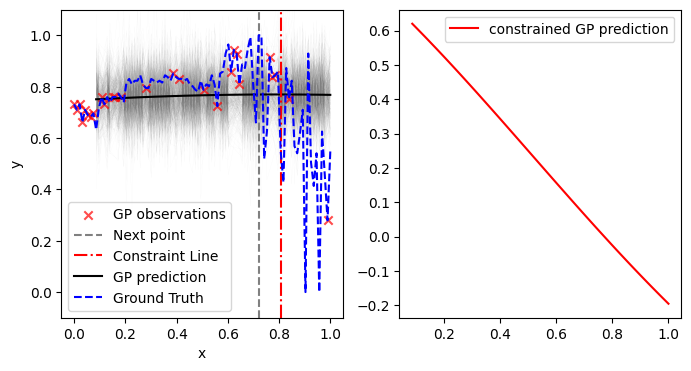

Step:19
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:50<00:00,  2.43it/s, 1023 steps of size 1.97e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.29      4.01      4.03      0.92     10.33     87.71      1.00
    k_scale      0.22      0.15      0.18      0.06      0.41     74.53      1.02
      noise      0.02      0.01      0.02      0.01      0.03     93.91      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:30<00:00,  2.22it/s, 1023 steps of size 1.29e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      8.84      5.10      7.37      2.49     15.79     34.07      1.02
    k_scale      0.16      0.09      0.14      0.04      0.27     49.04      1.04
      noise      0.01      0.00      0.01      0.00      0.01     46.28      1.06



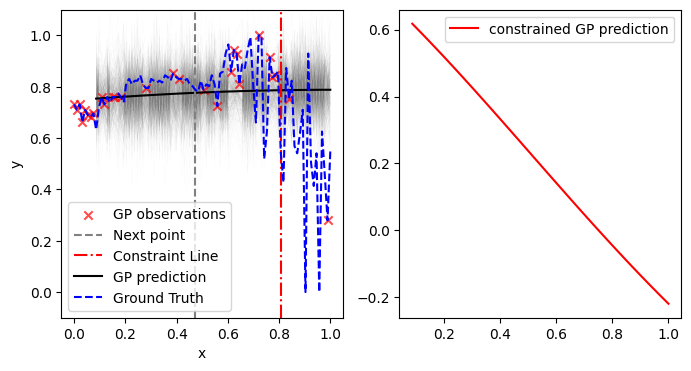

Step:20
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:00<00:00,  2.38it/s, 1023 steps of size 1.67e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.55      3.90      4.25      1.40     11.22     77.54      1.02
    k_scale      0.23      0.16      0.19      0.06      0.41     75.33      1.02
      noise      0.02      0.01      0.02      0.01      0.03     79.61      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:32<00:00,  2.21it/s, 1023 steps of size 1.18e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      8.65      4.51      7.42      2.20     15.30     27.23      1.02
    k_scale      0.15      0.08      0.14      0.05      0.26     38.04      1.04
      noise      0.01      0.00      0.01      0.00      0.01     46.46      1.04



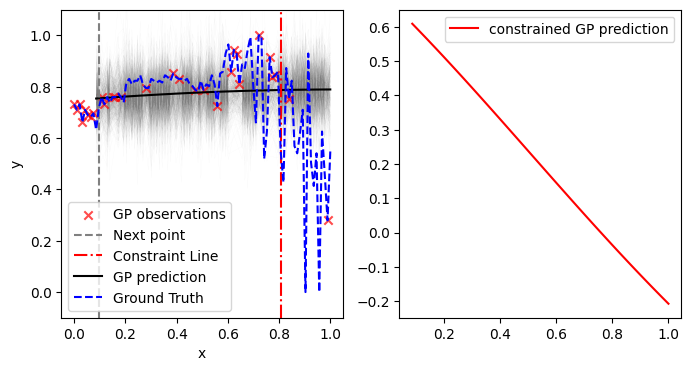

Step:21
Checking for ROI with potntial local optima
[ 0  1 16 21 26]
New potential region of interest found with prob= 0.8383933723862104
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:58<00:00,  2.39it/s, 1023 steps of size 1.84e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.45      3.88      4.25      1.35     11.23     79.76      1.01
    k_scale      0.22      0.16      0.18      0.06      0.40     78.35      1.02
      noise      0.02      0.01      0.02      0.01      0.03     85.10      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:37<00:00,  2.18it/s, 1023 steps of size 1.28e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      9.11      5.12      7.52      2.74     16.67     28.54      1.03
    k_scale      0.15      0.08      0.14      0.04      0.26     40.18      1.05
      noise      0.01      0.00      0.00      0.00      0.01     41.52      1.06



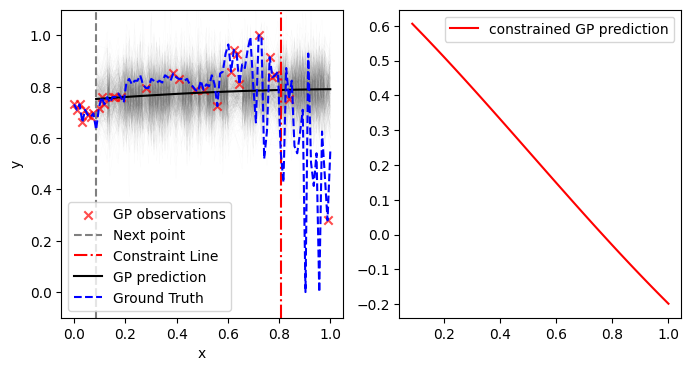

Step:22
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:04<00:00,  2.36it/s, 1023 steps of size 1.87e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.61      4.18      4.34      0.99     10.75     84.43      1.00
    k_scale      0.22      0.14      0.18      0.05      0.40     69.78      1.02
      noise      0.02      0.01      0.02      0.01      0.03     81.41      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:38<00:00,  2.18it/s, 1023 steps of size 1.25e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      9.14      5.10      7.67      2.77     16.61     29.46      1.03
    k_scale      0.16      0.08      0.14      0.04      0.26     41.46      1.05
      noise      0.01      0.00      0.00      0.00      0.01     39.91      1.06



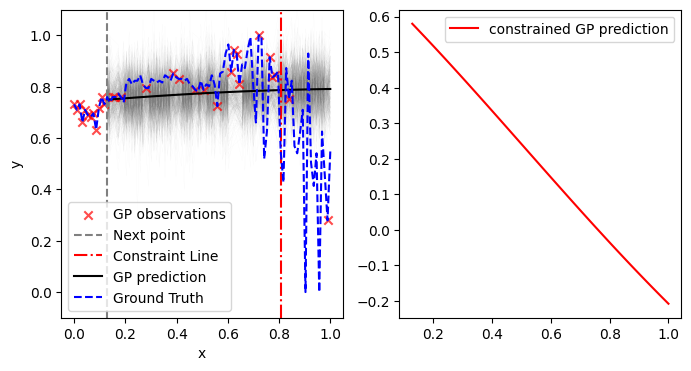

Step:23
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:34<00:00,  2.54it/s, 1023 steps of size 1.95e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.49      4.00      4.25      1.05     10.81     83.96      1.01
    k_scale      0.21      0.14      0.18      0.06      0.38     81.33      1.03
      noise      0.02      0.01      0.02      0.01      0.03     82.78      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:06<00:00,  2.34it/s, 1023 steps of size 1.29e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      9.48      5.61      7.67      2.88     18.11     32.03      1.04
    k_scale      0.16      0.09      0.14      0.03      0.27     45.52      1.06
      noise      0.00      0.00      0.00      0.00      0.01     51.66      1.05



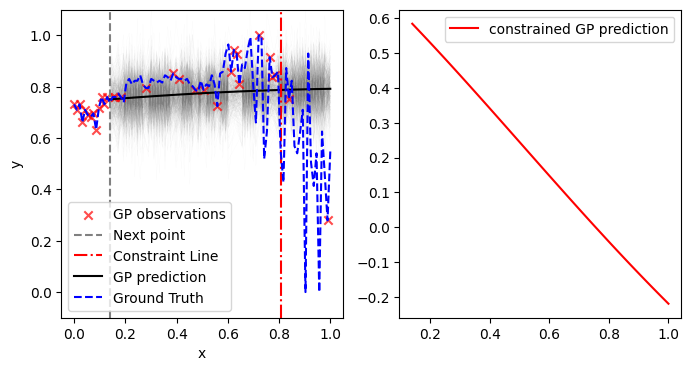

Step:24
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.38it/s, 7 steps of size 6.33e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.62      1.01      0.37      1.87    211.99      1.01
    k_scale      1.25      1.13      0.92      0.14      2.71    252.52      1.00
      noise      0.02      0.01      0.02      0.01      0.03    252.57      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 123.29it/s, 7 steps of size 5.37e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.57      0.16      0.55      0.33      0.83    308.47      1.00
    k_scale      1.00      1.01      0.73      0.12      1.93    279.33      1.00
      noise      0.00      0.00      0.00      0.00      0.01    323.65      1.00



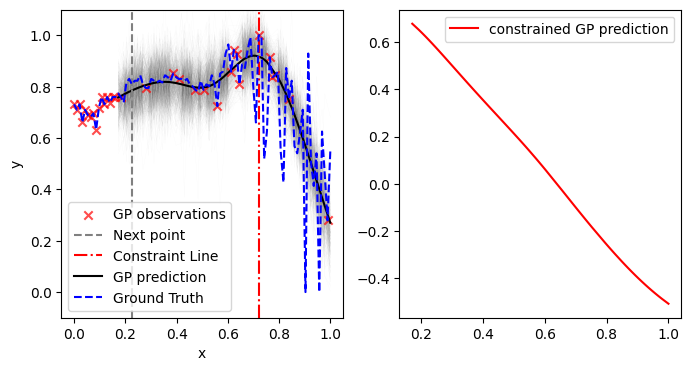

Step:25
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 126.66it/s, 3 steps of size 6.37e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.08      0.50      0.98      0.40      1.74    385.70      1.00
    k_scale      1.15      1.07      0.86      0.12      2.11    337.58      1.00
      noise      0.02      0.01      0.02      0.01      0.03    284.15      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 122.43it/s, 7 steps of size 5.37e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.59      0.17      0.55      0.35      0.81    292.21      1.00
    k_scale      1.07      0.99      0.74      0.17      2.10    242.94      1.00
      noise      0.00      0.00      0.00      0.00      0.01    293.00      1.00



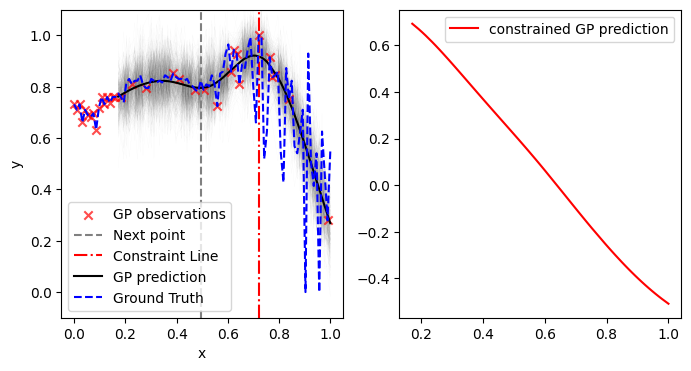

Step:26
Checking for ROI with potntial local optima
[ 0  1 16 21 26 30]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 131.59it/s, 7 steps of size 6.01e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.11      0.60      0.96      0.29      1.80    217.30      1.01
    k_scale      1.12      1.02      0.79      0.15      2.22    252.07      1.00
      noise      0.02      0.01      0.02      0.01      0.03    272.40      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.82it/s, 7 steps of size 5.90e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.57      0.16      0.56      0.34      0.81    336.13      1.00
    k_scale      0.94      0.81      0.71      0.08      1.86    321.51      1.00
      noise      0.00      0.00      0.00      0.00      0.01    192.70      1.01



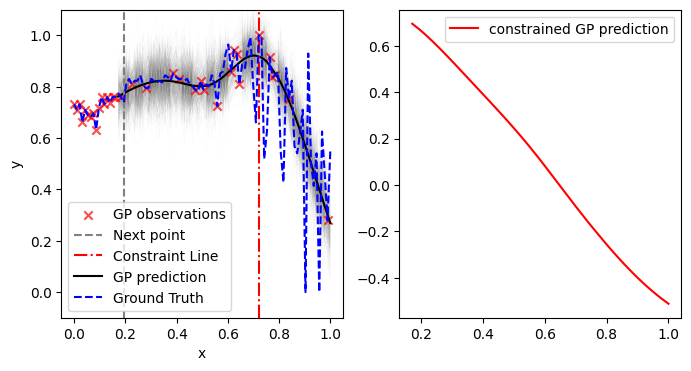

Step:27
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 132.08it/s, 3 steps of size 6.23e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.58      1.03      0.41      1.79    273.20      1.01
    k_scale      1.22      1.09      0.91      0.18      2.28    290.25      1.00
      noise      0.02      0.01      0.02      0.01      0.03    225.46      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 111.73it/s, 7 steps of size 5.93e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.59      0.17      0.56      0.37      0.82    285.88      1.00
    k_scale      0.99      0.83      0.73      0.19      2.05    220.63      1.00
      noise      0.00      0.00      0.00      0.00      0.00    291.58      1.01



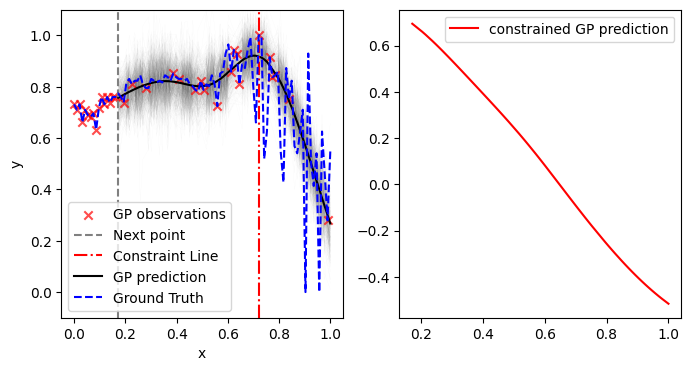

Step:28
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 129.31it/s, 7 steps of size 5.39e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.04      0.49      0.95      0.34      1.72    325.00      1.00
    k_scale      1.09      1.04      0.78      0.11      2.08    415.73      1.00
      noise      0.02      0.01      0.02      0.01      0.03    277.33      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 125.62it/s, 7 steps of size 5.47e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.57      0.15      0.55      0.35      0.81    266.20      1.00
    k_scale      0.90      0.64      0.73      0.14      1.71    295.80      1.00
      noise      0.00      0.00      0.00      0.00      0.00    229.83      1.00



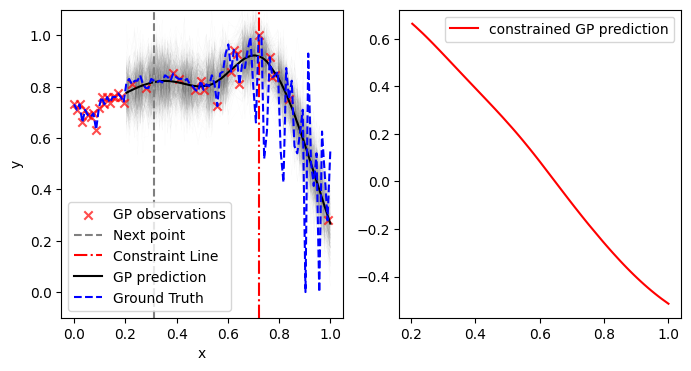

Step:29
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 130.86it/s, 7 steps of size 5.90e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.08      0.52      0.97      0.42      1.64    171.72      1.01
    k_scale      1.08      1.00      0.78      0.11      2.11    266.20      1.00
      noise      0.02      0.01      0.02      0.01      0.03    228.97      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 127.93it/s, 7 steps of size 5.29e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.58      0.16      0.55      0.37      0.82    271.54      1.00
    k_scale      1.02      0.89      0.69      0.19      2.15    223.84      1.00
      noise      0.00      0.00      0.00      0.00      0.00    196.92      1.00



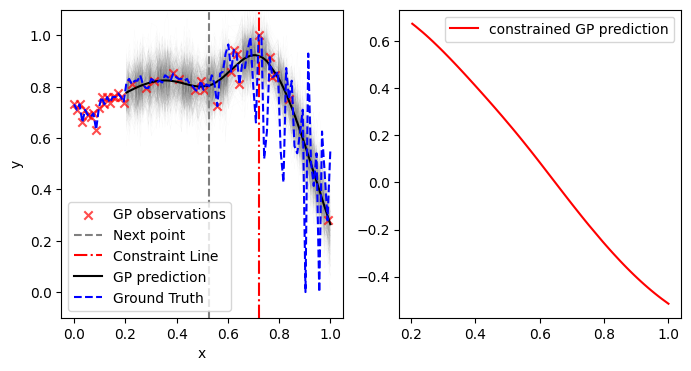

Step:30
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.78it/s, 3 steps of size 5.94e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.08      0.50      1.01      0.31      1.62    174.15      1.01
    k_scale      1.12      1.01      0.84      0.10      2.20    248.45      1.00
      noise      0.02      0.01      0.02      0.01      0.03    213.87      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 122.59it/s, 7 steps of size 5.37e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.57      0.14      0.54      0.35      0.77    202.44      1.00
    k_scale      0.95      0.77      0.72      0.14      1.91    259.79      1.00
      noise      0.00      0.00      0.00      0.00      0.00    268.22      1.01



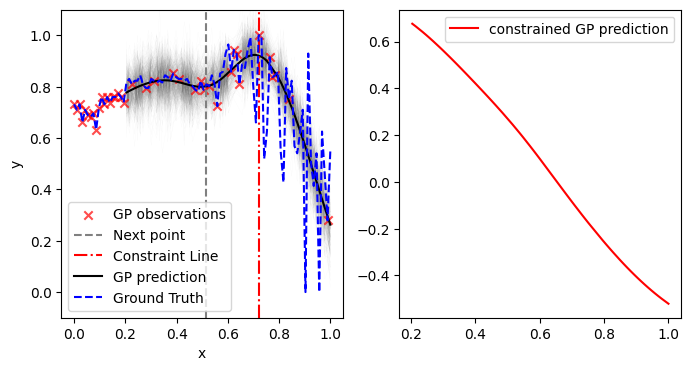

In [ ]:
N = 30
n = 5 # Check for best results
m = 0
X_test_norm = X_test
# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
y_train_inv = -y_train
best_x = X_train[np.argmax(y_train_inv)]
exp_x = [int(np.argmax(y_train_inv))]
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))
    # Checking criteria wheather we find a potential region of interest to exploit-- can be a local or global optima
    if m == n:
        best_x = X_train[exp_x[-1]]
        y_train_inv = -y_train
        m = 0

        if np.isin(exp_x, int(np.argmax(y_train_inv))).any()== True: #New potential region of interest found with low function values

            y_train_norm = (y_train_inv-np.min(y_train_inv))/(np.max(y_train_inv)-np.min(y_train_inv))
            best_y_norm = np.max(y_train_norm)
            # Need to provide normalized value of X and Y
            print("Checking for ROI with potntial local optima")
            exp_x = check_ROI(X_train, y_train_norm, best_x, best_y_norm, exp_x)
            best_x = X_train[exp_x[-1]]
        else:
            exp_x = np.hstack((exp_x, int(np.argmax(y_train_inv)))) #New potential ROI found with higher function values
            best_x = X_train[exp_x[-1]]
            print("New ROI with potential global optima found")

    m = m + 1

    # Execute contraint GP
    print("Running GP for constraint evaluation")
    cGP, constraint_mean, _= run_constrainGP(X_train, y_vote, X_test)
    c_val = np.min(np.absolute(constraint_mean))
    c_idx = np.argmin(np.absolute(constraint_mean))

    # Execute GP
    print("Running GP for function evaluation")
    test_data = [X_test, X_test_norm]
    cost_params = [best_x, exp_x, c_loc, c_glo, int(k[i-1])]
    gpbo, obj, posterior_mean, f_samples = run_statGP(X_train, y_train, test_data, constraint = constraint_mean, pen=1000, cost_params= cost_params)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].set_xlabel("x")
    ax[0].set_ylabel("y")
    ax[0].scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax[0].axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    ax[0].axvline(X[c_idx], linestyle = "-.", c = "r", label="Constraint Line")
    for y1 in f_samples:
      ax[0].plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax[0].plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax[0].plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax[0].plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax[0].legend();
    l.set_alpha(0)
    ax[0].set_ylim(-0.1, 1.1)

    ax[1].plot(X_test, constraint_mean, c='r', label='constrained GP prediction')
    ax[1].legend();
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)


    # Update distance metric for new X
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[-1] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)


    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[-1] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)

    y_vote = np.hstack((y_vote, (y_bad - y_good))) # Maximizing the target constraint



- Penalty =1

Step:1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 166.53it/s, 7 steps of size 5.55e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.70      0.98      0.25      1.91    402.04      1.00
    k_scale      0.99      1.06      0.67      0.08      2.08    307.22      1.00
      noise      0.07      0.07      0.04      0.00      0.14    294.75      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 174.45it/s, 7 steps of size 6.13e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.29      2.37      1.60      0.35      4.50    272.02      1.01
    k_scale      0.92      0.92      0.67      0.06      1.82    366.18      1.02
      noise      0.09      0.06      0.07      0.01      0.16    347.84      1.00



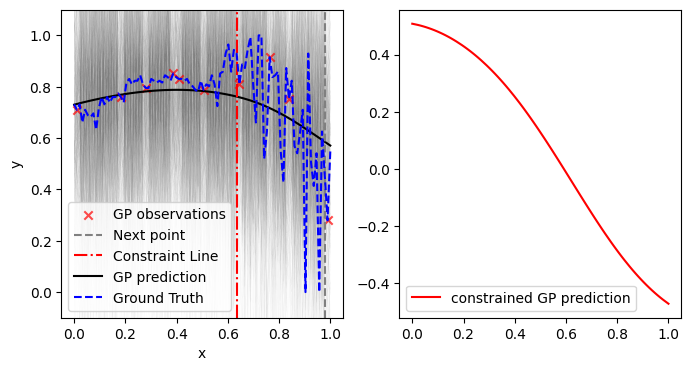

Step:2
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 154.71it/s, 7 steps of size 6.22e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.31      0.93      1.09      0.33      2.23    177.77      1.00
    k_scale      1.15      1.22      0.77      0.06      2.45    229.09      1.00
      noise      0.06      0.06      0.04      0.01      0.12    177.71      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.96it/s, 7 steps of size 6.65e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.49      3.93      1.51      0.19      4.75    150.22      1.00
    k_scale      1.00      1.10      0.66      0.06      2.08    321.01      1.00
      noise      0.07      0.06      0.06      0.01      0.15    289.01      1.00



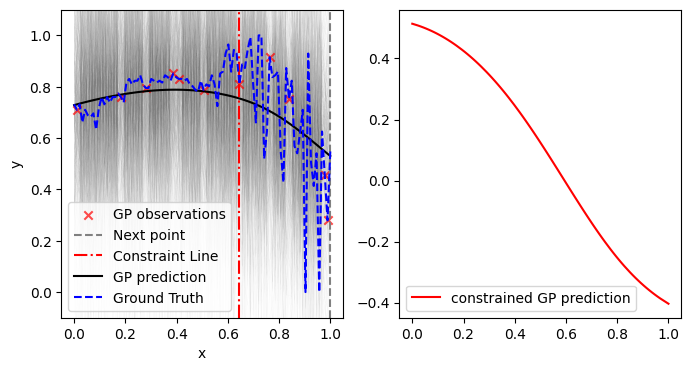

Step:3
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.36it/s, 3 steps of size 5.92e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.65      0.99      0.26      1.98    321.40      1.00
    k_scale      0.91      0.84      0.66      0.09      1.88    261.68      1.00
      noise      0.05      0.04      0.03      0.01      0.09    277.30      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 165.68it/s, 7 steps of size 6.40e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.98      1.69      1.44      0.26      3.95    272.21      1.00
    k_scale      0.98      1.05      0.67      0.10      1.95    341.28      1.00
      noise      0.06      0.04      0.05      0.01      0.11    256.86      1.00



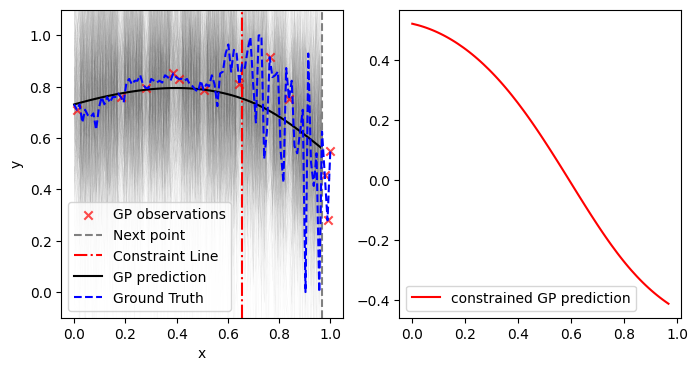

Step:4
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.47it/s, 7 steps of size 5.80e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.15      0.66      0.99      0.27      1.91    297.45      1.00
    k_scale      0.98      0.92      0.71      0.08      2.07    322.73      1.00
      noise      0.04      0.03      0.03      0.01      0.07    224.20      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 149.63it/s, 7 steps of size 6.90e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.91      1.61      1.43      0.32      3.40    306.71      1.00
    k_scale      0.99      1.06      0.66      0.10      2.07    244.85      1.00
      noise      0.05      0.04      0.04      0.01      0.10    286.74      1.00



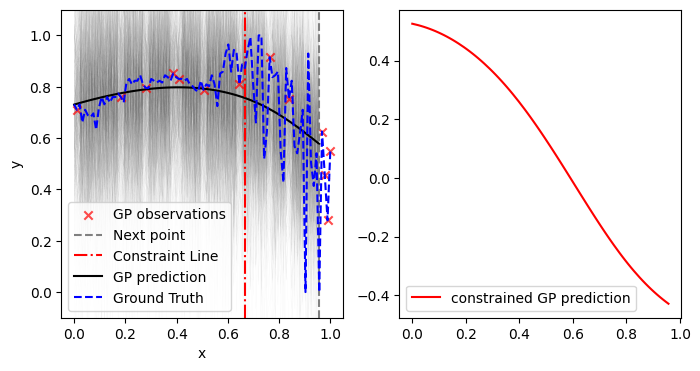

Step:5
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.95it/s, 7 steps of size 5.50e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.05      0.51      0.95      0.30      1.75    328.37      1.00
    k_scale      0.84      0.72      0.62      0.10      1.68    378.97      1.00
      noise      0.03      0.02      0.02      0.01      0.05    233.90      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.21it/s, 7 steps of size 6.44e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.12      3.23      1.43      0.38      3.70    147.26      1.00
    k_scale      1.03      1.02      0.71      0.06      2.15    329.36      1.01
      noise      0.09      0.05      0.08      0.03      0.16    270.92      1.00



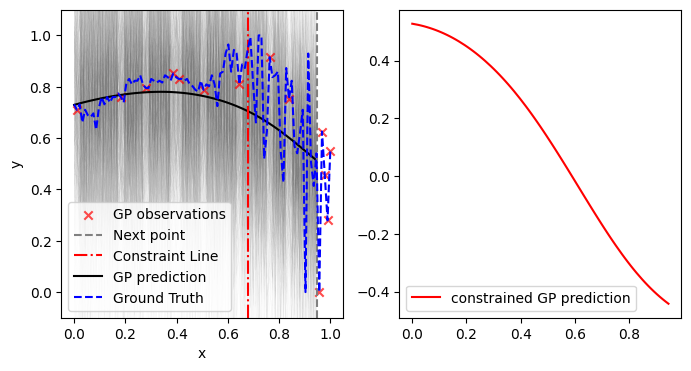

Step:6
New ROI with potential global optima found
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 157.85it/s, 7 steps of size 6.09e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.03      0.46      0.94      0.46      1.80    337.35      1.00
    k_scale      0.86      0.83      0.62      0.07      1.68    406.06      1.00
      noise      0.02      0.02      0.02      0.01      0.04    317.54      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 166.74it/s, 3 steps of size 7.35e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.70      1.39      1.29      0.33      3.10    437.97      1.00
    k_scale      0.94      0.84      0.71      0.06      1.85    357.00      1.01
      noise      0.08      0.04      0.07      0.02      0.13    312.48      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


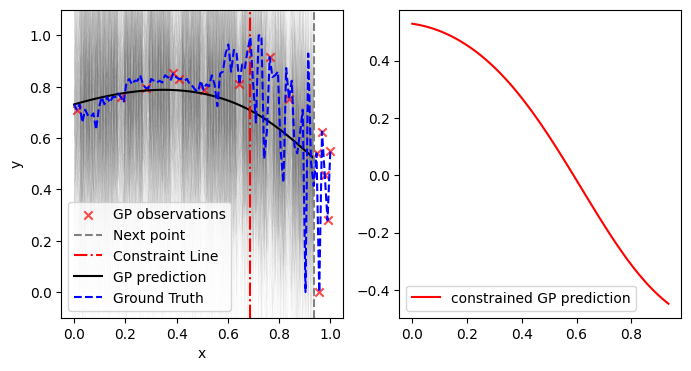

Step:7
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 155.02it/s, 7 steps of size 5.65e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.07      0.53      0.95      0.32      1.68    373.35      1.00
    k_scale      0.94      0.90      0.66      0.13      2.17    360.44      1.00
      noise      0.02      0.01      0.02      0.01      0.04    206.71      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 167.63it/s, 7 steps of size 7.54e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.71      1.49      1.33      0.31      2.80    345.46      1.00
    k_scale      1.09      1.12      0.73      0.10      2.40    333.63      1.00
      noise      0.07      0.04      0.06      0.03      0.12    247.40      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


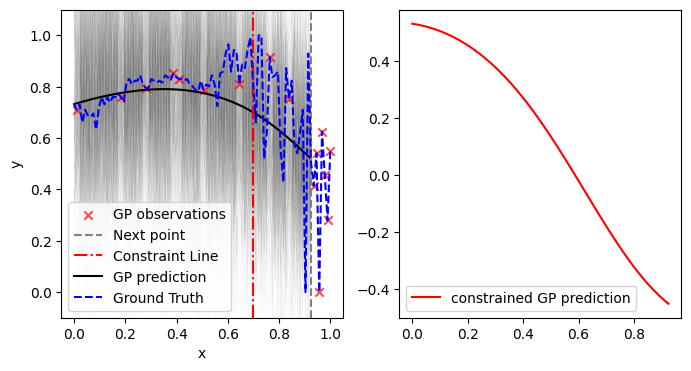

Step:8
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 144.17it/s, 7 steps of size 5.80e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.04      0.47      0.94      0.35      1.66    407.02      1.00
    k_scale      1.03      1.09      0.68      0.09      2.13    360.28      1.00
      noise      0.02      0.01      0.02      0.00      0.03    327.88      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 152.81it/s, 7 steps of size 7.64e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.65      1.30      1.26      0.21      3.02    449.80      1.00
    k_scale      0.96      0.84      0.69      0.13      2.05    370.31      1.00
      noise      0.06      0.03      0.05      0.02      0.10    227.06      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


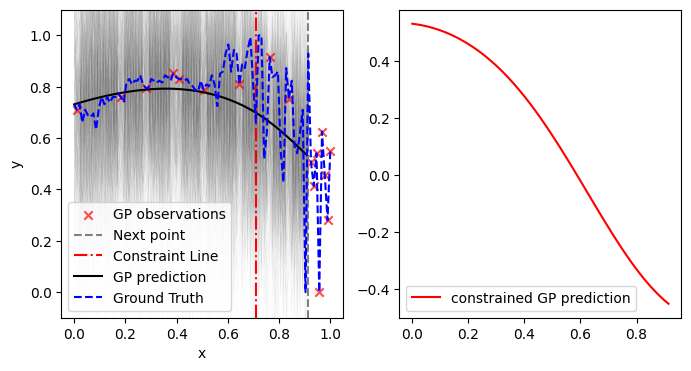

Step:9
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 142.85it/s, 7 steps of size 5.46e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.00      0.47      0.90      0.32      1.60    363.83      1.00
    k_scale      0.89      0.84      0.63      0.13      1.86    338.91      1.00
      noise      0.02      0.01      0.01      0.01      0.03    210.44      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 156.81it/s, 7 steps of size 7.03e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.99      2.64      1.42      0.35      3.39    146.74      1.00
    k_scale      1.09      1.08      0.76      0.06      2.22    299.31      1.00
      noise      0.07      0.03      0.07      0.03      0.13    260.11      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


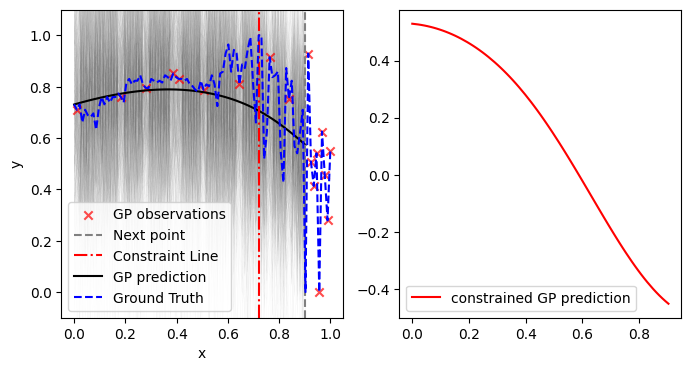

Step:10
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.81it/s, 7 steps of size 5.52e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.96      0.43      0.87      0.41      1.54    269.63      1.00
    k_scale      0.91      0.87      0.62      0.13      2.02    303.54      1.01
      noise      0.01      0.01      0.01      0.00      0.03    245.64      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 153.52it/s, 3 steps of size 7.41e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.82      1.64      1.38      0.34      3.31    493.60      1.00
    k_scale      0.96      0.93      0.69      0.05      1.95    363.62      1.00
      noise      0.09      0.04      0.08      0.04      0.15    268.63      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


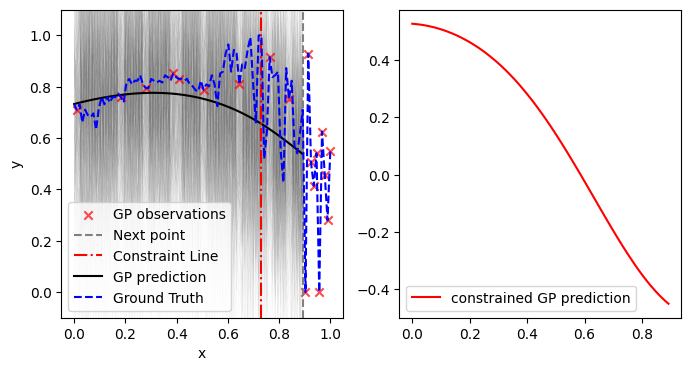

Step:11
Checking for ROI with potntial local optima
[ 0 13 18]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 139.23it/s, 7 steps of size 5.58e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.91      0.40      0.85      0.39      1.40    297.35      1.00
    k_scale      0.86      0.85      0.60      0.06      1.74    343.08      1.00
      noise      0.01      0.01      0.01      0.00      0.02    223.04      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 154.87it/s, 7 steps of size 7.37e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.85      1.62      1.45      0.35      3.45    283.81      1.00
    k_scale      1.04      1.14      0.69      0.07      2.16    212.66      1.02
      noise      0.09      0.04      0.08      0.04      0.14    266.08      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


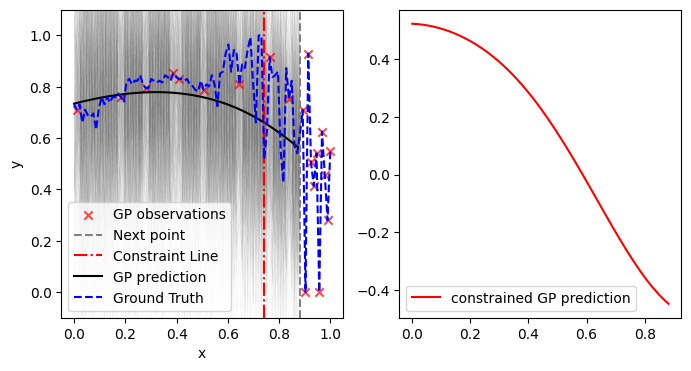

Step:12
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.02it/s, 7 steps of size 5.79e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.90      0.39      0.84      0.40      1.38    300.21      1.00
    k_scale      0.87      0.86      0.60      0.07      1.63    296.74      1.00
      noise      0.01      0.01      0.01      0.00      0.02    344.38      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 156.27it/s, 3 steps of size 7.94e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.72      1.35      1.38      0.35      2.95    361.21      1.00
    k_scale      1.00      0.95      0.69      0.08      2.11    380.58      1.00
      noise      0.08      0.03      0.07      0.04      0.13    288.11      1.01



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


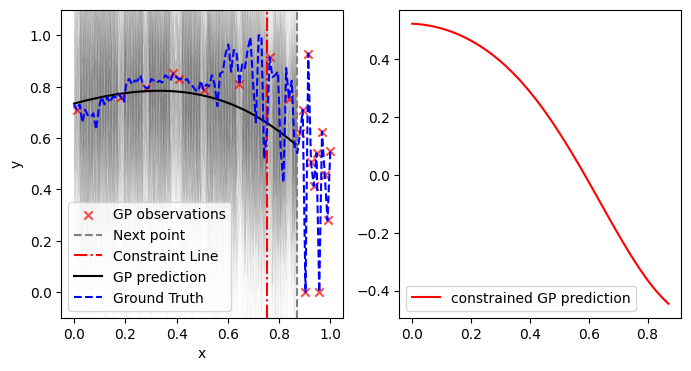

Step:13
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 144.36it/s, 7 steps of size 5.39e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.85      0.33      0.79      0.35      1.22    344.98      1.00
    k_scale      0.82      0.75      0.59      0.12      1.65    336.09      1.00
      noise      0.01      0.01      0.01      0.00      0.02    283.14      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.20it/s, 7 steps of size 6.04e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.99      2.88      1.42      0.37      3.36    158.32      1.00
    k_scale      1.03      1.08      0.69      0.08      2.24    332.84      1.00
      noise      0.08      0.03      0.07      0.04      0.12    349.12      1.00



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


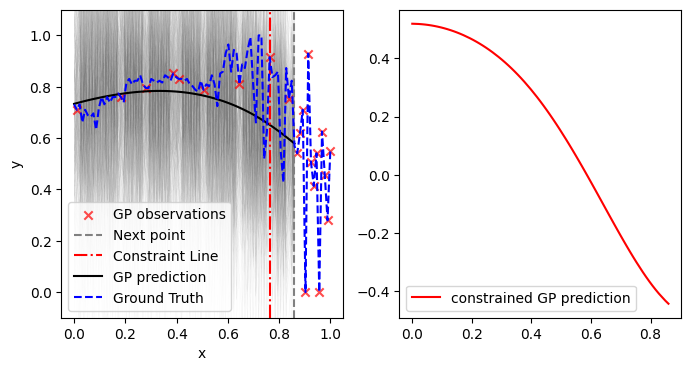

Step:14
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.13it/s, 7 steps of size 5.67e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.82      0.33      0.76      0.32      1.23    303.31      1.00
    k_scale      0.79      0.73      0.56      0.10      1.59    328.20      1.00
      noise      0.01      0.00      0.01      0.00      0.01    233.27      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 152.18it/s, 7 steps of size 7.04e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.71      1.35      1.41      0.39      2.91    376.89      1.00
    k_scale      1.06      1.04      0.76      0.06      2.17    289.92      1.00
      noise      0.07      0.03      0.06      0.04      0.11    323.56      1.01



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


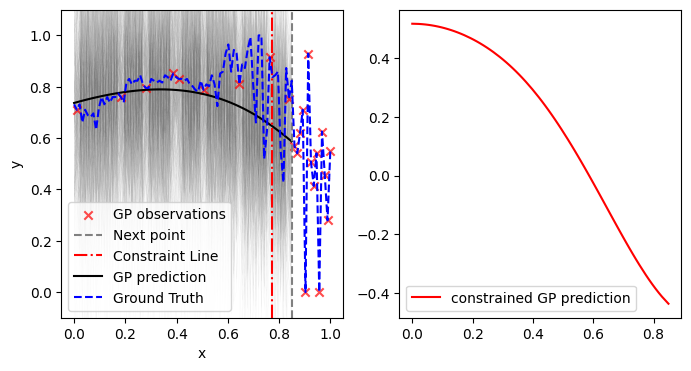

Step:15
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:24<00:00,  2.60it/s, 1023 steps of size 1.88e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.03      5.36      5.30      1.32     13.91     58.81      1.00
    k_scale      0.18      0.13      0.14      0.05      0.32     52.55      1.00
      noise      0.01      0.01      0.01      0.00      0.02    109.00      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:07<00:00,  2.34it/s, 1023 steps of size 1.25e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.25      4.91      4.93      1.11     11.66     57.79      1.00
    k_scale      0.25      0.16      0.20      0.04      0.45     39.43      1.06
      noise      0.07      0.03      0.07      0.04      0.11     62.03      1.07



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


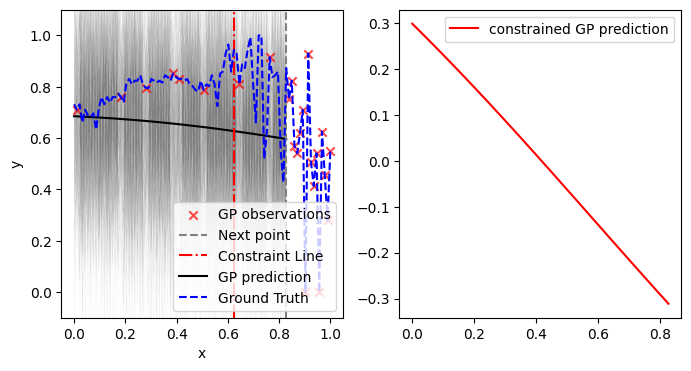

Step:16
Checking for ROI with potntial local optima
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:01<00:00,  2.37it/s, 1023 steps of size 1.76e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.85      4.67      5.29      1.67     13.77     52.00      1.00
    k_scale      0.17      0.13      0.14      0.03      0.31     61.29      1.02
      noise      0.01      0.01      0.01      0.00      0.02     77.47      1.05

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [06:57<00:00,  2.39it/s, 1023 steps of size 1.23e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.22      4.74      4.87      0.96     11.86     55.32      1.01
    k_scale      0.25      0.16      0.20      0.04      0.45     41.49      1.06
      noise      0.07      0.02      0.07      0.03      0.10     55.82      1.07



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


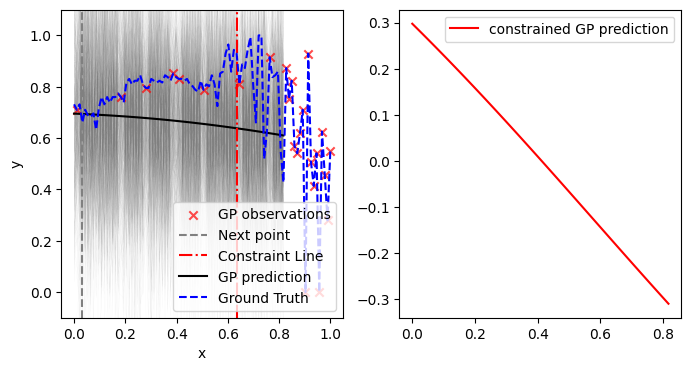

Step:17
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:47<00:00,  2.45it/s, 1023 steps of size 1.52e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.95      4.51      5.36      1.59     14.17     35.72      1.01
    k_scale      0.16      0.12      0.13      0.03      0.29     58.70      1.03
      noise      0.01      0.00      0.01      0.00      0.02     65.46      1.06

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:05<00:00,  2.35it/s, 1023 steps of size 1.11e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.53      5.03      5.19      1.12     13.34     43.73      1.01
    k_scale      0.25      0.16      0.20      0.04      0.47     28.90      1.08
      noise      0.07      0.02      0.06      0.03      0.10     50.66      1.09



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


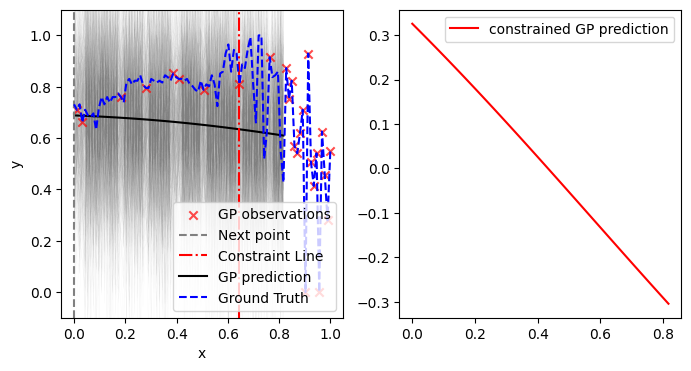

Step:18
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:03<00:00,  2.36it/s, 1023 steps of size 1.56e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.75      4.33      5.32      1.69     13.44     54.76      1.02
    k_scale      0.18      0.13      0.15      0.04      0.33     71.66      1.04
      noise      0.01      0.01      0.01      0.00      0.02     68.30      1.03

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:10<00:00,  2.32it/s, 1023 steps of size 1.20e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.64      5.02      5.24      0.80     12.69     50.40      1.01
    k_scale      0.24      0.15      0.20      0.05      0.46     34.88      1.07
      noise      0.06      0.02      0.06      0.03      0.09     48.37      1.10



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


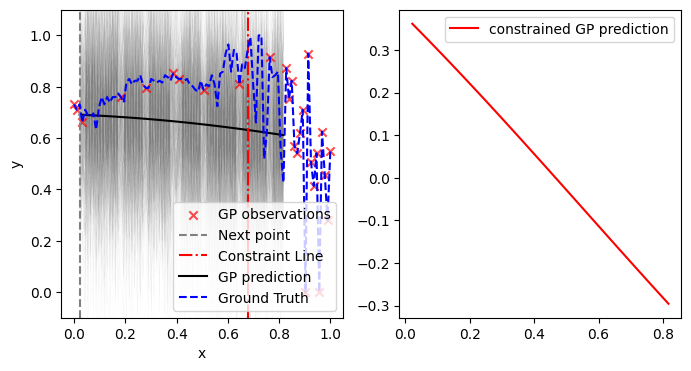

Step:19
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:50<00:00,  2.43it/s, 1023 steps of size 1.43e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.15      4.01      4.79      1.59     12.01     65.12      1.00
    k_scale      0.19      0.14      0.15      0.05      0.35     77.28      1.01
      noise      0.02      0.01      0.01      0.01      0.03     61.80      1.05

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:27<00:00,  2.23it/s, 1023 steps of size 1.11e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.80      5.28      5.31      1.15     13.95     38.32      1.01
    k_scale      0.24      0.15      0.19      0.04      0.46     26.80      1.08
      noise      0.06      0.02      0.06      0.03      0.09     48.42      1.09



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


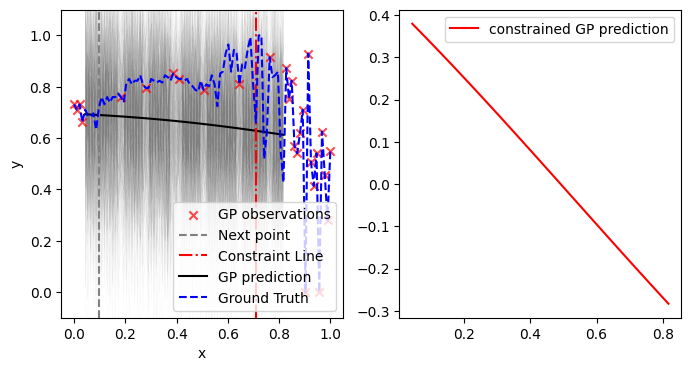

Step:20
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:39<00:00,  2.51it/s, 1023 steps of size 1.65e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.58      4.86      4.92      1.54     13.46     62.08      1.01
    k_scale      0.21      0.16      0.17      0.06      0.39     59.37      1.02
      noise      0.02      0.01      0.02      0.01      0.03     75.43      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:19<00:00,  2.28it/s, 1023 steps of size 1.10e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.00      5.26      5.55      0.81     13.20     48.94      1.01
    k_scale      0.23      0.14      0.19      0.05      0.43     39.55      1.06
      noise      0.06      0.02      0.05      0.03      0.08     50.36      1.08



<ipython-input-19-def33f35c924>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


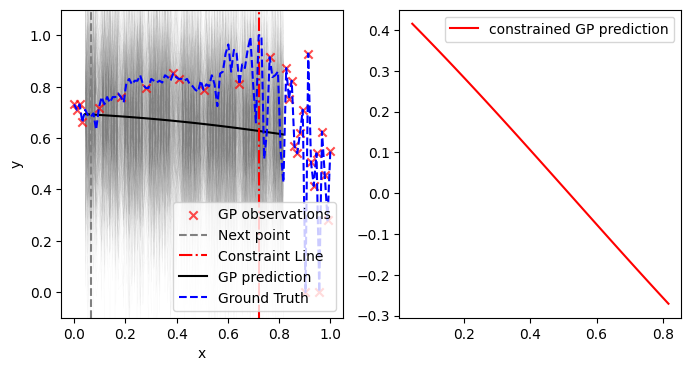

Step:21
Checking for ROI with potntial local optima
[ 0 13 18 25]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:43<00:00,  2.48it/s, 1023 steps of size 1.68e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.98      3.96      4.63      1.59     11.89     68.22      1.01
    k_scale      0.20      0.15      0.16      0.05      0.38     69.20      1.02
      noise      0.02      0.01      0.02      0.01      0.03     86.16      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:21<00:00,  2.27it/s, 1023 steps of size 1.19e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.15      5.35      5.52      1.12     13.76     42.47      1.00
    k_scale      0.22      0.14      0.18      0.04      0.41     39.20      1.05
      noise      0.05      0.02      0.05      0.03      0.08     58.97      1.07



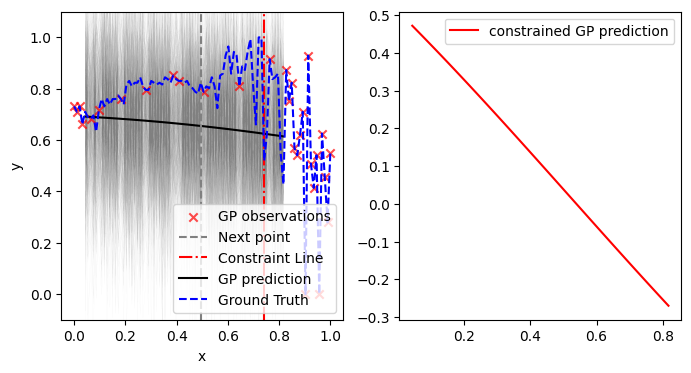

Step:22
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:53<00:00,  2.42it/s, 1023 steps of size 1.98e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.66      4.21      4.40      1.09     10.86     86.08      1.00
    k_scale      0.21      0.14      0.17      0.06      0.38     76.97      1.01
      noise      0.02      0.01      0.02      0.01      0.03     90.04      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:30<00:00,  2.22it/s, 1023 steps of size 1.25e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.32      5.44      5.66      1.16     13.88     40.69      1.00
    k_scale      0.22      0.14      0.18      0.03      0.40     38.15      1.06
      noise      0.05      0.02      0.05      0.03      0.08     56.54      1.07



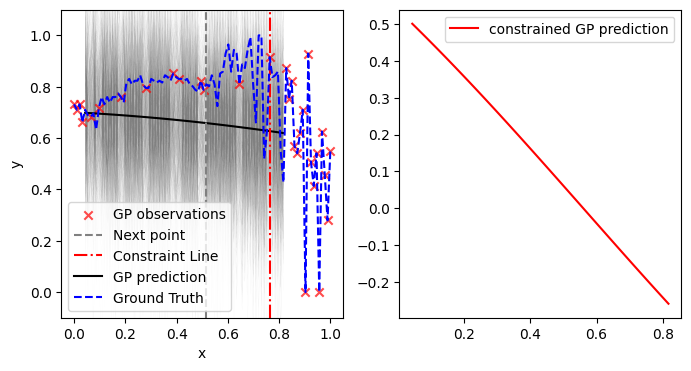

Step:23
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:31<00:00,  2.55it/s, 1023 steps of size 1.86e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.73      4.03      4.39      1.45     11.51     68.76      1.00
    k_scale      0.21      0.15      0.17      0.06      0.38     56.44      1.01
      noise      0.02      0.01      0.02      0.01      0.03     89.61      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:02<00:00,  2.37it/s, 1023 steps of size 1.12e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.46      5.62      5.63      1.37     14.81     37.63      1.00
    k_scale      0.21      0.13      0.18      0.03      0.39     30.01      1.05
      noise      0.05      0.01      0.05      0.03      0.07     45.89      1.09



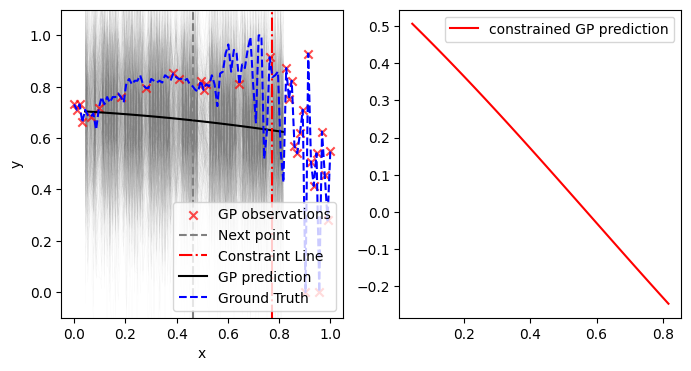

Step:24
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 116.49it/s, 7 steps of size 6.56e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.67      0.32      0.60      0.25      1.03    364.38      1.00
    k_scale      0.90      0.83      0.64      0.11      2.02    255.75      1.00
      noise      0.02      0.01      0.02      0.01      0.03    308.99      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.16it/s, 7 steps of size 7.29e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.33      0.98      1.20      0.33      1.94    251.36      1.00
    k_scale      0.93      0.88      0.66      0.12      1.85    407.50      1.00
      noise      0.05      0.01      0.04      0.03      0.07    249.74      1.00



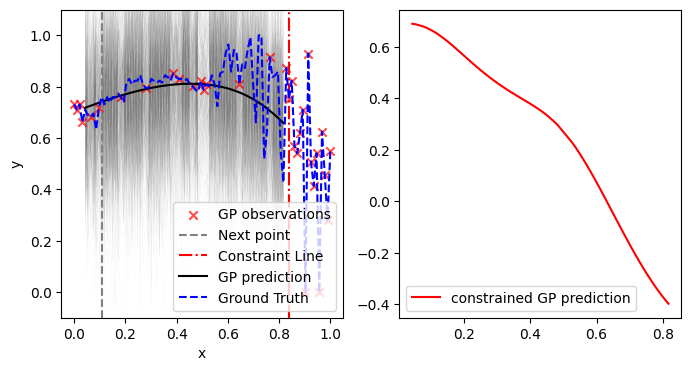

Step:25
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 132.50it/s, 7 steps of size 6.81e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.72      0.38      0.63      0.28      1.15    201.19      1.00
    k_scale      0.88      0.81      0.65      0.09      1.69    272.71      1.00
      noise      0.02      0.01      0.02      0.01      0.03    300.74      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.71it/s, 7 steps of size 6.75e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.55      2.00      1.19      0.34      2.25    130.36      1.00
    k_scale      1.01      0.99      0.70      0.08      2.09    185.69      1.01
      noise      0.04      0.01      0.04      0.02      0.06    297.12      1.00



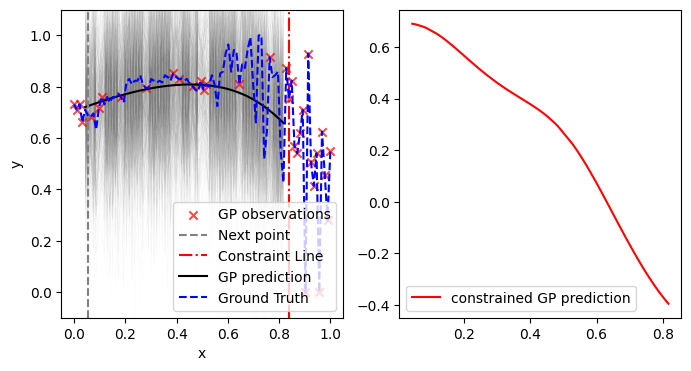

Step:26
Checking for ROI with potntial local optima
[ 0 13 18 25 32]
New potential region of interest found with prob= 0.5669896021119041
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 135.45it/s, 7 steps of size 5.21e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.68      0.33      0.60      0.27      1.05    291.53      1.00
    k_scale      0.88      0.84      0.61      0.09      1.74    217.84      1.00
      noise      0.02      0.01      0.02      0.01      0.03    289.57      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 141.49it/s, 7 steps of size 6.73e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.28      0.71      1.17      0.39      2.02    378.90      1.00
    k_scale      1.04      1.09      0.70      0.09      2.14    315.34      1.00
      noise      0.04      0.01      0.04      0.02      0.06    282.02      1.00



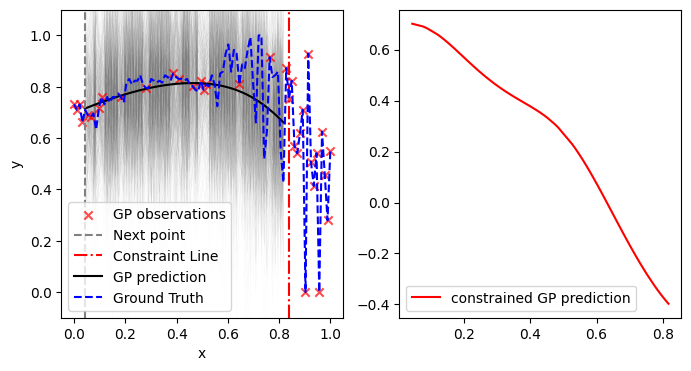

Step:27
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.31it/s, 7 steps of size 6.14e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.66      0.34      0.57      0.25      1.09    319.80      1.00
    k_scale      0.83      0.79      0.60      0.06      1.58    308.73      1.00
      noise      0.02      0.01      0.02      0.01      0.03    269.82      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.48it/s, 7 steps of size 6.25e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.33      1.03      1.13      0.45      2.13    229.52      1.00
    k_scale      1.00      1.03      0.68      0.10      2.00    330.09      1.00
      noise      0.04      0.01      0.04      0.02      0.06    245.39      1.00



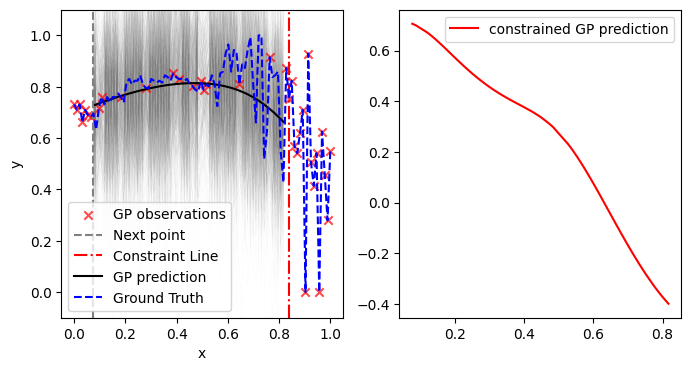

Step:28
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 129.84it/s, 7 steps of size 6.14e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.65      0.33      0.57      0.24      1.09    278.92      1.00
    k_scale      0.86      0.82      0.61      0.09      1.63    276.11      1.00
      noise      0.02      0.01      0.02      0.01      0.03    297.34      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.38it/s, 7 steps of size 6.51e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.24      0.76      1.09      0.36      1.87    478.91      1.00
    k_scale      0.98      0.90      0.71      0.15      1.97    347.59      1.00
      noise      0.04      0.01      0.04      0.02      0.05    398.58      1.00



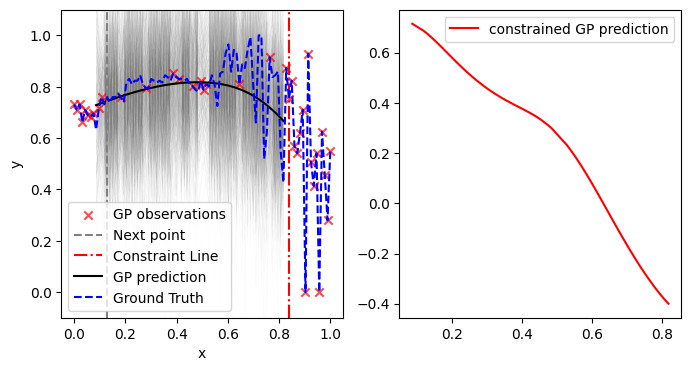

Step:29
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.29it/s, 7 steps of size 5.48e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.63      0.30      0.56      0.24      1.00    233.92      1.00
    k_scale      0.85      0.90      0.60      0.12      1.74    291.54      1.00
      noise      0.02      0.01      0.02      0.01      0.03    314.94      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 140.26it/s, 7 steps of size 6.96e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.25      0.68      1.14      0.42      1.86    404.54      1.00
    k_scale      1.03      0.93      0.74      0.11      2.09    278.58      1.00
      noise      0.04      0.01      0.04      0.02      0.06    360.48      1.00



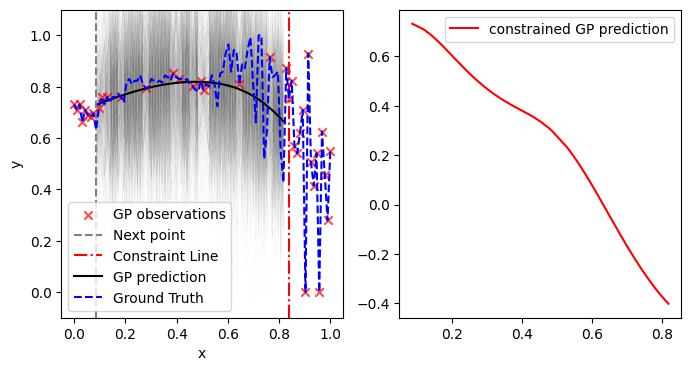

Step:30
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 127.43it/s, 7 steps of size 5.31e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.62      0.32      0.54      0.19      1.00    255.64      1.00
    k_scale      0.82      0.71      0.61      0.10      1.64    335.25      1.00
      noise      0.02      0.01      0.02      0.01      0.03    276.86      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 136.69it/s, 7 steps of size 5.96e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.16      0.62      1.06      0.42      1.81    534.59      1.00
    k_scale      0.94      1.01      0.67      0.13      1.84    386.83      1.00
      noise      0.04      0.01      0.03      0.02      0.05    337.62      1.00



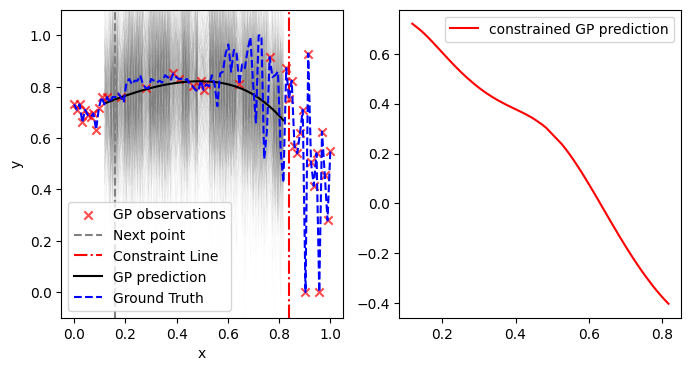

In [ ]:
N = 30
n = 5 # Check for best results
m = 0
X_test_norm = X_test
# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
y_train_inv = -y_train
best_x = X_train[np.argmax(y_train_inv)]
exp_x = [int(np.argmax(y_train_inv))]
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))
    # Checking criteria wheather we find a potential region of interest to exploit-- can be a local or global optima
    if m == n:
        best_x = X_train[exp_x[-1]]
        y_train_inv = -y_train
        m = 0

        if np.isin(exp_x, int(np.argmax(y_train_inv))).any()== True: #New potential region of interest found with low function values

            y_train_norm = (y_train_inv-np.min(y_train_inv))/(np.max(y_train_inv)-np.min(y_train_inv))
            best_y_norm = np.max(y_train_norm)
            # Need to provide normalized value of X and Y
            print("Checking for ROI with potntial local optima")
            exp_x = check_ROI(X_train, y_train_norm, best_x, best_y_norm, exp_x)
            best_x = X_train[exp_x[-1]]
        else:
            exp_x = np.hstack((exp_x, int(np.argmax(y_train_inv)))) #New potential ROI found with higher function values
            best_x = X_train[exp_x[-1]]
            print("New ROI with potential global optima found")

    m = m + 1

    # Execute contraint GP
    print("Running GP for constraint evaluation")
    cGP, constraint_mean, _= run_constrainGP(X_train, y_vote, X_test)
    c_val = np.min(np.absolute(constraint_mean))
    c_idx = np.argmin(np.absolute(constraint_mean))

    # Execute GP
    print("Running GP for function evaluation")
    test_data = [X_test, X_test_norm]
    cost_params = [best_x, exp_x, c_loc, c_glo, int(k[i-1])]
    gpbo, obj, posterior_mean, f_samples = run_statGP(X_train, y_train, test_data, constraint = constraint_mean, pen=1, cost_params= cost_params)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].set_xlabel("x")
    ax[0].set_ylabel("y")
    ax[0].scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax[0].axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    ax[0].axvline(X[c_idx], linestyle = "-.", c = "r", label="Constraint Line")
    for y1 in f_samples:
      ax[0].plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax[0].plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax[0].plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax[0].plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax[0].legend();
    l.set_alpha(0)
    ax[0].set_ylim(-0.1, 1.1)

    ax[1].plot(X_test, constraint_mean, c='r', label='constrained GP prediction')
    ax[1].legend();
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)


    # Update distance metric for new X
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[-1] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)


    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[-1] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)

    y_vote = np.hstack((y_vote, (y_bad - y_good))) # Maximizing the target constraint



# Case 2- Off voltage coercive

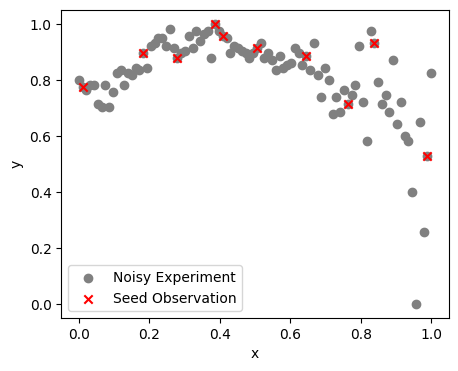

In [ ]:
# Select random initial points
init_points = 10 # number of initial points

def norm_(data):
  return (data - np.min(data)) / (np.max(data) - np.min(data))

# Select Experiment Data
X = norm_(np.asarray(x_composition))
y = norm_(np.asarray(y_coercive[0]))

# Full dataset
#X = jnp.asarray(X)
#y = jnp.asarray(y)
#X = norm_(X)
#y = norm_(y)

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, y, num_seed_points=init_points, rng_seed=10)

# Plot initial train dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, y, label = "Noisy Experiment", color = "Gray")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()


# Strategic BO

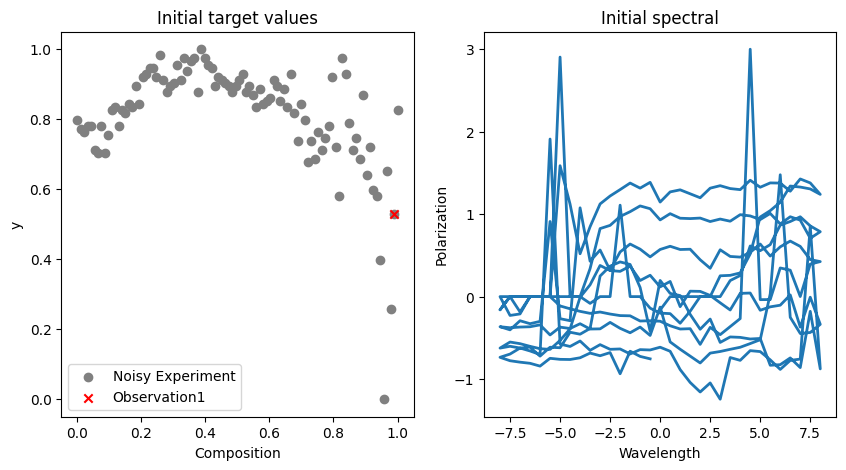

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


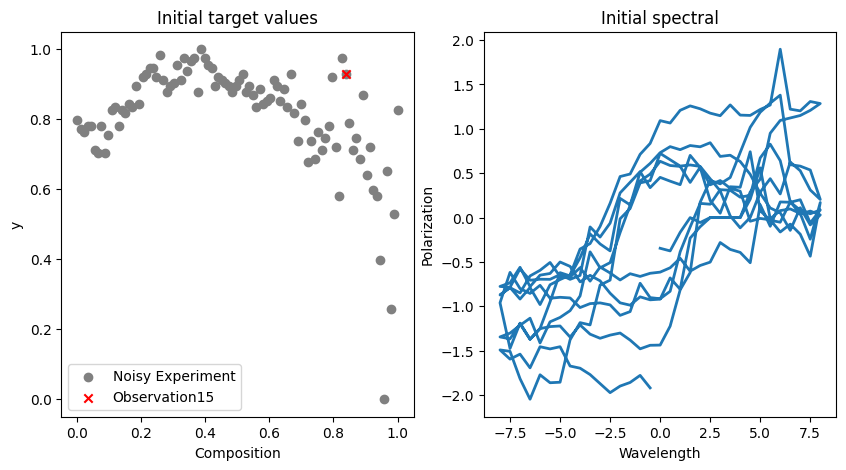

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


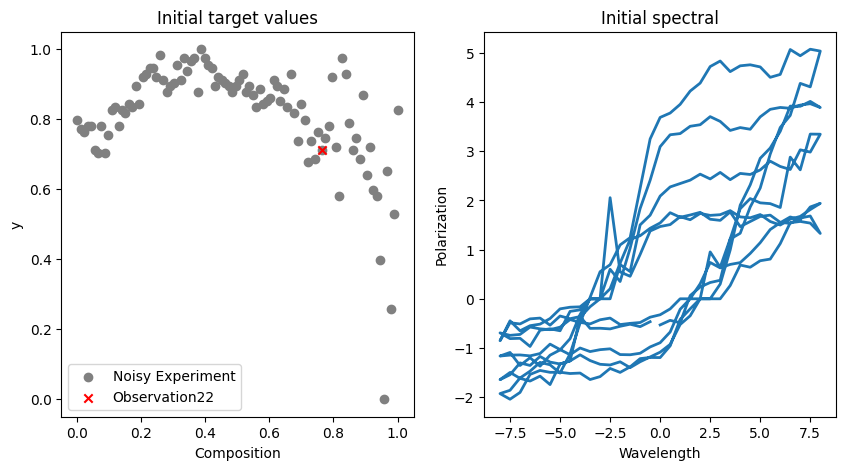

Is the current spectral good? y- Yes or press ENTER- No
Answer: 


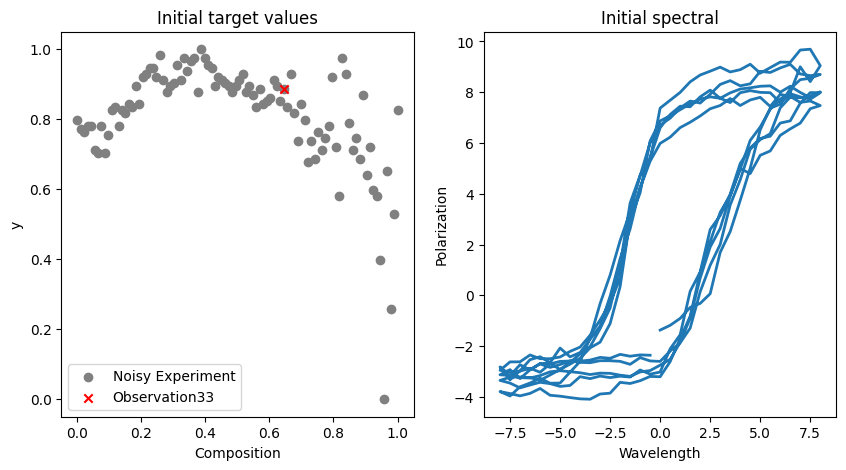

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


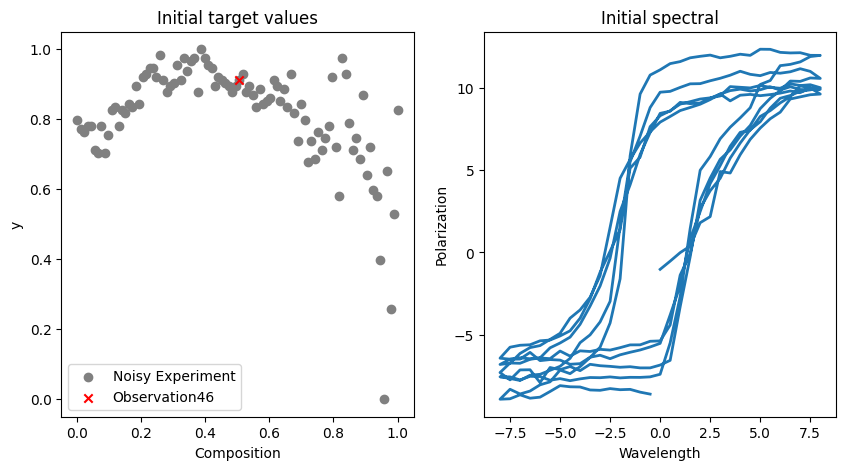

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


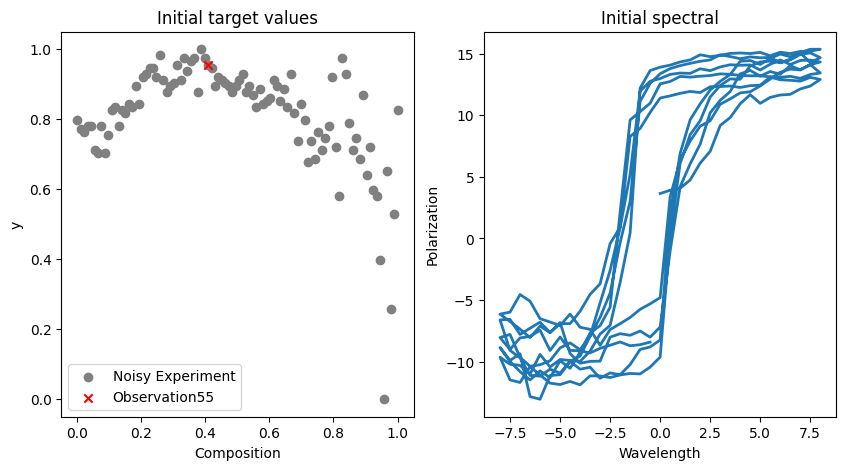

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


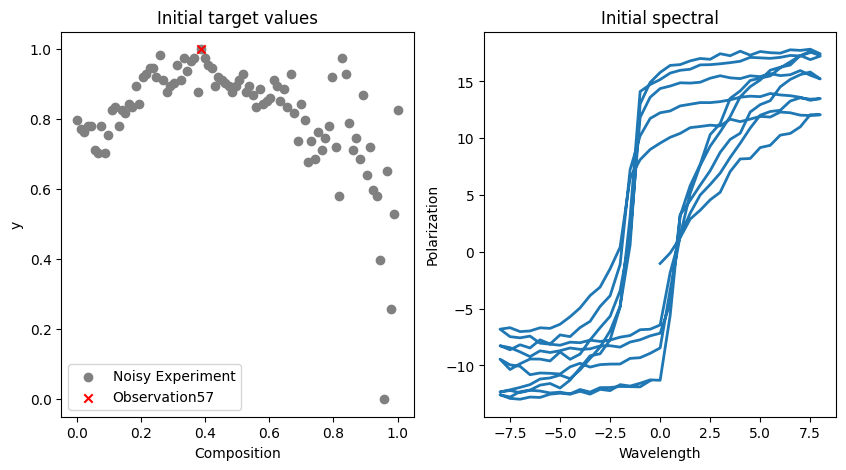

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


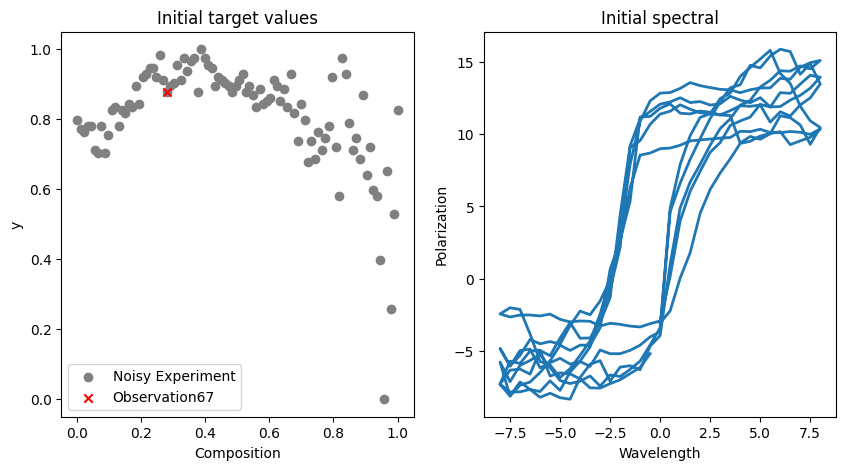

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


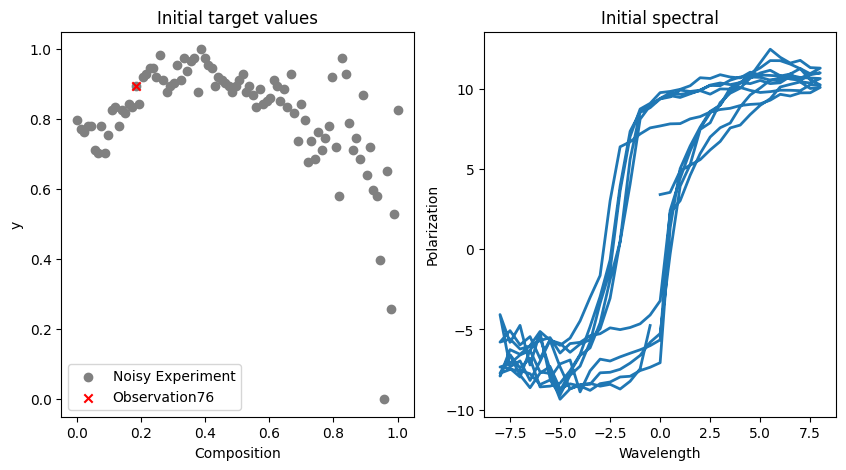

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


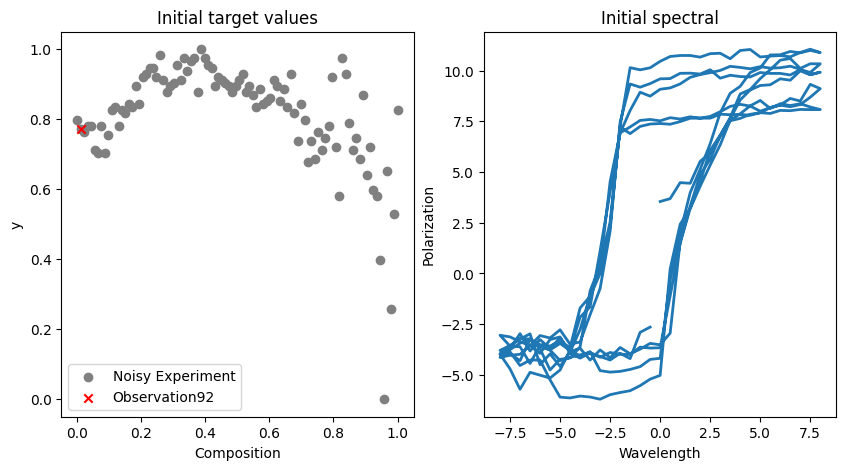

Is the current spectral good? y- Yes or press ENTER- No
Answer: y


(array([33, 46, 55, 57, 67, 76, 92]), array([ 1, 15, 22]))

In [ ]:
pola_off = loops_off[:,:,0,]*np.cos(loops_off[:,:,3,])
pol_data = [beps_wv, pola_off]
idx_good, idx_bad = votes_initialdata(X, y, X_train, y_train, pol_data, indices_train)
idx_good, idx_bad

In [ ]:
y_vote = np.zeros(len(y_train))
for i in range(0, len(y_vote)):
    y_good = 0
    y_bad = 0
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[i] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)
    #print(y_good)

    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[i] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)
    #print(y_bad)

    y_vote[i] = y_bad - y_good # Turning into maximization problem


print(idx_good, idx_bad, y_vote)

[33 46 55 57 67 76 92] [ 1 15 22] [-0.51817716 -0.41781874 -0.31746032 -0.08090118  0.15873016  0.29697901
  0.32155658  0.41372248  0.46902202  0.51817716]


#Constraint penalty = 1000

Step:1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 167.09it/s, 7 steps of size 5.55e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.70      0.98      0.25      1.91    402.04      1.00
    k_scale      0.99      1.06      0.67      0.08      2.08    307.22      1.00
      noise      0.07      0.07      0.04      0.00      0.14    294.75      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.99it/s, 7 steps of size 6.55e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.31      1.83      1.78      0.26      4.51    426.55      1.00
    k_scale      1.03      1.01      0.68      0.16      2.15    303.06      1.00
      noise      0.07      0.06      0.05      0.01      0.14    290.38      1.00



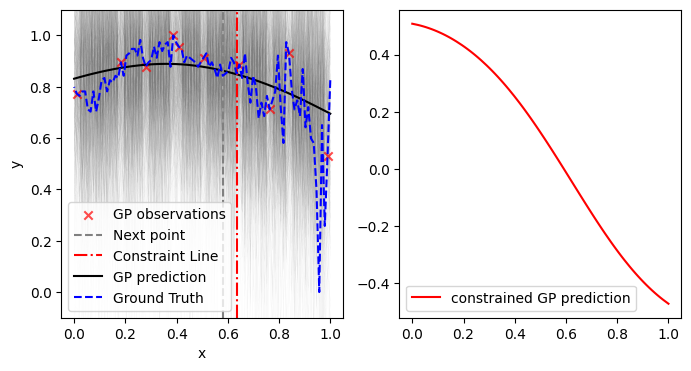

Step:2
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 164.45it/s, 7 steps of size 5.58e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.86      0.96      0.25      1.89    364.11      1.00
    k_scale      0.93      0.92      0.69      0.08      1.84    424.61      1.00
      noise      0.07      0.06      0.05      0.01      0.13    262.54      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 182.36it/s, 3 steps of size 8.07e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.42      2.58      1.82      0.36      4.24    198.00      1.00
    k_scale      1.03      0.92      0.76      0.14      2.28    334.63      1.00
      noise      0.06      0.04      0.04      0.01      0.12    298.52      1.01



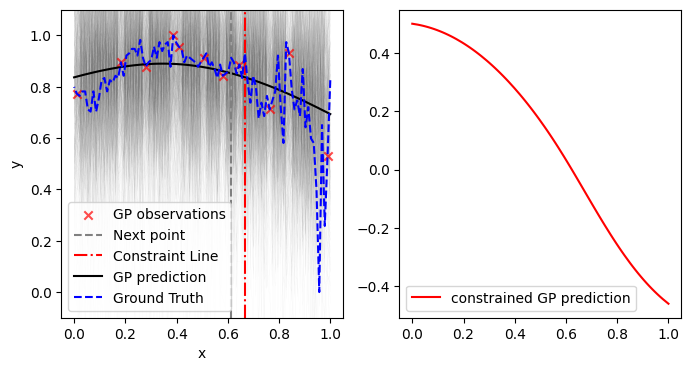

Step:3
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 168.40it/s, 7 steps of size 5.98e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.66      1.03      0.22      1.93    269.72      1.01
    k_scale      1.03      0.94      0.76      0.12      2.18    312.61      1.00
      noise      0.05      0.04      0.04      0.01      0.11    168.83      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.59it/s, 7 steps of size 7.02e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.35      2.13      1.77      0.41      4.16    378.89      1.00
    k_scale      1.01      0.93      0.75      0.10      2.01    282.05      1.00
      noise      0.04      0.03      0.04      0.01      0.08    187.47      1.00



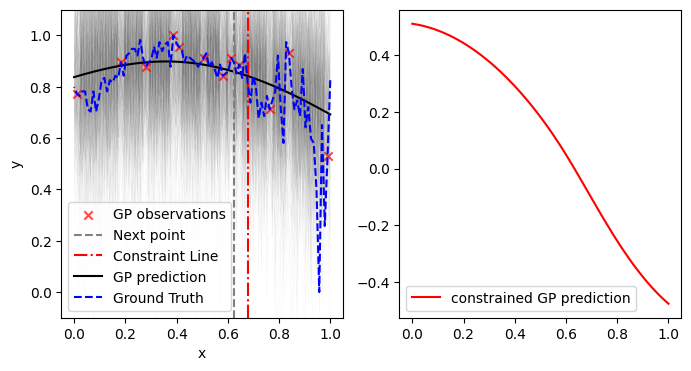

Step:4
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 166.53it/s, 7 steps of size 6.05e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.18      0.75      1.02      0.36      1.94    210.28      1.00
    k_scale      1.09      1.10      0.76      0.06      2.27    246.12      1.00
      noise      0.04      0.03      0.03      0.01      0.07    183.46      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 173.06it/s, 3 steps of size 7.24e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.06      1.48      1.68      0.52      3.68    395.50      1.00
    k_scale      1.02      0.90      0.76      0.16      2.02    242.21      1.00
      noise      0.04      0.03      0.03      0.01      0.07    234.26      1.00



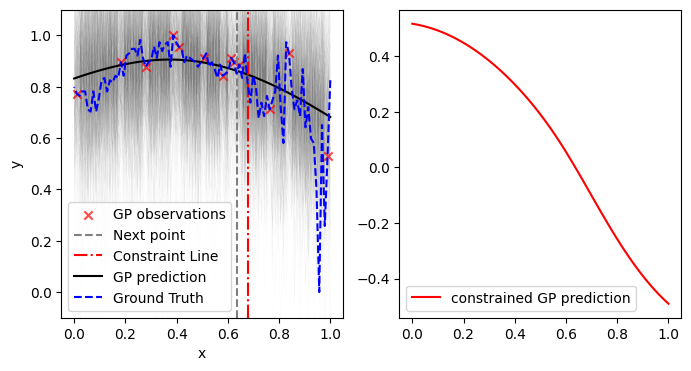

Step:5
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 161.08it/s, 7 steps of size 5.11e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.07      0.56      0.96      0.33      1.83    392.03      1.00
    k_scale      0.97      1.01      0.70      0.10      2.06    259.20      1.00
      noise      0.03      0.02      0.02      0.01      0.06    245.43      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 169.24it/s, 7 steps of size 6.91e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.28      2.94      1.64      0.45      3.73    150.75      1.00
    k_scale      1.05      1.09      0.75      0.06      2.00    229.51      1.01
      noise      0.03      0.02      0.02      0.01      0.06    213.44      1.00



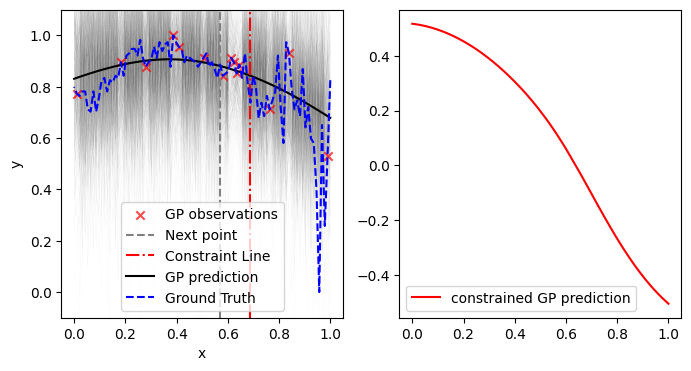

Step:6
Checking for ROI with potntial local optima
[0 1]
New potential region of interest found with prob= 0.29868595262208114
Running GP for constraint evaluation


<ipython-input-19-def33f35c924>:141: RuntimeWarning: invalid value encountered in scalar divide
  dist_z[i] = dist_z[i]/l_exp
sample: 100%|██████████| 1000/1000 [00:06<00:00, 165.09it/s, 3 steps of size 5.82e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.04      0.49      0.95      0.33      1.69    270.21      1.00
    k_scale      0.94      0.84      0.67      0.10      1.93    295.68      1.00
      noise      0.03      0.02      0.02      0.01      0.05    240.42      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 169.80it/s, 7 steps of size 6.48e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.36      2.84      1.66      0.46      4.02    161.63      1.00
    k_scale      1.03      1.06      0.73      0.11      1.96    304.24      1.01
      noise      0.03      0.02      0.02      0.01      0.05    221.12      1.00



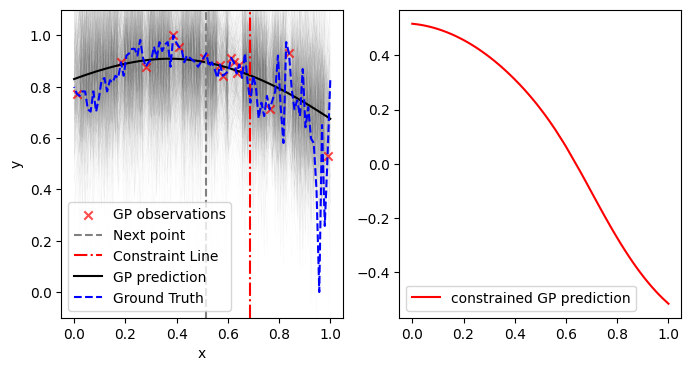

Step:7
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 161.08it/s, 7 steps of size 6.28e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.06      0.56      0.95      0.39      1.72    198.22      1.00
    k_scale      0.99      0.88      0.71      0.08      2.04    255.75      1.00
      noise      0.02      0.01      0.02      0.01      0.04    240.23      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 172.25it/s, 7 steps of size 7.66e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.19      2.31      1.60      0.42      3.76    229.20      1.00
    k_scale      1.01      0.97      0.73      0.15      2.00    315.08      1.00
      noise      0.02      0.01      0.02      0.01      0.04    248.97      1.00



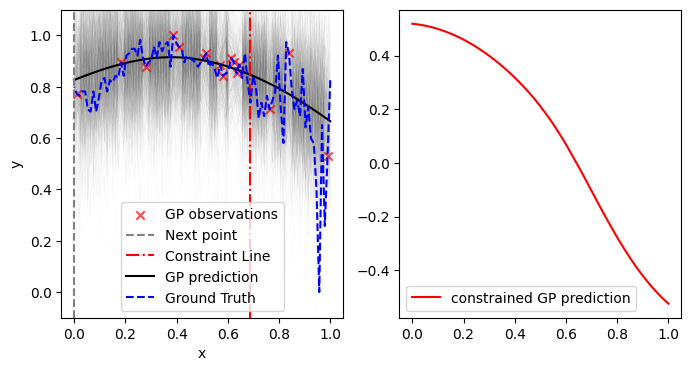

Step:8
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 153.26it/s, 7 steps of size 5.67e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.61      1.03      0.42      1.91    186.17      1.00
    k_scale      1.11      1.11      0.76      0.12      2.38    296.23      1.00
      noise      0.02      0.01      0.02      0.00      0.03    232.02      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 150.61it/s, 7 steps of size 5.13e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.97      2.29      1.54      0.36      3.12    256.55      1.00
    k_scale      0.91      0.89      0.65      0.10      1.63    212.51      1.00
      noise      0.02      0.01      0.02      0.00      0.03    338.91      1.00



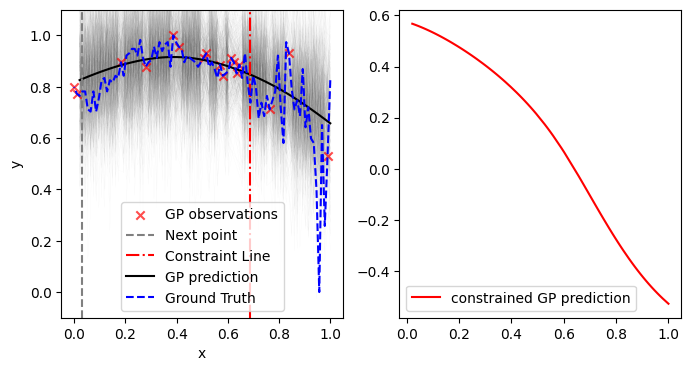

Step:9
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 148.80it/s, 7 steps of size 5.57e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.21      0.65      1.07      0.32      1.96    214.35      1.01
    k_scale      1.15      1.15      0.81      0.10      2.34    275.56      1.00
      noise      0.02      0.01      0.02      0.01      0.04    270.91      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 150.95it/s, 7 steps of size 5.37e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.70      1.37      1.44      0.60      2.81    513.74      1.00
    k_scale      0.95      0.88      0.72      0.14      1.75    333.10      1.00
      noise      0.02      0.01      0.01      0.01      0.03    323.55      1.00



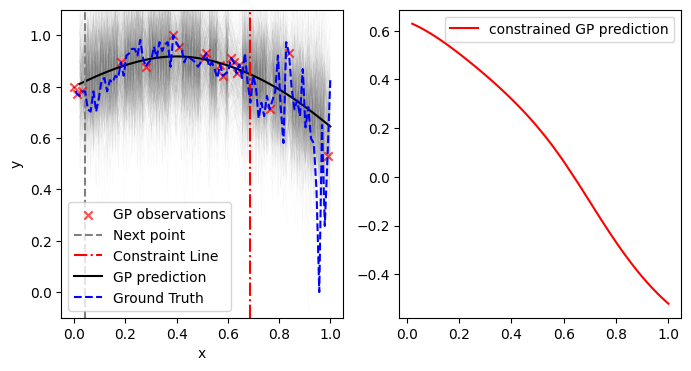

Step:10
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.61it/s, 7 steps of size 5.34e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.17      0.59      1.04      0.31      2.01    405.17      1.00
    k_scale      1.14      1.14      0.80      0.10      2.06    373.20      1.00
      noise      0.03      0.01      0.02      0.01      0.04    229.55      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.44it/s, 7 steps of size 5.96e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.64      1.53      1.41      0.62      2.54    524.27      1.00
    k_scale      1.02      1.07      0.68      0.11      2.08    331.38      1.00
      noise      0.01      0.01      0.01      0.00      0.02    225.75      1.00



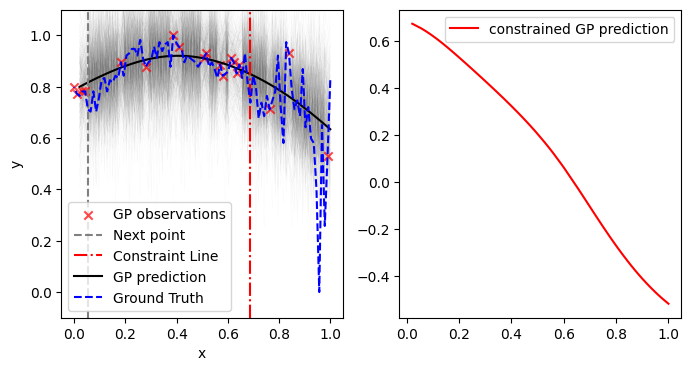

Step:11
Checking for ROI with potntial local optima
[ 0  1 19]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 148.91it/s, 7 steps of size 5.92e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.22      0.71      1.06      0.28      2.06    137.53      1.02
    k_scale      1.16      1.09      0.86      0.11      2.18    211.50      1.00
      noise      0.03      0.01      0.02      0.01      0.04    266.85      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 152.91it/s, 7 steps of size 6.57e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.57      1.06      1.39      0.47      2.32    435.71      1.00
    k_scale      1.04      0.97      0.75      0.13      2.06    347.17      1.00
      noise      0.01      0.01      0.01      0.00      0.02    276.80      1.00



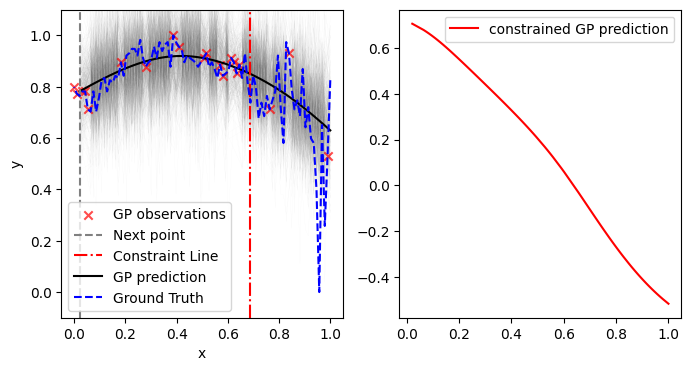

Step:12
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 143.23it/s, 7 steps of size 5.38e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.20      0.74      1.03      0.39      2.28    141.38      1.01
    k_scale      1.24      1.42      0.85      0.11      2.46    142.88      1.00
      noise      0.03      0.01      0.02      0.01      0.04    176.66      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 153.50it/s, 7 steps of size 6.59e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.53      1.20      1.37      0.65      2.28    447.94      1.00
    k_scale      1.01      0.89      0.78      0.16      1.99    302.44      1.00
      noise      0.01      0.01      0.01      0.00      0.02    259.21      1.00



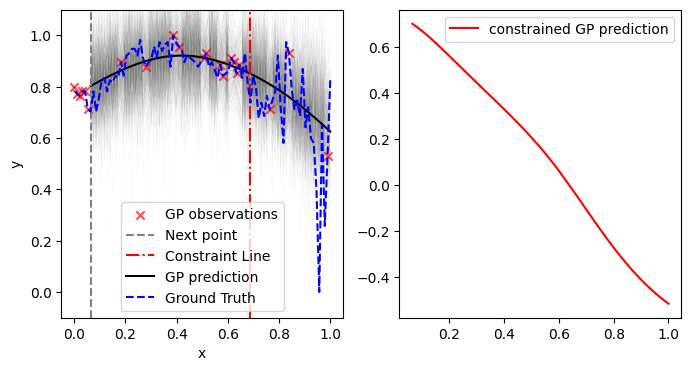

Step:13
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 140.45it/s, 7 steps of size 5.21e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.22      0.76      1.01      0.33      2.28    217.73      1.00
    k_scale      1.18      1.09      0.80      0.11      2.50    182.05      1.00
      noise      0.03      0.01      0.02      0.01      0.04    234.96      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 149.39it/s, 7 steps of size 6.66e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.47      0.84      1.33      0.48      2.11    535.54      1.00
    k_scale      1.07      1.12      0.78      0.11      2.03    327.05      1.00
      noise      0.01      0.00      0.01      0.00      0.02    327.03      1.00



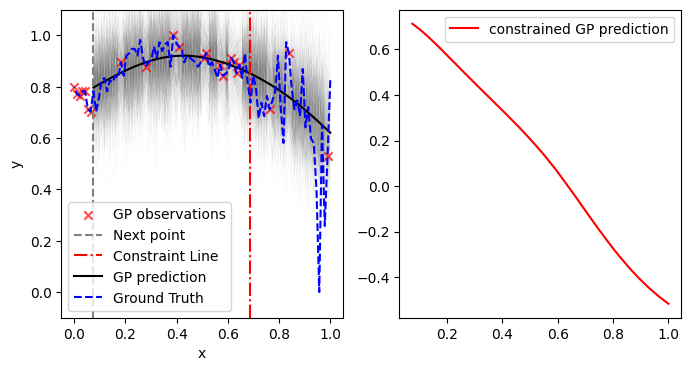

Step:14
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 149.76it/s, 7 steps of size 6.68e-01. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.17      0.65      1.05      0.29      1.96    284.72      1.00
    k_scale      1.30      1.42      0.92      0.15      2.65    280.44      1.00
      noise      0.02      0.01      0.02      0.01      0.04    242.17      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 152.87it/s, 3 steps of size 5.49e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.44      0.75      1.34      0.51      2.19    497.13      1.00
    k_scale      1.05      1.10      0.75      0.10      2.00    364.33      1.00
      noise      0.01      0.00      0.01      0.00      0.02    243.23      1.00



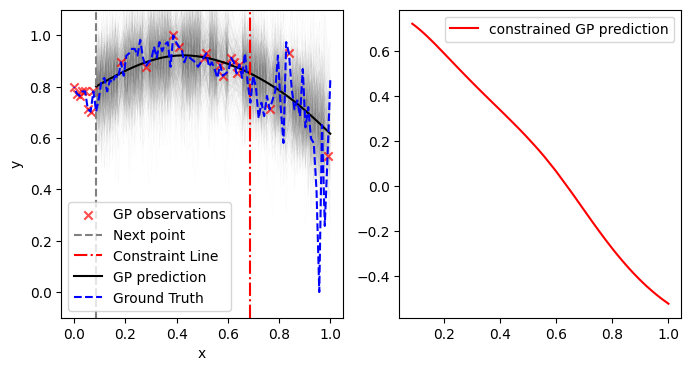

Step:15
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [05:35<00:00,  2.98it/s, 511 steps of size 3.92e-03. acc. prob=0.74]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.18      4.20      5.01      1.04     12.51     75.94      1.03
    k_scale      0.26      0.17      0.23      0.04      0.46    101.22      1.01
      noise      0.02      0.01      0.01      0.00      0.03    175.00      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:24<00:00,  2.25it/s, 1023 steps of size 8.86e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     12.37      9.34      9.23      2.37     27.02     21.04      1.00
    k_scale      0.18      0.10      0.15      0.05      0.32     20.20      1.04
      noise      0.01      0.00      0.01      0.00      0.02     27.95      1.16



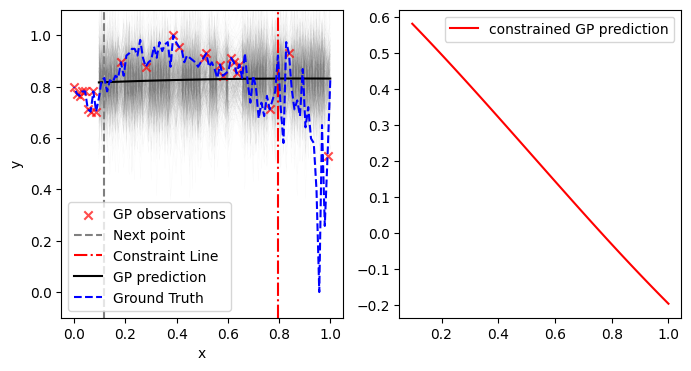

Step:16
Checking for ROI with potntial local optima
[ 0  1 19 24]
New potential region of interest found with prob= 0.4163681640313893
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:49<00:00,  2.44it/s, 1023 steps of size 2.02e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.38      3.92      4.16      1.05     10.72     68.31      1.00
    k_scale      0.22      0.17      0.18      0.06      0.41     60.10      1.01
      noise      0.02      0.01      0.02      0.01      0.03    106.21      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:27<00:00,  2.23it/s, 1023 steps of size 8.40e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     12.61      9.03      9.58      2.51     27.08     22.50      1.02
    k_scale      0.17      0.09      0.15      0.05      0.32     19.64      1.09
      noise      0.01      0.00      0.01      0.00      0.01     24.94      1.17



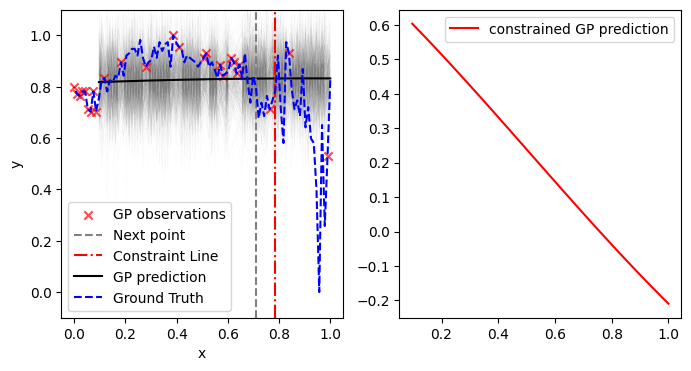

Step:17
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:37<00:00,  2.52it/s, 1023 steps of size 2.64e-03. acc. prob=0.80]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.71      4.40      4.49      0.76     11.60     80.30      1.01
    k_scale      0.24      0.18      0.19      0.04      0.46     76.39      1.00
      noise      0.02      0.01      0.02      0.01      0.03    116.29      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:29<00:00,  2.22it/s, 1023 steps of size 8.35e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     12.92      9.04      9.97      2.67     26.91     22.16      1.02
    k_scale      0.17      0.09      0.14      0.04      0.30     19.19      1.09
      noise      0.01      0.00      0.01      0.00      0.01     25.05      1.17



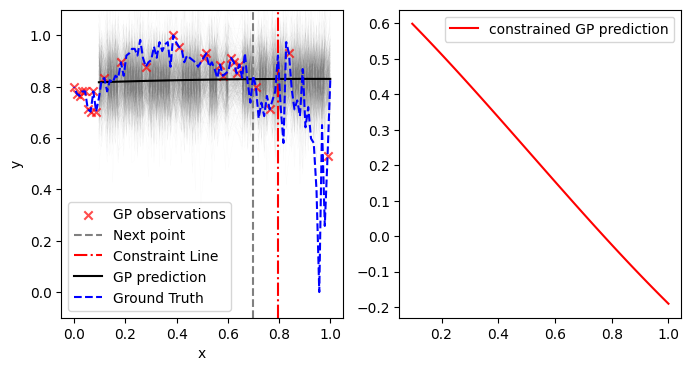

Step:18
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:39<00:00,  2.50it/s, 1023 steps of size 2.23e-03. acc. prob=0.81]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.65      4.06      4.42      0.87     10.85     84.94      1.00
    k_scale      0.22      0.14      0.19      0.06      0.39     77.74      1.00
      noise      0.02      0.01      0.02      0.00      0.03     97.84      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:34<00:00,  2.20it/s, 1023 steps of size 7.88e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     13.29      9.25     10.28      2.78     27.64     21.95      1.02
    k_scale      0.16      0.09      0.14      0.05      0.29     19.28      1.09
      noise      0.01      0.00      0.01      0.00      0.01     19.92      1.19



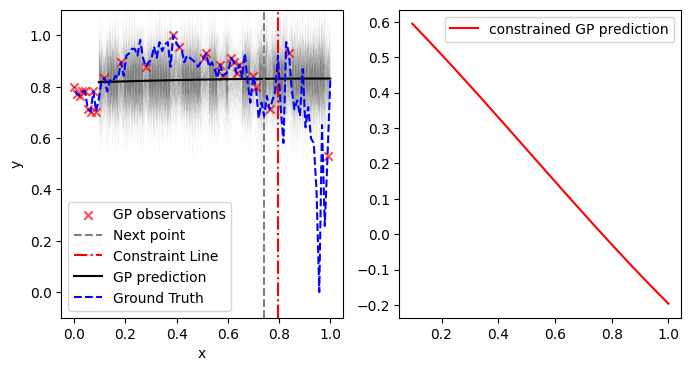

Step:19
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:53<00:00,  2.42it/s, 1023 steps of size 2.15e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.43      4.02      4.18      1.24     10.54     88.63      1.00
    k_scale      0.21      0.14      0.17      0.06      0.40     75.49      1.01
      noise      0.02      0.01      0.01      0.01      0.03    104.16      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:39<00:00,  2.18it/s, 1023 steps of size 8.38e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     12.71      8.85      9.70      2.73     26.49     21.21      1.02
    k_scale      0.16      0.09      0.14      0.03      0.29     18.30      1.08
      noise      0.01      0.00      0.01      0.00      0.01     25.46      1.16



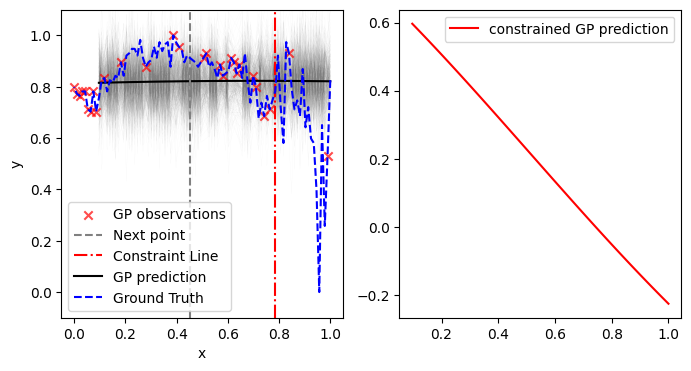

Step:20
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:58<00:00,  2.39it/s, 1023 steps of size 2.02e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.69      4.14      4.38      1.16     10.78     85.95      1.00
    k_scale      0.22      0.14      0.18      0.06      0.39     76.08      1.02
      noise      0.02      0.01      0.01      0.01      0.03     81.45      1.03

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:36<00:00,  2.19it/s, 1023 steps of size 8.36e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     13.20      9.13     10.14      2.88     27.30     20.93      1.02
    k_scale      0.16      0.09      0.14      0.03      0.28     18.89      1.08
      noise      0.01      0.00      0.01      0.00      0.01     24.92      1.16



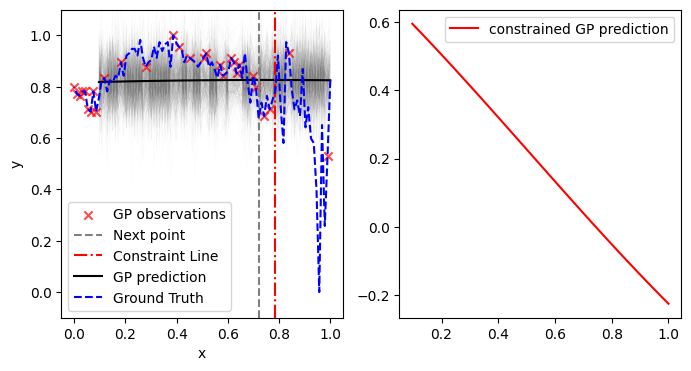

Step:21
Checking for ROI with potntial local optima
[ 0  1 19 24 29]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:02<00:00,  2.37it/s, 1023 steps of size 2.03e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.79      4.17      4.46      1.44     11.38     76.46      1.00
    k_scale      0.21      0.14      0.17      0.06      0.39     60.18      1.01
      noise      0.01      0.01      0.01      0.01      0.02     97.45      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:41<00:00,  2.17it/s, 1023 steps of size 7.77e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     13.00      9.02     10.00      3.06     27.16     20.83      1.02
    k_scale      0.16      0.09      0.14      0.03      0.28     18.34      1.08
      noise      0.01      0.00      0.01      0.00      0.01     22.07      1.18



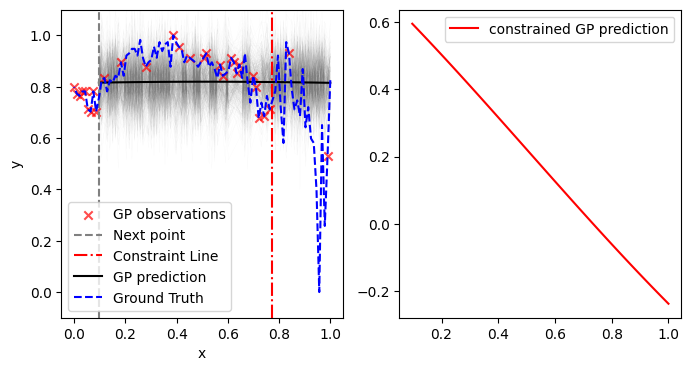

Step:22
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:06<00:00,  2.35it/s, 1023 steps of size 1.91e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.71      4.23      4.37      1.34     11.47     81.78      1.00
    k_scale      0.21      0.13      0.17      0.06      0.38     69.01      1.02
      noise      0.02      0.01      0.02      0.01      0.03     91.95      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:52<00:00,  2.12it/s, 1023 steps of size 7.58e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     13.20      9.10     10.15      2.48     26.95     21.01      1.02
    k_scale      0.16      0.09      0.14      0.03      0.28     18.01      1.07
      noise      0.01      0.00      0.01      0.00      0.01     17.44      1.22



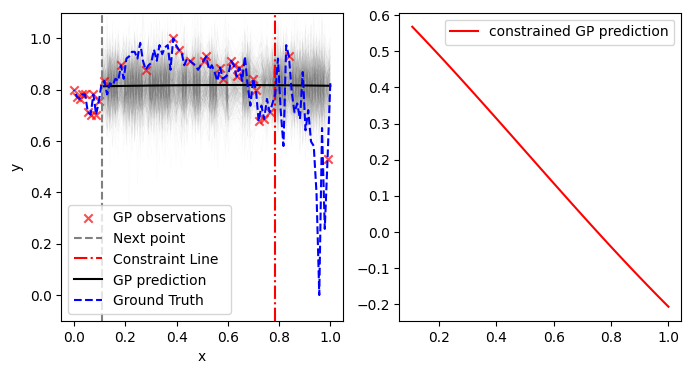

Step:23
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:32<00:00,  2.55it/s, 1023 steps of size 1.82e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.74      4.19      4.40      1.34     11.22     84.45      1.00
    k_scale      0.20      0.14      0.17      0.05      0.37     69.64      1.02
      noise      0.02      0.01      0.02      0.01      0.03     77.09      1.03

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:14<00:00,  2.30it/s, 1023 steps of size 8.09e-04. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]     12.90      8.71     10.00      2.82     24.72     20.14      1.03
    k_scale      0.16      0.09      0.13      0.04      0.28     17.72      1.08
      noise      0.01      0.00      0.00      0.00      0.01     23.75      1.19



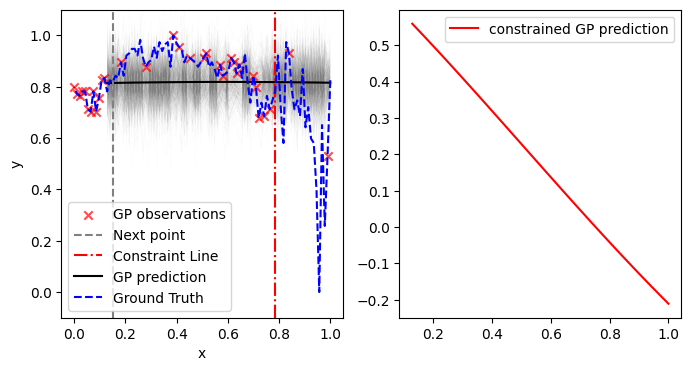

Step:24
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 124.44it/s, 3 steps of size 5.52e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.21      0.68      1.04      0.34      2.09    295.21      1.00
    k_scale      1.28      1.28      0.88      0.17      2.68    288.98      1.00
      noise      0.02      0.01      0.02      0.01      0.03    265.21      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.10it/s, 7 steps of size 6.08e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.32      0.45      1.26      0.67      2.02    267.74      1.00
    k_scale      0.95      0.96      0.65      0.13      1.82    286.85      1.00
      noise      0.01      0.00      0.01      0.00      0.01    343.11      1.00



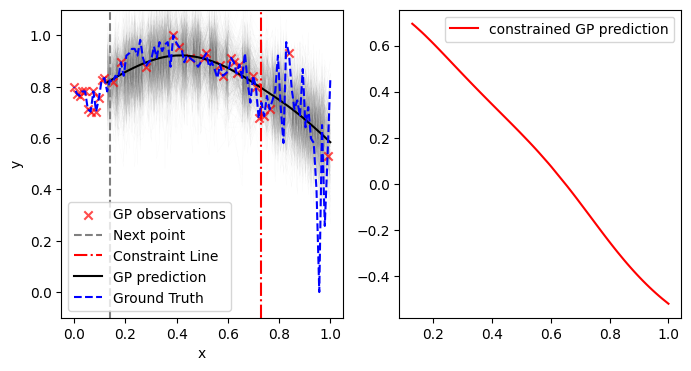

Step:25
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 123.50it/s, 3 steps of size 5.70e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.20      0.69      1.04      0.31      2.04    386.08      1.01
    k_scale      1.30      1.20      0.92      0.14      2.79    324.30      1.00
      noise      0.02      0.01      0.02      0.01      0.03    246.55      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 124.99it/s, 3 steps of size 5.32e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.30      0.45      1.23      0.68      2.08    339.80      1.00
    k_scale      0.93      0.97      0.66      0.06      1.83    254.05      1.00
      noise      0.01      0.00      0.01      0.00      0.01    218.97      1.01



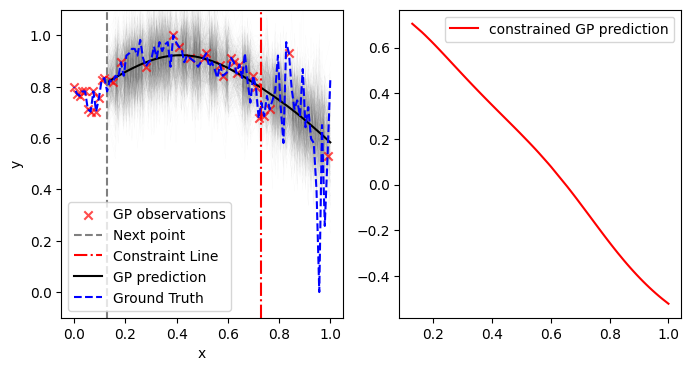

Step:26
Checking for ROI with potntial local optima
[ 0  1 19 24 29 30]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 127.98it/s, 7 steps of size 5.71e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.63      1.00      0.33      2.05    342.06      1.00
    k_scale      1.20      1.18      0.82      0.10      2.50    345.22      1.00
      noise      0.02      0.01      0.02      0.01      0.03    265.09      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 131.12it/s, 7 steps of size 5.81e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.29      0.49      1.24      0.42      1.93    284.68      1.00
    k_scale      0.95      1.02      0.66      0.12      1.76    345.13      1.00
      noise      0.01      0.00      0.01      0.00      0.01    266.16      1.00



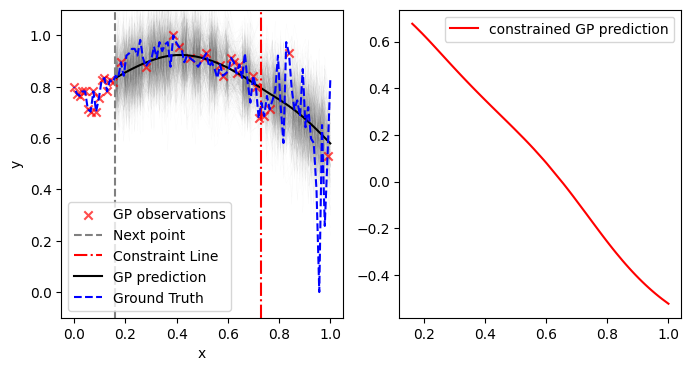

Step:27
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 119.68it/s, 7 steps of size 4.66e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.11      0.74      0.90      0.33      2.03    191.77      1.00
    k_scale      1.11      1.05      0.78      0.13      2.40    156.60      1.00
      noise      0.02      0.01      0.02      0.01      0.03    289.13      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 131.61it/s, 7 steps of size 5.77e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.26      0.41      1.22      0.60      1.90    238.44      1.00
    k_scale      0.87      0.76      0.65      0.13      1.70    335.58      1.00
      noise      0.01      0.00      0.01      0.00      0.01    370.56      1.00



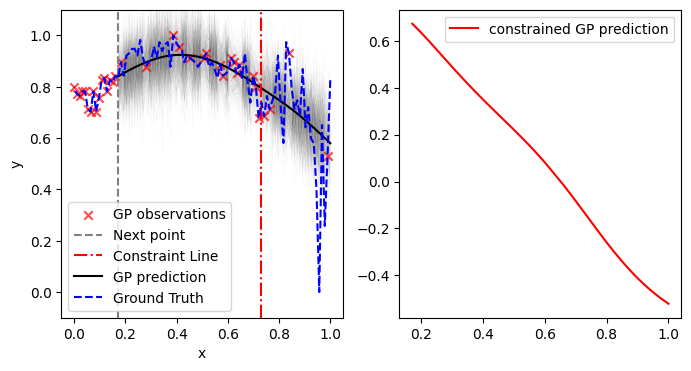

Step:28
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 121.52it/s, 7 steps of size 5.31e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.07      0.64      0.90      0.33      1.88    187.51      1.00
    k_scale      1.16      1.14      0.82      0.07      2.39    169.35      1.00
      noise      0.02      0.01      0.02      0.01      0.03    290.85      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.73it/s, 7 steps of size 5.07e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.27      0.45      1.21      0.53      2.06    277.48      1.00
    k_scale      0.94      0.89      0.66      0.14      1.86    229.32      1.02
      noise      0.01      0.00      0.01      0.00      0.01    308.78      1.00



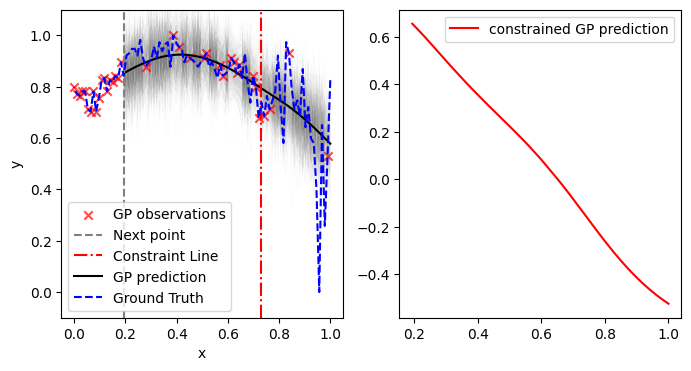

Step:29
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.35it/s, 7 steps of size 6.18e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.97      0.50      0.86      0.38      1.76    296.99      1.00
    k_scale      1.08      1.16      0.74      0.18      2.33    318.12      1.00
      noise      0.02      0.01      0.02      0.01      0.03    235.84      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 130.47it/s, 7 steps of size 6.15e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.29      0.51      1.24      0.50      1.98    168.83      1.01
    k_scale      1.01      1.01      0.70      0.12      1.97    250.33      1.00
      noise      0.01      0.00      0.01      0.00      0.01    298.87      1.00



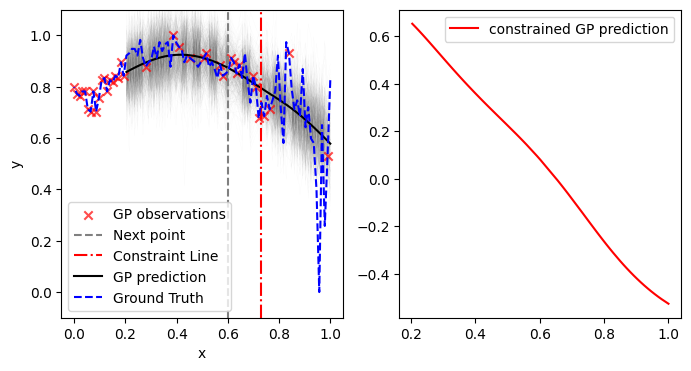

Step:30
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 121.25it/s, 7 steps of size 5.53e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.95      0.49      0.84      0.30      1.64    323.27      1.00
    k_scale      1.08      1.00      0.78      0.13      2.21    342.41      1.00
      noise      0.02      0.01      0.02      0.01      0.03    250.72      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.19it/s, 7 steps of size 6.40e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.28      0.46      1.25      0.63      2.13    280.92      1.00
    k_scale      0.98      0.88      0.71      0.15      2.23    307.85      1.00
      noise      0.01      0.00      0.01      0.00      0.01    281.51      1.00



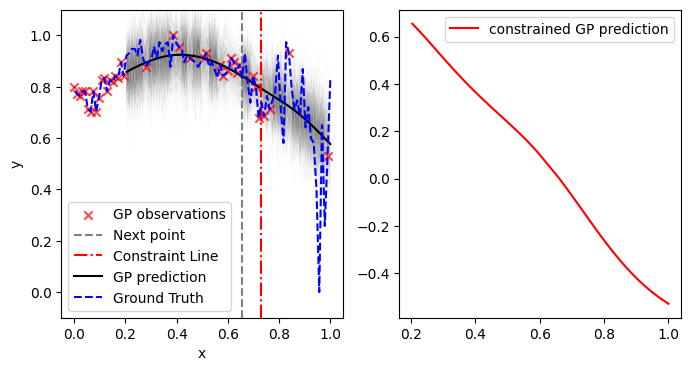

In [ ]:
N = 30
n = 5 # Check for best results
m = 0
X_test_norm = X_test
# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
y_train_inv = -y_train
best_x = X_train[np.argmax(y_train_inv)]
exp_x = [int(np.argmax(y_train_inv))]
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))
    # Checking criteria wheather we find a potential region of interest to exploit-- can be a local or global optima
    if m == n:
        best_x = X_train[exp_x[-1]]
        y_train_inv = -y_train
        m = 0

        if np.isin(exp_x, int(np.argmax(y_train_inv))).any()== True: #New potential region of interest found with low function values

            y_train_norm = (y_train_inv-np.min(y_train_inv))/(np.max(y_train_inv)-np.min(y_train_inv))
            best_y_norm = np.max(y_train_norm)
            # Need to provide normalized value of X and Y
            print("Checking for ROI with potntial local optima")
            exp_x = check_ROI(X_train, y_train_norm, best_x, best_y_norm, exp_x)
            best_x = X_train[exp_x[-1]]
        else:
            exp_x = np.hstack((exp_x, int(np.argmax(y_train_inv)))) #New potential ROI found with higher function values
            best_x = X_train[exp_x[-1]]
            print("New ROI with potential global optima found")

    m = m + 1

    # Execute contraint GP
    print("Running GP for constraint evaluation")
    cGP, constraint_mean, _= run_constrainGP(X_train, y_vote, X_test)
    c_val = np.min(np.absolute(constraint_mean))
    c_idx = np.argmin(np.absolute(constraint_mean))

    # Execute GP
    print("Running GP for function evaluation")
    test_data = [X_test, X_test_norm]
    cost_params = [best_x, exp_x, c_loc, c_glo, int(k[i-1])]
    gpbo, obj, posterior_mean, f_samples = run_statGP(X_train, y_train, test_data, constraint = constraint_mean, pen=1000, cost_params= cost_params)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].set_xlabel("x")
    ax[0].set_ylabel("y")
    ax[0].scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax[0].axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    ax[0].axvline(X[c_idx], linestyle = "-.", c = "r", label="Constraint Line")
    for y1 in f_samples:
      ax[0].plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax[0].plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax[0].plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax[0].plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax[0].legend();
    l.set_alpha(0)
    ax[0].set_ylim(-0.1, 1.1)

    ax[1].plot(X_test, constraint_mean, c='r', label='constrained GP prediction')
    ax[1].legend();
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)


    # Update distance metric for new X
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[-1] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)


    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[-1] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)

    y_vote = np.hstack((y_vote, (y_bad - y_good))) # Maximizing the target constraint



# Constraint penalty = 1

Step:1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 155.11it/s, 7 steps of size 5.55e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.13      0.70      0.98      0.25      1.91    402.04      1.00
    k_scale      0.99      1.06      0.67      0.08      2.08    307.22      1.00
      noise      0.07      0.07      0.04      0.00      0.14    294.75      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 161.72it/s, 7 steps of size 6.55e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.31      1.83      1.78      0.26      4.51    426.55      1.00
    k_scale      1.03      1.01      0.68      0.16      2.15    303.06      1.00
      noise      0.07      0.06      0.05      0.01      0.14    290.38      1.00



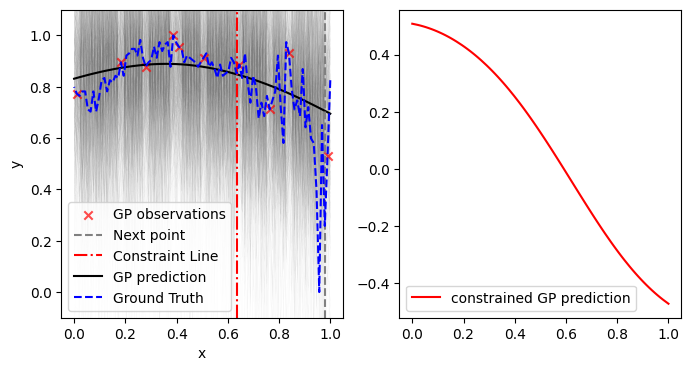

Step:2
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.84it/s, 7 steps of size 6.22e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.31      0.93      1.09      0.33      2.23    177.77      1.00
    k_scale      1.15      1.22      0.77      0.06      2.45    229.09      1.00
      noise      0.06      0.06      0.04      0.01      0.12    177.71      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 163.76it/s, 3 steps of size 7.80e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.84      1.79      1.40      0.32      3.12    313.51      1.00
    k_scale      1.04      1.01      0.72      0.08      2.16    298.13      1.00
      noise      0.09      0.07      0.07      0.02      0.18    266.74      1.00



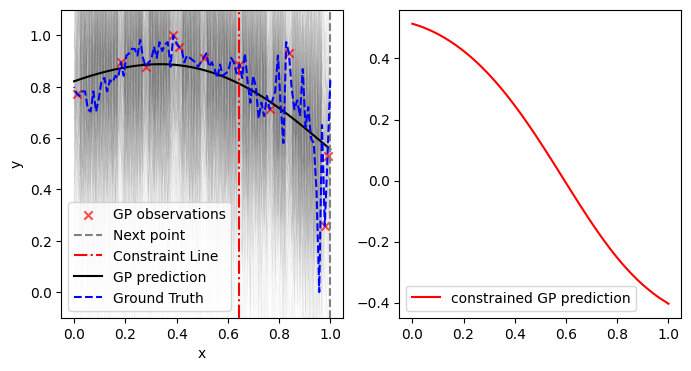

Step:3
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.64it/s, 3 steps of size 5.92e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.65      0.99      0.26      1.98    321.40      1.00
    k_scale      0.91      0.84      0.66      0.09      1.88    261.68      1.00
      noise      0.05      0.04      0.03      0.01      0.09    277.30      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:05<00:00, 166.82it/s, 7 steps of size 6.86e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.14      1.79      1.60      0.46      4.19    386.63      1.00
    k_scale      1.01      0.99      0.72      0.14      2.00    283.00      1.00
      noise      0.09      0.05      0.07      0.02      0.16    232.49      1.00



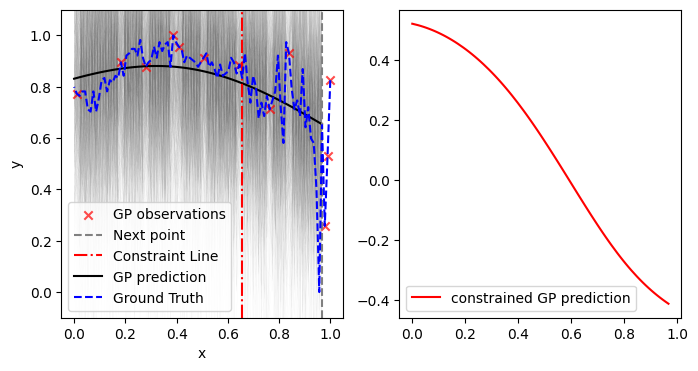

Step:4
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 157.89it/s, 7 steps of size 5.80e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.15      0.66      0.99      0.27      1.91    297.45      1.00
    k_scale      0.98      0.92      0.71      0.08      2.07    322.73      1.00
      noise      0.04      0.03      0.03      0.01      0.07    224.20      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 163.23it/s, 7 steps of size 6.98e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.22      1.77      1.72      0.39      4.06    319.71      1.00
    k_scale      0.98      0.94      0.66      0.12      2.06    314.37      1.00
      noise      0.08      0.05      0.06      0.02      0.14    285.29      1.00



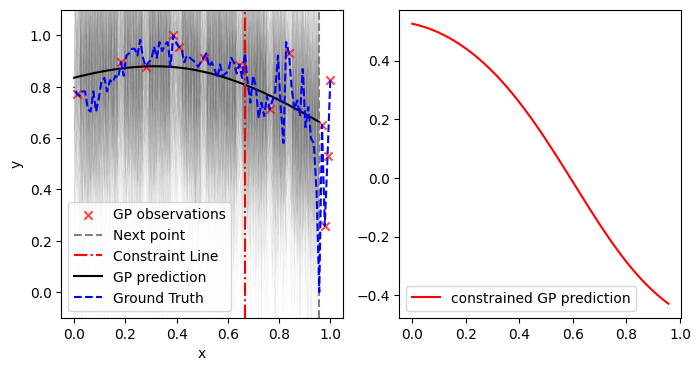

Step:5
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 151.10it/s, 7 steps of size 5.50e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.05      0.51      0.95      0.30      1.75    328.37      1.00
    k_scale      0.84      0.72      0.62      0.10      1.68    378.97      1.00
      noise      0.03      0.02      0.02      0.01      0.05    233.90      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 161.36it/s, 3 steps of size 7.44e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.92      1.75      1.46      0.27      3.49    283.35      1.00
    k_scale      1.03      0.98      0.75      0.12      2.09    325.36      1.01
      noise      0.12      0.06      0.10      0.04      0.20    280.30      1.00



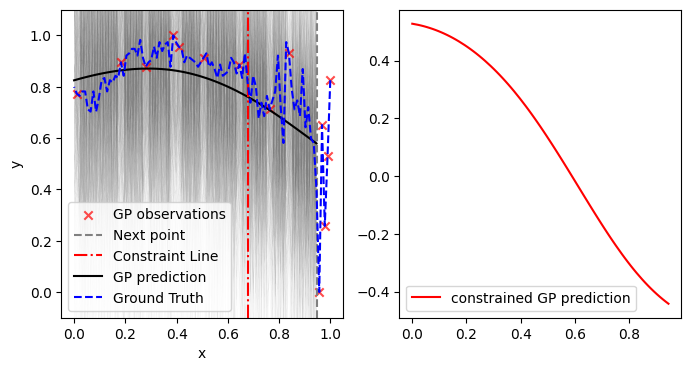

Step:6
New ROI with potential global optima found
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 150.97it/s, 7 steps of size 6.09e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.03      0.46      0.94      0.46      1.80    337.35      1.00
    k_scale      0.86      0.83      0.62      0.07      1.68    406.06      1.00
      noise      0.02      0.02      0.02      0.01      0.04    317.54      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 162.00it/s, 3 steps of size 7.57e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.77      1.54      1.42      0.33      3.07    325.58      1.00
    k_scale      1.11      1.08      0.78      0.11      2.45    319.62      1.01
      noise      0.11      0.05      0.09      0.04      0.19    244.15      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


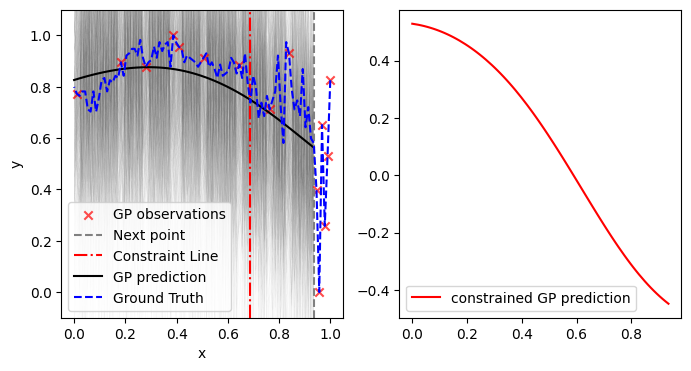

Step:7
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 148.00it/s, 7 steps of size 5.65e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.07      0.53      0.95      0.32      1.68    373.35      1.00
    k_scale      0.94      0.90      0.66      0.13      2.17    360.44      1.00
      noise      0.02      0.01      0.02      0.01      0.04    206.71      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 160.55it/s, 3 steps of size 8.32e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.68      1.19      1.39      0.37      3.12    411.20      1.00
    k_scale      1.04      0.96      0.78      0.12      2.07    368.41      1.00
      noise      0.09      0.04      0.08      0.04      0.15    332.12      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


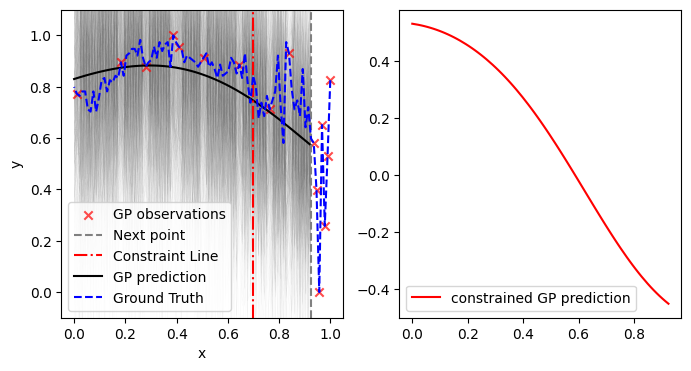

Step:8
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 142.11it/s, 7 steps of size 5.80e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.04      0.47      0.94      0.35      1.66    407.02      1.00
    k_scale      1.03      1.09      0.68      0.09      2.13    360.28      1.00
      noise      0.02      0.01      0.02      0.00      0.03    327.88      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 152.68it/s, 3 steps of size 7.22e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.77      1.49      1.40      0.31      3.06    380.84      1.00
    k_scale      1.15      1.01      0.86      0.16      2.33    310.28      1.00
      noise      0.08      0.04      0.07      0.03      0.14    348.05      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


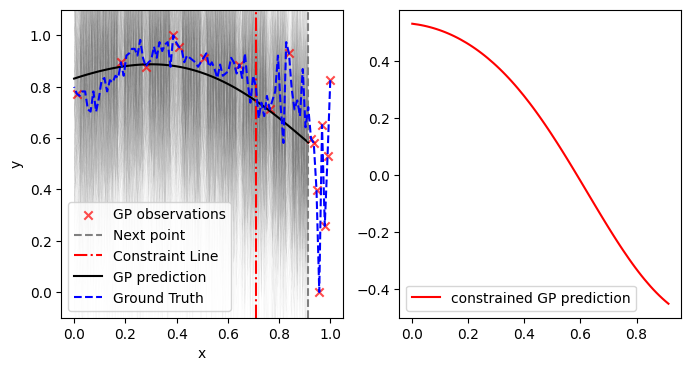

Step:9
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 138.24it/s, 7 steps of size 5.46e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.00      0.47      0.90      0.32      1.60    363.83      1.00
    k_scale      0.89      0.84      0.63      0.13      1.86    338.91      1.00
      noise      0.02      0.01      0.01      0.01      0.03    210.44      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 144.70it/s, 7 steps of size 6.73e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.66      1.26      1.36      0.39      2.70    271.02      1.00
    k_scale      1.10      1.11      0.80      0.15      2.16    288.20      1.01
      noise      0.08      0.03      0.07      0.03      0.13    317.58      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


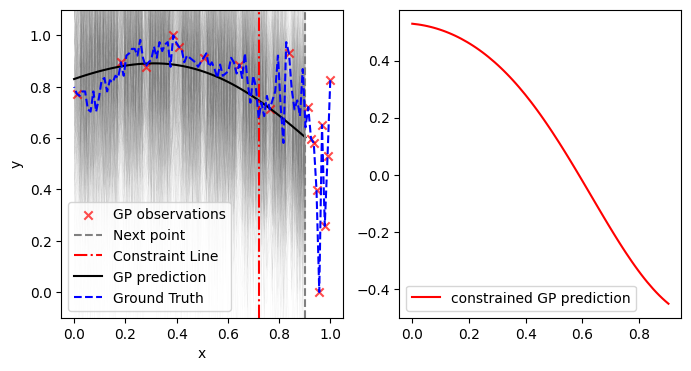

Step:10
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.67it/s, 7 steps of size 5.52e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.96      0.43      0.87      0.41      1.54    269.63      1.00
    k_scale      0.91      0.87      0.62      0.13      2.02    303.54      1.01
      noise      0.01      0.01      0.01      0.00      0.03    245.64      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.47it/s, 3 steps of size 7.26e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.73      1.43      1.36      0.42      3.23    321.17      1.00
    k_scale      1.14      1.19      0.75      0.11      2.40    305.71      1.01
      noise      0.07      0.03      0.07      0.03      0.12    240.81      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


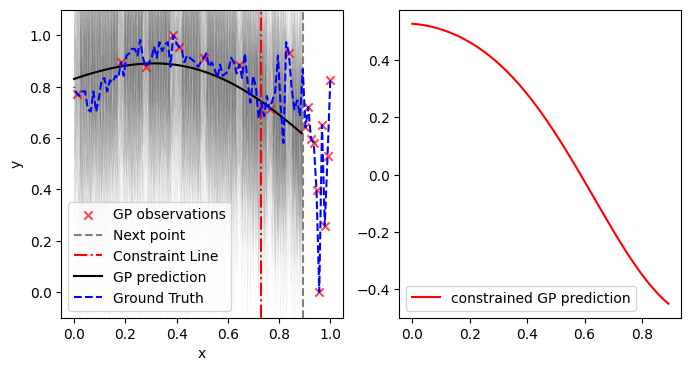

Step:11
Checking for ROI with potntial local optima
[ 0 13 18]
New potential region of interest found with prob= 0.4118420529368463
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.77it/s, 7 steps of size 5.58e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.91      0.40      0.85      0.39      1.40    297.35      1.00
    k_scale      0.86      0.85      0.60      0.06      1.74    343.08      1.00
      noise      0.01      0.01      0.01      0.00      0.02    223.04      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 141.79it/s, 3 steps of size 7.11e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.79      1.37      1.46      0.35      3.29    445.41      1.00
    k_scale      1.05      0.94      0.76      0.12      2.12    325.95      1.00
      noise      0.07      0.03      0.07      0.03      0.12    286.30      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


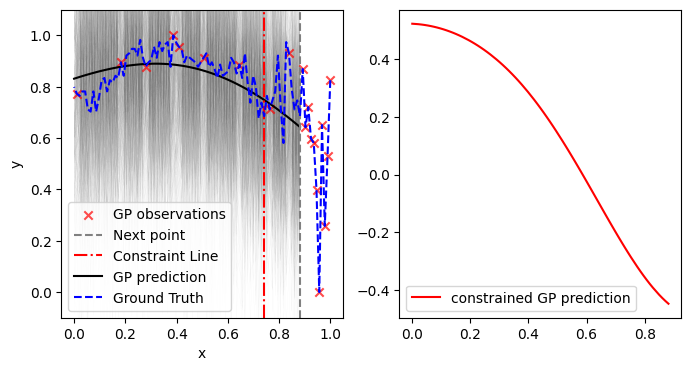

Step:12
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 133.42it/s, 7 steps of size 5.79e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.90      0.39      0.84      0.40      1.38    300.21      1.00
    k_scale      0.87      0.86      0.60      0.07      1.63    296.74      1.00
      noise      0.01      0.01      0.01      0.00      0.02    344.38      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 142.27it/s, 7 steps of size 6.49e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.70      1.31      1.36      0.37      3.05    306.92      1.00
    k_scale      1.12      1.15      0.76      0.12      2.22    360.84      1.00
      noise      0.07      0.03      0.06      0.03      0.10    294.21      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


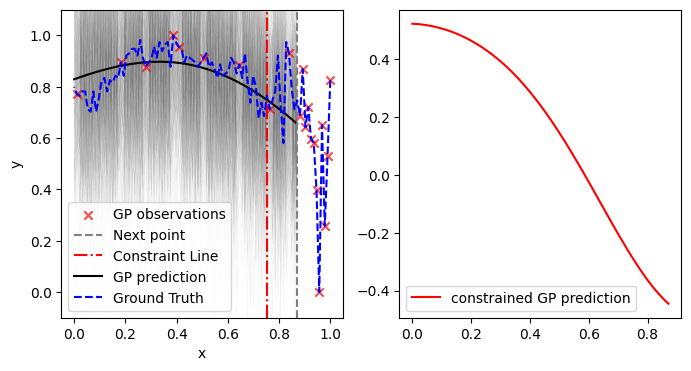

Step:13
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 135.04it/s, 7 steps of size 5.39e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.85      0.33      0.79      0.35      1.22    344.98      1.00
    k_scale      0.82      0.75      0.59      0.12      1.65    336.09      1.00
      noise      0.01      0.01      0.01      0.00      0.02    283.14      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 140.55it/s, 7 steps of size 6.60e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.95      2.43      1.42      0.37      3.33    147.45      1.00
    k_scale      1.18      1.16      0.83      0.14      2.49    303.51      1.00
      noise      0.06      0.02      0.06      0.03      0.10    284.89      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


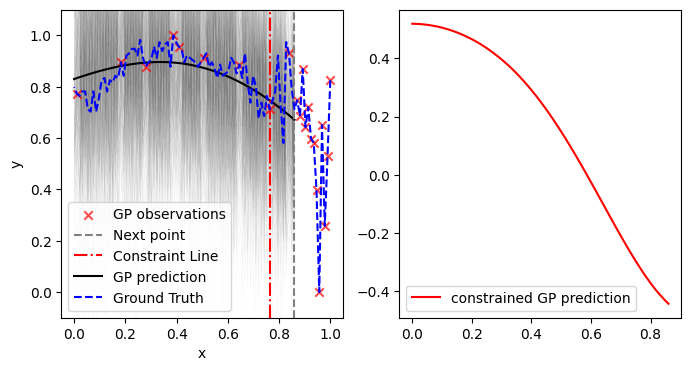

Step:14
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 137.33it/s, 7 steps of size 5.67e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.82      0.33      0.76      0.32      1.23    303.31      1.00
    k_scale      0.79      0.73      0.56      0.10      1.59    328.20      1.00
      noise      0.01      0.00      0.01      0.00      0.01    233.27      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:06<00:00, 145.92it/s, 7 steps of size 6.79e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.63      1.28      1.33      0.36      2.76    343.30      1.00
    k_scale      1.14      1.17      0.82      0.10      2.24    341.07      1.00
      noise      0.06      0.02      0.05      0.03      0.09    286.69      1.00



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


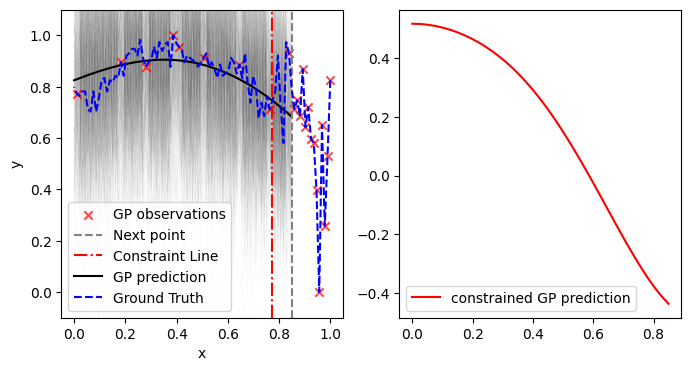

Step:15
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:39<00:00,  2.51it/s, 1023 steps of size 1.88e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.03      5.36      5.30      1.32     13.91     58.81      1.00
    k_scale      0.18      0.13      0.14      0.05      0.32     52.55      1.00
      noise      0.01      0.01      0.01      0.00      0.02    109.00      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:28<00:00,  2.23it/s, 1023 steps of size 1.21e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.52      5.10      4.86      1.03     12.54     48.70      1.01
    k_scale      0.27      0.17      0.22      0.05      0.49     39.86      1.05
      noise      0.05      0.02      0.05      0.02      0.08     55.61      1.07



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


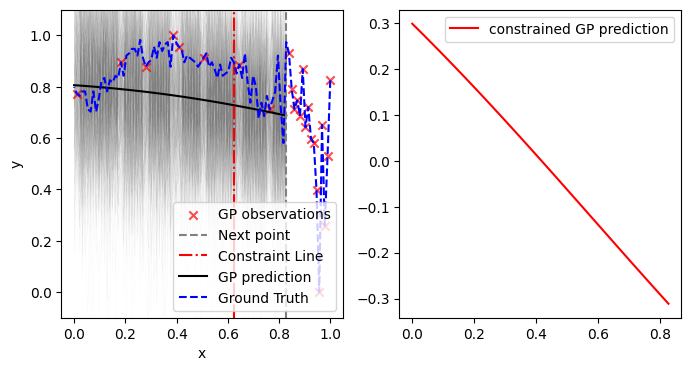

Step:16
Checking for ROI with potntial local optima
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:14<00:00,  2.30it/s, 1023 steps of size 1.76e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.85      4.67      5.29      1.67     13.77     52.00      1.00
    k_scale      0.17      0.13      0.14      0.03      0.31     61.29      1.02
      noise      0.01      0.01      0.01      0.00      0.02     77.47      1.05

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:36<00:00,  2.19it/s, 1023 steps of size 1.18e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.29      4.80      4.72      1.13     12.16     44.42      1.01
    k_scale      0.27      0.17      0.23      0.05      0.51     35.85      1.06
      noise      0.05      0.02      0.04      0.02      0.08     45.91      1.08



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


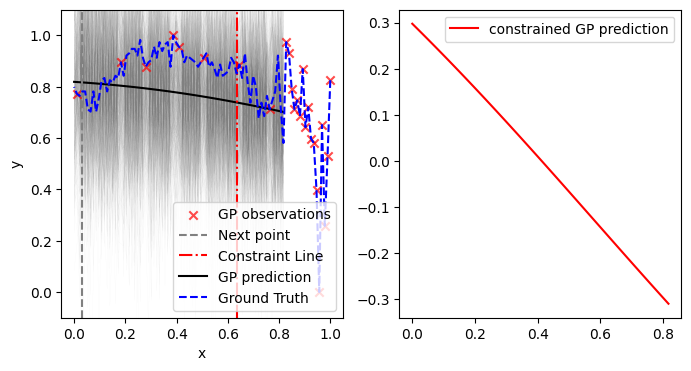

Step:17
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:01<00:00,  2.37it/s, 1023 steps of size 1.52e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.95      4.51      5.36      1.59     14.17     35.72      1.01
    k_scale      0.16      0.12      0.13      0.03      0.29     58.70      1.03
      noise      0.01      0.00      0.01      0.00      0.02     65.46      1.06

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:24<00:00,  2.25it/s, 1023 steps of size 1.16e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.47      4.89      4.91      1.10     12.38     43.85      1.01
    k_scale      0.27      0.17      0.22      0.04      0.49     37.28      1.06
      noise      0.04      0.02      0.04      0.02      0.07     41.49      1.09



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


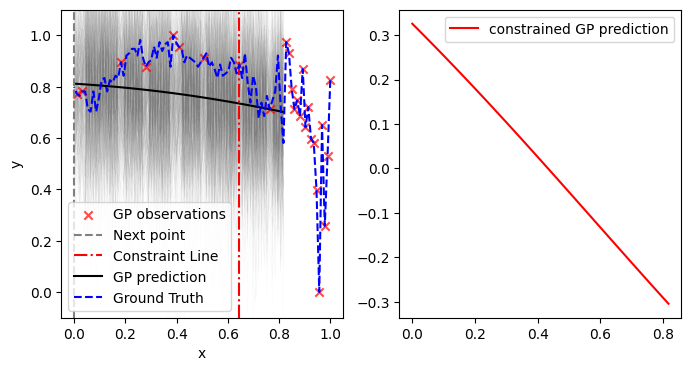

Step:18
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:18<00:00,  2.28it/s, 1023 steps of size 1.56e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.75      4.33      5.32      1.69     13.44     54.76      1.02
    k_scale      0.18      0.13      0.15      0.04      0.33     71.66      1.04
      noise      0.01      0.01      0.01      0.00      0.02     68.30      1.03

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:36<00:00,  2.19it/s, 1023 steps of size 1.17e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.55      4.93      4.97      1.13     12.42     42.68      1.01
    k_scale      0.26      0.16      0.22      0.05      0.48     38.68      1.06
      noise      0.04      0.01      0.04      0.02      0.07     49.97      1.07



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


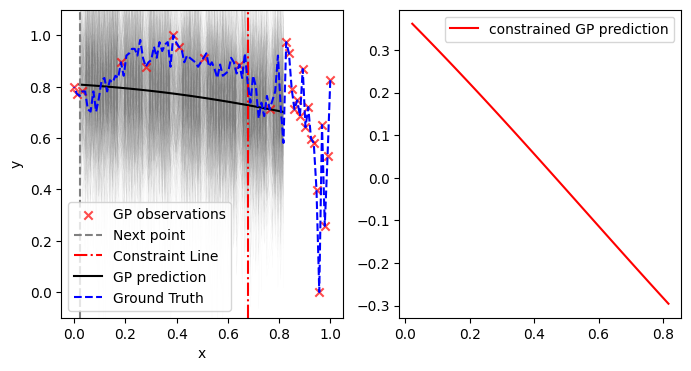

Step:19
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:05<00:00,  2.35it/s, 1023 steps of size 1.43e-03. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.15      4.01      4.79      1.59     12.01     65.12      1.00
    k_scale      0.19      0.14      0.15      0.05      0.35     77.28      1.01
      noise      0.02      0.01      0.01      0.01      0.03     61.80      1.05

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:34<00:00,  2.20it/s, 1023 steps of size 1.23e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.65      4.98      5.07      1.16     12.49     41.41      1.01
    k_scale      0.26      0.16      0.22      0.04      0.47     38.10      1.05
      noise      0.04      0.01      0.04      0.02      0.06     52.66      1.07



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


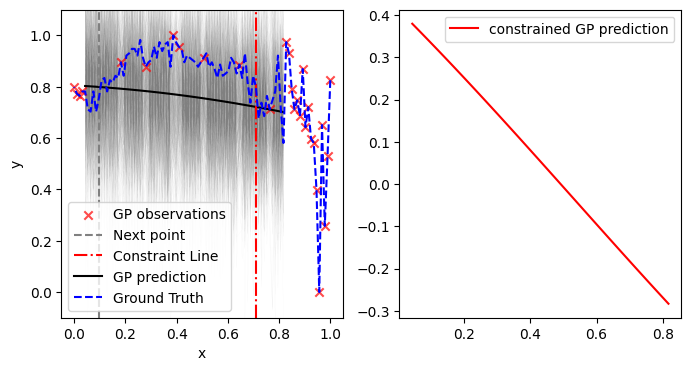

Step:20
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:54<00:00,  2.41it/s, 1023 steps of size 1.65e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.58      4.86      4.92      1.54     13.46     62.08      1.01
    k_scale      0.21      0.16      0.17      0.06      0.39     59.37      1.02
      noise      0.02      0.01      0.02      0.01      0.03     75.43      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:36<00:00,  2.19it/s, 1023 steps of size 1.19e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      6.89      5.10      5.27      1.22     12.80     39.47      1.02
    k_scale      0.25      0.15      0.21      0.06      0.48     35.76      1.06
      noise      0.04      0.01      0.04      0.02      0.06     53.69      1.06



<ipython-input-19-e62fe0dcedf5>:111: RuntimeWarning: invalid value encountered in divide
  c = (c-np.min(c))/(np.max(c)-np.min(c))


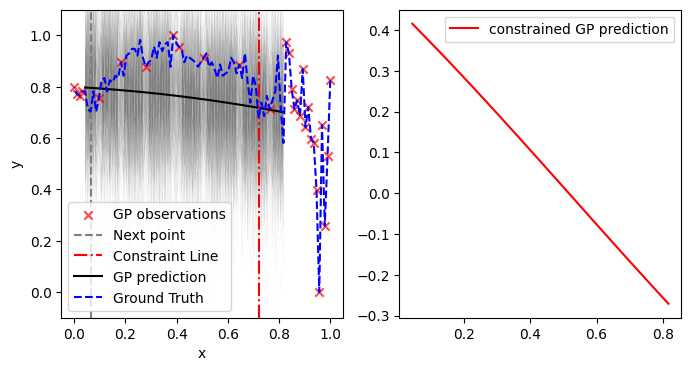

Step:21
Checking for ROI with potntial local optima
[ 0 13 18 29]
New potential region of interest found with prob= 1
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:58<00:00,  2.39it/s, 1023 steps of size 1.68e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.98      3.96      4.63      1.59     11.89     68.22      1.01
    k_scale      0.20      0.15      0.16      0.05      0.38     69.20      1.02
      noise      0.02      0.01      0.02      0.01      0.03     86.16      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:40<00:00,  2.17it/s, 1023 steps of size 1.28e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.05      5.18      5.36      1.16     12.95     37.23      1.01
    k_scale      0.25      0.15      0.21      0.05      0.47     32.48      1.05
      noise      0.04      0.01      0.03      0.02      0.05     58.71      1.06



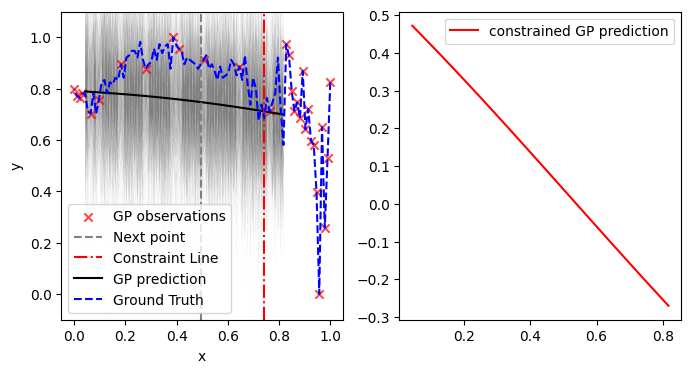

Step:22
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [07:09<00:00,  2.33it/s, 1023 steps of size 1.98e-03. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.66      4.21      4.40      1.09     10.86     86.08      1.00
    k_scale      0.21      0.14      0.17      0.06      0.38     76.97      1.01
      noise      0.02      0.01      0.02      0.01      0.03     90.04      1.02

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:53<00:00,  2.11it/s, 1023 steps of size 1.20e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.23      5.28      5.50      1.30     13.71     38.31      1.02
    k_scale      0.25      0.15      0.21      0.05      0.46     32.43      1.06
      noise      0.03      0.01      0.03      0.02      0.05     49.20      1.07



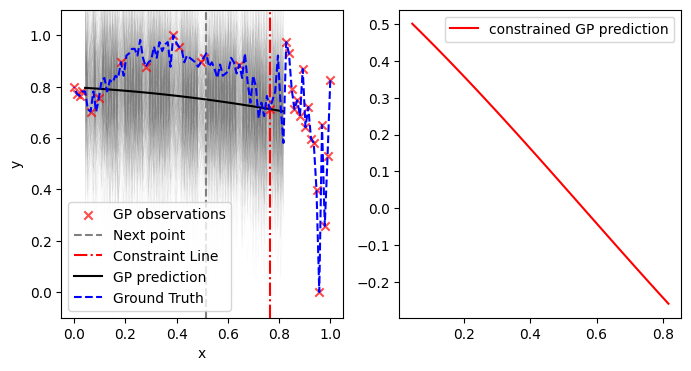

Step:23
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [06:46<00:00,  2.46it/s, 1023 steps of size 1.86e-03. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      5.73      4.03      4.39      1.45     11.51     68.76      1.00
    k_scale      0.21      0.15      0.17      0.06      0.38     56.44      1.01
      noise      0.02      0.01      0.02      0.01      0.03     89.61      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [07:15<00:00,  2.29it/s, 1023 steps of size 1.10e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      7.69      5.81      5.80      1.34     14.66     30.70      1.00
    k_scale      0.25      0.16      0.21      0.04      0.46     31.63      1.03
      noise      0.03      0.01      0.03      0.02      0.05     40.26      1.08



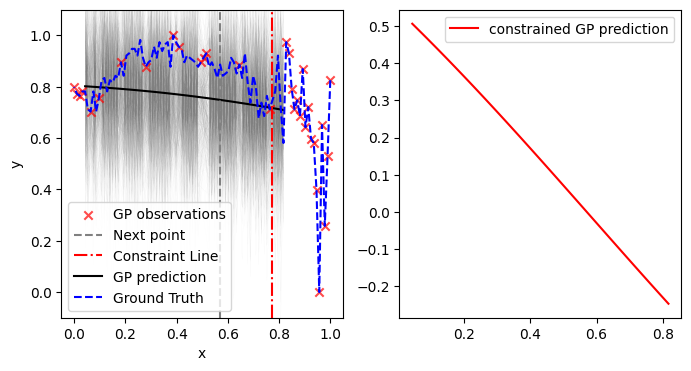

Step:24
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 126.56it/s, 7 steps of size 5.67e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.70      0.33      0.62      0.30      1.12    293.35      1.00
    k_scale      0.85      0.83      0.62      0.14      1.65    298.84      1.00
      noise      0.02      0.01      0.02      0.01      0.03    267.14      1.01

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 129.64it/s, 7 steps of size 6.86e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.28      0.81      1.15      0.39      1.96    290.44      1.00
    k_scale      1.04      0.94      0.78      0.15      2.12    281.39      1.00
      noise      0.04      0.01      0.03      0.02      0.05    289.88      1.00



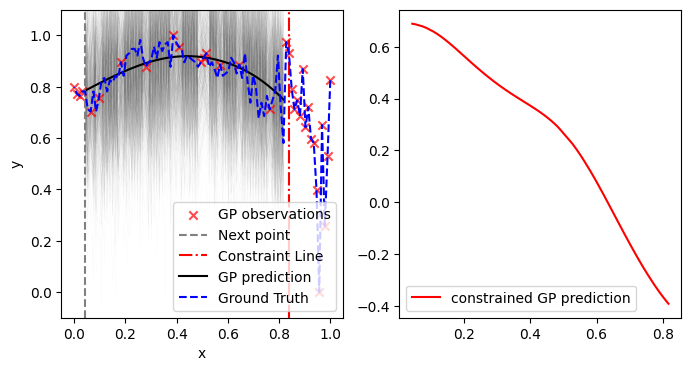

Step:25
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 123.41it/s, 3 steps of size 6.85e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.72      0.39      0.63      0.29      1.15    207.65      1.01
    k_scale      0.90      0.87      0.65      0.10      1.85    241.39      1.00
      noise      0.02      0.01      0.02      0.01      0.03    288.24      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 124.04it/s, 7 steps of size 6.79e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.26      0.81      1.12      0.40      1.88    208.44      1.00
    k_scale      1.05      1.00      0.76      0.15      2.10    354.52      1.00
      noise      0.03      0.01      0.03      0.02      0.05    293.42      1.00



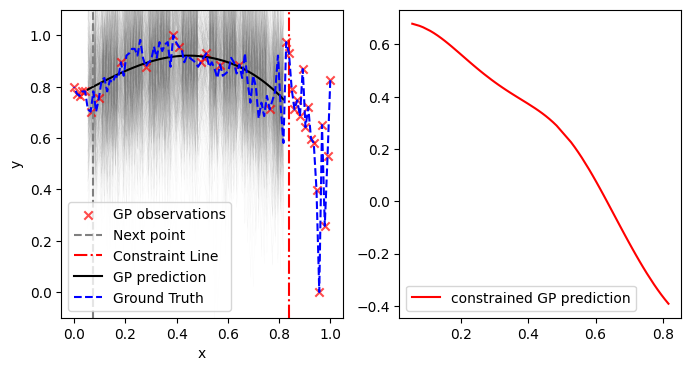

Step:26
Checking for ROI with potntial local optima
[ 0 13 18 29 32]
New potential region of interest found with prob= 0.61891355437311
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 125.91it/s, 7 steps of size 5.72e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.65      0.31      0.58      0.28      1.04    329.26      1.00
    k_scale      0.89      0.82      0.63      0.11      1.74    253.70      1.00
      noise      0.02      0.01      0.02      0.01      0.03    294.69      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 128.83it/s, 7 steps of size 6.65e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.28      0.70      1.14      0.41      1.93    287.97      1.00
    k_scale      1.09      0.99      0.81      0.10      2.16    339.23      1.00
      noise      0.03      0.01      0.03      0.02      0.05    259.25      1.00



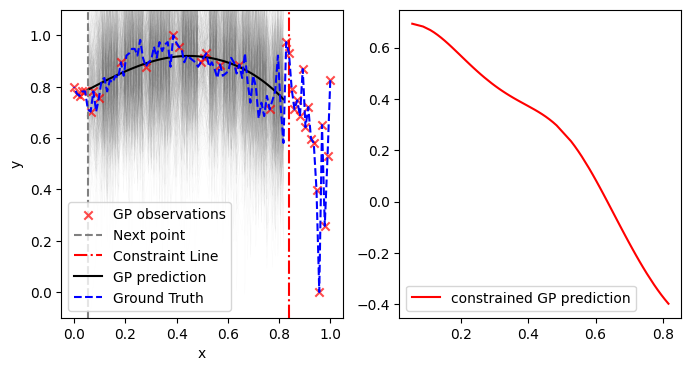

Step:27
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 126.16it/s, 7 steps of size 5.96e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.66      0.32      0.58      0.29      1.08    260.51      1.00
    k_scale      0.84      0.70      0.63      0.13      1.75    280.12      1.00
      noise      0.02      0.01      0.02      0.01      0.03    265.83      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 116.20it/s, 7 steps of size 7.12e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.22      0.60      1.14      0.52      1.86    233.17      1.00
    k_scale      1.09      1.03      0.79      0.14      2.25    330.58      1.00
      noise      0.03      0.01      0.03      0.02      0.05    275.74      1.00



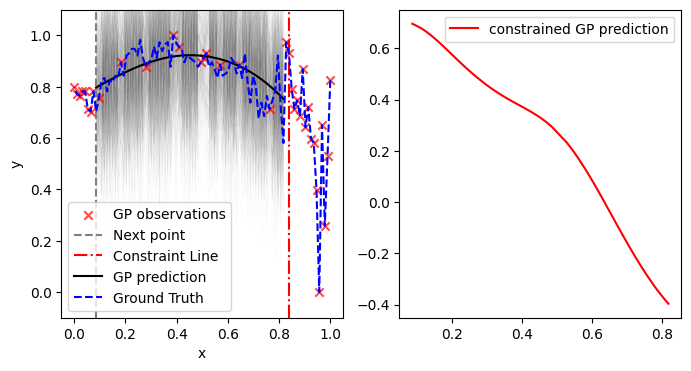

Step:28
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 122.13it/s, 7 steps of size 5.83e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.62      0.30      0.55      0.25      1.01    208.34      1.00
    k_scale      0.84      0.81      0.59      0.11      1.65    308.84      1.00
      noise      0.02      0.01      0.02      0.01      0.03    302.62      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 130.28it/s, 3 steps of size 6.70e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.14      0.58      1.07      0.50      1.75    537.23      1.00
    k_scale      1.02      1.10      0.73      0.12      1.90    365.81      1.00
      noise      0.03      0.01      0.03      0.02      0.04    277.05      1.00



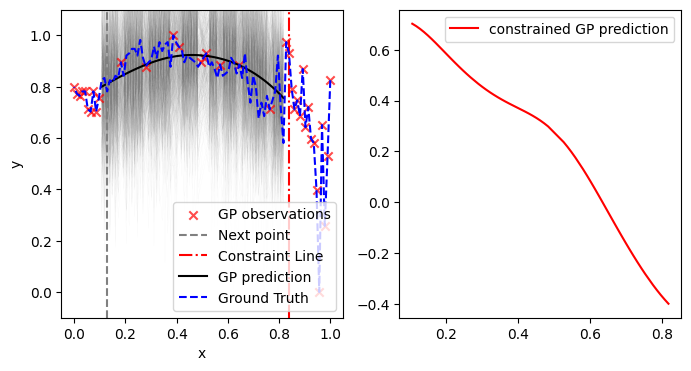

Step:29
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 125.18it/s, 7 steps of size 5.59e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.59      0.31      0.51      0.20      0.95    307.68      1.00
    k_scale      0.75      0.66      0.56      0.11      1.44    281.18      1.00
      noise      0.02      0.01      0.02      0.01      0.03    285.69      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 135.69it/s, 7 steps of size 7.67e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.18      0.53      1.12      0.39      1.77    334.90      1.00
    k_scale      1.06      1.09      0.77      0.15      2.10    288.29      1.00
      noise      0.03      0.01      0.03      0.02      0.05    243.73      1.01



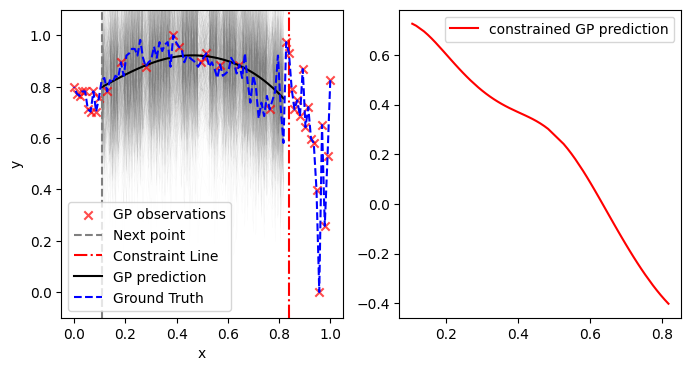

Step:30
Running GP for constraint evaluation


sample: 100%|██████████| 1000/1000 [00:08<00:00, 121.04it/s, 7 steps of size 5.49e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.56      0.29      0.49      0.23      0.94    287.58      1.00
    k_scale      0.77      0.72      0.57      0.12      1.51    315.77      1.00
      noise      0.02      0.01      0.02      0.01      0.02    299.57      1.00

Running GP for function evaluation


sample: 100%|██████████| 1000/1000 [00:07<00:00, 130.11it/s, 7 steps of size 6.31e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.16      0.67      1.07      0.41      1.76    359.02      1.00
    k_scale      1.03      1.00      0.75      0.07      2.03    301.84      1.00
      noise      0.03      0.01      0.03      0.02      0.04    348.95      1.00



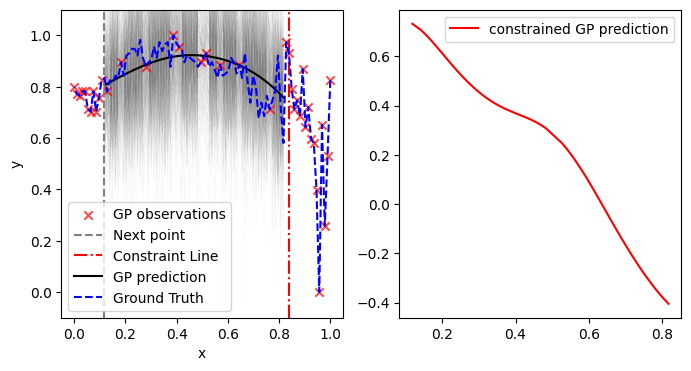

In [ ]:
N = 30
n = 5 # Check for best results
m = 0
X_test_norm = X_test
# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
y_train_inv = -y_train
best_x = X_train[np.argmax(y_train_inv)]
exp_x = [int(np.argmax(y_train_inv))]
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))
    # Checking criteria wheather we find a potential region of interest to exploit-- can be a local or global optima
    if m == n:
        best_x = X_train[exp_x[-1]]
        y_train_inv = -y_train
        m = 0

        if np.isin(exp_x, int(np.argmax(y_train_inv))).any()== True: #New potential region of interest found with low function values

            y_train_norm = (y_train_inv-np.min(y_train_inv))/(np.max(y_train_inv)-np.min(y_train_inv))
            best_y_norm = np.max(y_train_norm)
            # Need to provide normalized value of X and Y
            print("Checking for ROI with potntial local optima")
            exp_x = check_ROI(X_train, y_train_norm, best_x, best_y_norm, exp_x)
            best_x = X_train[exp_x[-1]]
        else:
            exp_x = np.hstack((exp_x, int(np.argmax(y_train_inv)))) #New potential ROI found with higher function values
            best_x = X_train[exp_x[-1]]
            print("New ROI with potential global optima found")

    m = m + 1

    # Execute contraint GP
    print("Running GP for constraint evaluation")
    cGP, constraint_mean, _= run_constrainGP(X_train, y_vote, X_test)
    c_val = np.min(np.absolute(constraint_mean))
    c_idx = np.argmin(np.absolute(constraint_mean))

    # Execute GP
    print("Running GP for function evaluation")
    test_data = [X_test, X_test_norm]
    cost_params = [best_x, exp_x, c_loc, c_glo, int(k[i-1])]
    gpbo, obj, posterior_mean, f_samples = run_statGP(X_train, y_train, test_data, constraint = constraint_mean, pen=1, cost_params= cost_params)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].set_xlabel("x")
    ax[0].set_ylabel("y")
    ax[0].scatter(X_train, y_train, marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax[0].axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    ax[0].axvline(X[c_idx], linestyle = "-.", c = "r", label="Constraint Line")
    for y1 in f_samples:
      ax[0].plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax[0].plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax[0].plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax[0].plot(X, y, c='blue', linestyle='--', label='Ground Truth')
    ax[0].legend();
    l.set_alpha(0)
    ax[0].set_ylim(-0.1, 1.1)

    ax[1].plot(X_test, constraint_mean, c='r', label='constrained GP prediction')
    ax[1].legend();
    plt.show()
    #------------------------------------------#
    # Update Train and Test datasets
    (X_train, X_test, y_train, y_test,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_test, indices_train, indices_test)


    # Update distance metric for new X
    for j1 in range(0, len(idx_good)):
      y_good = y_good + np.absolute(X_train[-1] -  X[idx_good[j1]])
    y_good = y_good/len(idx_good)


    for j2 in range(0, len(idx_bad)):
      y_bad = y_bad + np.absolute(X_train[-1] -  X[idx_bad[j2]])
    y_bad = y_bad/len(idx_bad)

    y_vote = np.hstack((y_vote, (y_bad - y_good))) # Maximizing the target constraint

